In [2]:
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import numpy as np
from pyuvdata import UVCal, UVData
import os
import sys
import glob
import uvtools as uvt
from astropy.time import Time
from astropy.coordinates import EarthLocation, AltAz, Angle
from astropy.coordinates import SkyCoord as sc
import pandas
import warnings 
import copy
from hera_notebook_templates import utils
import hera_qm
from hera_mc import cm_hookup
import h5py
import importlib
from scipy import stats
from IPython.display import display, HTML
from scipy.signal import find_peaks
#warnings.filterwarnings('ignore')

from scipy import signal
from numpy.fft import ifft
from numpy.random import default_rng

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
display(HTML("<style>.container { width:100% !important; }</style>"))

could not import sklearn


In [3]:
#get data location
JD1 = 2459513
data_path1 = '/lustre/aoc/projects/hera/dstorer/H5C_data/2459513'
ant_metrics_ext = ".known_good.ant_metrics.hdf5"
statuses = 'RF_ok,digital_ok,digital_maintenance,calibration_ok,RF_maintenance'
utc = Time(JD1, format='jd').datetime
print(f'JD = {JD1}')
print(f'Date = {utc.month}-{utc.day}-{utc.year}')
print(f'data_path = "{data_path1}"')

JD = 2459513
Date = 10-25-2021
data_path = "/lustre/aoc/projects/hera/dstorer/H5C_data/2459513"


In [5]:
#get data location
JD2 = 2459144
data_path2 = '/lustre/aoc/projects/hera/lberkhou/2459144'
ant_metrics_ext = ".known_good.ant_metrics.hdf5"
statuses = 'RF_ok,digital_ok,digital_maintenance,calibration_ok,RF_maintenance'
utc = Time(JD2, format='jd').datetime
print(f'JD = {JD2}')
print(f'Date = {utc.month}-{utc.day}-{utc.year}')
print(f'data_path = "{data_path2}"')

JD = 2459144
Date = 10-21-2020
data_path = "/lustre/aoc/projects/hera/lberkhou/2459144"


In [6]:
#get data location
JD3 = 2459550
data_path3 = '/lustre/aoc/projects/hera/dstorer/H5C_data/2459550'
ant_metrics_ext = ".known_good.ant_metrics.hdf5"
statuses = 'RF_ok,digital_ok,digital_maintenance,calibration_ok,RF_maintenance'
utc = Time(JD3, format='jd').datetime
print(f'JD = {JD3}')
print(f'Date = {utc.month}-{utc.day}-{utc.year}')
print(f'data_path = "{data_path3}"')

JD = 2459550
Date = 12-1-2021
data_path = "/lustre/aoc/projects/hera/dstorer/H5C_data/2459550"


In [97]:
def plot_same_fig (ant1):
    
    data1 = uvd1.get_data(ant1,ant1,'XX')
    data2 = uvd2.get_data(ant1,ant1,'XX')
    data3 = uvd3.get_data(ant1,ant1,'XX')
    freq = uvd1.freq_array[0]*1e-6 #converted to MegaHz
    
    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    data3_avg = np.average(data3, axis=0)
    data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
    data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
    data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
    
    fig = plt.figure(figsize = (15,15))
    ax1 = plt.subplot(211)
    ax2 = ax1.twinx()
    ax3 = plt.subplot(212)
    ax4 = ax3.twinx()
    p1 = ax1.plot(freq[0:768], data1_avg[0:768]/10, label = (f'JD {JD1}/10'))
    p2 = ax1.plot(freq[0:768], data2_avg[0:768], label = (f'JD {JD2}'))
    p3 = ax2.plot(freq[0:768], data3_avg[0:768], label = (f'JD {JD3}'), color = 'green')
    ax1.set_ylabel(f'JD {JD1} & {JD2}')
    ax2.set_ylabel(f'JD {JD3}')
    ax1.set_title(f'XX Polarization of {ant1}')
    ax1.set_xlabel(f'Frequency (MHz)')
    XP = p1 + p2 + p3
    labs1 = [p.get_label() for p in XP]
    ax1.legend(XP, labs1, loc=0)
    
    ax1min, ax1max = ax1.get_ylim()
    
#     lines = np.arange(0,num,1)
#     number = 0
#     for i in lines:
#         ax1.vlines(start+space*number, ymin = 0, ymax = ax1max, color = 'k', ls = '--')
#         number = (number + 1)
    
    data4 = uvd1.get_data(ant1,ant1,'YY')
    data5 = uvd2.get_data(ant1,ant1,'YY')
    data6 = uvd3.get_data(ant1,ant1,'YY')

    data4_avg = np.average(data4, axis=0)
    data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
    data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
    data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
    data5_avg = np.average(data5, axis=0)
    data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
    data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
    data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
    data6_avg = np.average(data6, axis=0)
    data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
    data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
    data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
   
    p4 = ax3.plot(freq[0:768], data4_avg[0:768]/10, label = (f'JD {JD1}/10'))
    p5 = ax3.plot(freq[0:768], data5_avg[0:768], label = (f'JD {JD2}'))
    p6 = ax4.plot(freq[0:768], data6_avg[0:768], label = (f'JD {JD3}'), color = 'green')
    ax3.set_ylabel(f'JD {JD1} & {JD2}')
    ax4.set_ylabel(f'JD {JD3}')
    ax3.set_title(f'YY Polarization of {ant1}')
    ax3.set_xlabel(f'Frequency (MHz)')
    YP = p4 + p5 + p6
    labs2 = [p.get_label() for p in YP]
    ax3.legend(YP, labs2, loc=0)
    
    ax3min, ax3max = ax3.get_ylim()
    
#     lines = np.arange(0,num,1)
#     number = 0
#     for i in lines:
#         ax3.vlines(start+space*number, ymin = 0, ymax = ax3max, color = 'k', ls = '--')
#         number = (number + 1)
        

In [98]:
def plot_same_fig_full (ant1):
    
    data1 = uvd1.get_data(ant1,ant1,'XX')
    data2 = uvd2.get_data(ant1,ant1,'XX')
    data3 = uvd3.get_data(ant1,ant1,'XX')
    freq = uvd1.freq_array[0]*1e-6 #converted to MegaHz
    
    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    data3_avg = np.average(data3, axis=0)
    data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
    data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
    data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
    
    fig = plt.figure(figsize = (15,15))
    ax1 = plt.subplot(211)
    ax2 = ax1.twinx()
    ax3 = plt.subplot(212)
    ax4 = ax3.twinx()
    p1 = ax1.plot(freq, data1_avg/10, label = (f'JD {JD1}/10'))
    p2 = ax1.plot(freq, data2_avg, label = (f'JD {JD2}'))
    p3 = ax2.plot(freq, data3_avg, label = (f'JD {JD3}'), color = 'green')
    ax1.set_ylabel(f'JD {JD1} & {JD2}')
    ax2.set_ylabel(f'JD {JD3}')
    ax1.set_title(f'XX Polarization of {ant1}')
    ax1.set_xlabel(f'Frequency (MHz)')
    XP = p1 + p2 + p3
    labs1 = [p.get_label() for p in XP]
    ax1.legend(XP, labs1, loc=0)
    
    ax1min, ax1max = ax1.get_ylim()
    
#     lines = np.arange(0,num,1)
#     number = 0
#     for i in lines:
#         ax1.vlines(start+space*number, ymin = 0, ymax = ax1max, color = 'k', ls = '--')
#         number = (number + 1)
    
    data4 = uvd1.get_data(ant1,ant1,'YY')
    data5 = uvd2.get_data(ant1,ant1,'YY')
    data6 = uvd3.get_data(ant1,ant1,'YY')

    data4_avg = np.average(data4, axis=0)
    data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
    data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
    data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
    data5_avg = np.average(data5, axis=0)
    data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
    data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
    data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
    data6_avg = np.average(data6, axis=0)
    data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
    data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
    data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
   
    p4 = ax3.plot(freq, data4_avg/10, label = (f'JD {JD1}/10'))
    p5 = ax3.plot(freq, data5_avg, label = (f'JD {JD2}'))
    p6 = ax4.plot(freq, data6_avg, label = (f'JD {JD3}'), color = 'green')
    ax3.set_ylabel(f'JD {JD1} & {JD2}')
    ax4.set_ylabel(f'JD {JD3}')
    ax3.set_title(f'YY Polarization of {ant1}')
    ax3.set_xlabel(f'Frequency (MHz)')
    YP = p4 + p5 + p6
    labs2 = [p.get_label() for p in YP]
    ax3.legend(YP, labs2, loc=0)
    
    ax3min, ax3max = ax3.get_ylim()
    
#     lines = np.arange(0,num,1)
#     number = 0
#     for i in lines:
#         ax3.vlines(start+space*number, ymin = 0, ymax = ax3max, color = 'k', ls = '--')
#         number = (number + 1)
        

In [99]:
def plot_same_fig_second_half (ant1):
    
    data1 = uvd1.get_data(ant1,ant1,'XX')
    data2 = uvd2.get_data(ant1,ant1,'XX')
    data3 = uvd3.get_data(ant1,ant1,'XX')
    freq = uvd1.freq_array[0]*1e-6 #converted to MegaHz
    
    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    data3_avg = np.average(data3, axis=0)
    data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
    data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
    data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
    
    fig = plt.figure(figsize = (15,15))
    ax1 = plt.subplot(211)
    ax2 = ax1.twinx()
    ax3 = plt.subplot(212)
    ax4 = ax3.twinx()
    p1 = ax1.plot(freq[768:1536], data1_avg[768:1536]/10, label = (f'JD {JD1}/10'))
    p2 = ax1.plot(freq[768:1536], data2_avg[768:1536], label = (f'JD {JD2}'))
    p3 = ax2.plot(freq[768:1536], data3_avg[768:1536], label = (f'JD {JD3}'), color = 'green')
    ax1.set_ylabel(f'JD {JD1} & {JD2}')
    ax2.set_ylabel(f'JD {JD3}')
    ax1.set_title(f'XX Polarization of {ant1} Second Half')
    ax1.set_xlabel(f'Frequency (MHz)')
    XP = p1 + p2 + p3
    labs1 = [p.get_label() for p in XP]
    ax1.legend(XP, labs1, loc=0)
    
    ax1min, ax1max = ax1.get_ylim()
    
#     lines = np.arange(0,num,1)
#     number = 0
#     for i in lines:
#         ax1.vlines(start+space*number, ymin = 0, ymax = ax1max, color = 'k', ls = '--')
#         number = (number + 1)
    
    data4 = uvd1.get_data(ant1,ant1,'YY')
    data5 = uvd2.get_data(ant1,ant1,'YY')
    data6 = uvd3.get_data(ant1,ant1,'YY')

    data4_avg = np.average(data4, axis=0)
    data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
    data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
    data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
    data5_avg = np.average(data5, axis=0)
    data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
    data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
    data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
    data6_avg = np.average(data6, axis=0)
    data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
    data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
    data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
   
    p4 = ax3.plot(freq[768:1536], data4_avg[768:1536]/10, label = (f'JD {JD1}/10'))
    p5 = ax3.plot(freq[768:1536], data5_avg[768:1536], label = (f'JD {JD2}'))
    p6 = ax4.plot(freq[768:1536], data6_avg[768:1536], label = (f'JD {JD3}'), color = 'green')
    ax3.set_ylabel(f'JD {JD1} & {JD2}')
    ax4.set_ylabel(f'JD {JD3}')
    ax3.set_title(f'YY Polarization of {ant1} Second Half')
    ax3.set_xlabel(f'Frequency (MHz)')
    YP = p4 + p5 + p6
    labs2 = [p.get_label() for p in YP]
    ax3.legend(YP, labs2, loc=0)
    
    ax3min, ax3max = ax3.get_ylim()
    
#     lines = np.arange(0,num,1)
#     number = 0
#     for i in lines:
#         ax3.vlines(start+space*number, ymin = 0, ymax = ax3max, color = 'k', ls = '--')
#         number = (number + 1)
        

In [100]:
nodeDict,antDict, _ = generate_nodeDict_allPols(uvd1)
def save_plt(ant1):
    plot_same_fig(ant1)
    node = antDict[ant1]['node']
    img_name = (f'antenna_{ant1}_plots')
    plt.savefig(f'/lustre/aoc/projects/hera/czamora/my_working/plots/{node}/{img_name}.jpeg')

In [164]:
def plot_single_ant(ant1, J_D):
#     fig, ax= plt.subplots(1 , 2, figsize = (15,15))
    
    #ax = axes[0, 0]
    
    
    
    data1 = uvd1.get_data(ant1,ant1,'XX')
    data2 = uvd2.get_data(ant1,ant1,'XX')
    data3 = uvd3.get_data(ant1,ant1,'XX')
    data4 = uvd1.get_data(ant1,ant1,'YY')
    data5 = uvd2.get_data(ant1,ant1,'YY')
    data6 = uvd3.get_data(ant1,ant1,'YY')
    freq = uvd1.freq_array[0]*1e-6 #converted to MegaHz

    if J_D == 1:
        fig, ax= plt.subplots(2 , 1, figsize = (15,20))
        data1_avg = np.average(data1, axis=0)
        data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
        data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
        data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
        #peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
        #print(peaks1)
        ax[0].plot(freq[0:768],data1_avg[0:768]/10, label = f'XX JD {JD1}')
        axmin1, axmax1 = ax[0].get_ylim()
        #ax[0,0].plot(freq[peaks1],data1_avg[peaks1],"xr")

        data4_avg = np.average(data4, axis=0)
        data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
        data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
        data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
        ax[1].plot(freq[0:768],data4_avg[0:768]/10, label = f'YY JD {JD1}')
        axmin2, axmax2 = ax[1].get_ylim()
        
        ax[0].vlines(82, ymin = 0, ymax = axmax1, color = 'k', ls = '--')
        ax[0].vlines(102.025, ymin = 0, ymax = axmax1, color = 'k', ls = '--')
        ax[0].vlines(122.05, ymin = 0, ymax = axmax1, color = 'k', ls = '--')
        ax[1].vlines(82, ymin = 0, ymax = axmax2, color = 'k', ls = '--')
        ax[1].vlines(102.025, ymin = 0, ymax = axmax2, color = 'k', ls = '--')
        ax[1].vlines(122.05, ymin = 0, ymax = axmax2, color = 'k', ls = '--')
        
        
        ax[0].set_yscale('log')
        ax[0].legend()
        ax[0].set_xlabel(f'Frequency (MHz)')
        ax[0].set_title(f'XX Polarization of {ant1}')
        ax[1].set_yscale('log')
        ax[1].legend()
        ax[1].set_xlabel(f'Frequency (MHz)')
        ax[1].set_title(f'YY Polarization of {ant1}')
        
    elif J_D == 2:
        fig, ax= plt.subplots(2 , 1, figsize = (15,20))
        data2_avg = np.average(data2, axis=0)
        data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
        data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
        data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
        ax[0].plot(freq[0:768],data2_avg[0:768], label = f'XX JD {JD2}')
        axmin1, axmax1 = ax[0].get_ylim()
        data5_avg = np.average(data5, axis=0)
        data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
        data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
        data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
        ax[1].plot(freq[0:768],data5_avg[0:768], label = f'YY JD {JD2}')
        axmin2, axmax2 = ax[1].get_ylim()
        
        ax[0].vlines(82, ymin = 0, ymax = axmax1, color = 'k', ls = '--')
        ax[0].vlines(102.025, ymin = 0, ymax = axmax1, color = 'k', ls = '--')
        ax[0].vlines(122.05, ymin = 0, ymax = axmax1, color = 'k', ls = '--')
        ax[1].vlines(82, ymin = 0, ymax = axmax2, color = 'k', ls = '--')
        ax[1].vlines(102.025, ymin = 0, ymax = axmax2, color = 'k', ls = '--')
        ax[1].vlines(122.05, ymin = 0, ymax = axmax2, color = 'k', ls = '--')
        
        ax[0].set_yscale('log')
        ax[0].legend()
        ax[0].set_xlabel(f'Frequency (MHz)')
        ax[0].set_title(f'XX Polarization of {ant1}')
        ax[1].set_yscale('log')
        ax[1].legend()
        ax[1].set_xlabel(f'Frequency (MHz)')
        ax[1].set_title(f'YY Polarization of {ant1}')
        
        
    else:
        fig, ax= plt.subplots(2 , 1, figsize = (15,20))
        data3_avg = np.average(data3, axis=0)
        data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
        data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
        data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
        ax[0].plot(freq[0:768],2*data3_avg[0:768]/10**2, label = f'XX JD {JD3}')
        axmin1, axmax1 = ax[0].get_ylim()
        data6_avg = np.average(data6, axis=0)
        data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
        data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
        data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
        ax[1].plot(freq[0:768],data6_avg[0:768]/10**2, label = f'YY JD {JD3}')
        axmin2, axmax2 = ax[1].get_ylim()
        
        ax[0].vlines(82, ymin = 0, ymax = axmax1, color = 'k', ls = '--')
        ax[0].vlines(102.025, ymin = 0, ymax = axmax1, color = 'k', ls = '--')
        ax[0].vlines(122.05, ymin = 0, ymax = axmax1, color = 'k', ls = '--')
        ax[1].vlines(82, ymin = 0, ymax = axmax2, color = 'k', ls = '--')
        ax[1].vlines(102.025, ymin = 0, ymax = axmax2, color = 'k', ls = '--')
        ax[1].vlines(122.05, ymin = 0, ymax = axmax2, color = 'k', ls = '--')
        
        ax[0].set_yscale('log')
        ax[0].legend()
        ax[0].set_xlabel(f'Frequency (MHz)')
        ax[0].set_title(f'XX Polarization of {ant1}')
        ax[1].set_yscale('log')
        ax[1].legend()
        ax[1].set_xlabel(f'Frequency (MHz)')
        ax[1].set_title(f'YY Polarization of {ant1}')
        
   

In [101]:
def plot_four_noclocks_even_single (ant1):
    #print(clocks1)
    # print((-np.average(data1, axis=0)).argsort()[:3])
    fig, ax= plt.subplots(1 , 2, figsize = (15,12))
    
    #ax = axes[0, 0]
    
    data1 = uvd1.get_data(ant1,ant1,'XX')
    data2 = uvd2.get_data(ant1,ant1,'XX')
    data3 = uvd3.get_data(ant1,ant1,'XX')
    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    data3_avg = np.average(data3, axis=0)
    data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
    data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
    data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
   
    #peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    #print(peaks1)
    #peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    ax[0].plot(freq[0:768],data1_avg[0:768]/10, label = f'XX JD {JD1}')
    #ax[0,0].plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax[0].plot(freq[0:768],data2_avg[0:768], label = f'XX JD {JD2}')
    #ax[0,0].plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax[0].plot(freq[0:768],2*data3_avg[0:768]/10**2, label = f'XX JD {JD3}')
    #ax[0,0].plot(freq[peaks3],data3_avg[peaks3],"xr")
    #ax[0].legend()
    
    #fig = plt.figure()
#     ax1 = fig.add_subplot(111)
#     ax1.plot(freq[0:768], data1_avg[0:768]/10)
#     ax1.set_ylabel('y1')
#     ax1.plot(freq[0:768], data2_avg[0:768])

#     ax2 = ax1.twinx()
#     ax2.plot(freq[0:768], data3_avg[0:768], 'r-')
#     ax2.set_ylabel('y2', color='r')
    
#     axmin, axmax = ax[0].get_ylim()
    
#     lines = np.arange(0,num,1)
#     number = 0
        
#     for i in lines:
#         ax[0,0].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
#         number = (number + 1)
        
    ax[0].set_yscale('log')
    ax[0].set_xlabel(f'Frequency (MHz) of antenna {ant1}')

    data4 = uvd1.get_data(ant1,ant1,'YY')
    data5 = uvd2.get_data(ant1,ant1,'YY')
    data6 = uvd3.get_data(ant1,ant1,'YY')

    data4_avg = np.average(data4, axis=0)
    data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
    data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
    data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
    data5_avg = np.average(data5, axis=0)
    data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
    data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
    data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
    data6_avg = np.average(data6, axis=0)
    data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
    data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
    data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
    #peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    #print(peaks1)
    #peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    ax[1].plot(freq[0:768],data4_avg[0:768]/10, label = f'YY JD {JD1}')
    #ax[0,0].plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax[1].plot(freq[0:768],data5_avg[0:768], label = f'YY JD {JD2}')
    #ax[0,0].plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax[1].plot(freq[0:768],data6_avg[0:768]/10**2, label = f'YY JD {JD3}')
    #ax[0,0].plot(freq[peaks3],data3_avg[peaks3],"xr")
    ax[1].legend()
    
    axmin, axmax = ax[1].get_ylim()
    
#     lines = np.arange(0,num,1)
#     number = 0
        
#     for i in lines:
#         ax[0,0].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
#         number = (number + 1)
        
    ax[1].set_yscale('log')
    ax[1].set_xlabel(f'Frequency (MHz) of antenna {ant1}')




In [1]:
def plot_four_noclocks_even (ant1, ant2, ant3, ant4, start, space, num):
    #print(clocks1)
    # print((-np.average(data1, axis=0)).argsort()[:3])
    fig, ax = plt.subplots(2 , 2, figsize = (15,12))
    
    #ax = axes[0, 0]
    
    data1 = uvd3.get_data(ant1,ant1,'XX')
    data2 = uvd3.get_data(ant1,ant1,'YY')
    data3 = uvd3.get_data(ant2,ant2,'XX')
    data4 = uvd3.get_data(ant2,ant2,'YY')
    data5 = uvd3.get_data(ant3,ant3,'XX')
    data6 = uvd3.get_data(ant3,ant3,'YY')
    data7 = uvd3.get_data(ant4,ant4,'XX')
    data8 = uvd3.get_data(ant4,ant4,'YY')
    freq = uvd1.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    peaks1, _ = find_peaks(data1_avg[0:384], distance=40)
    peaks2, _ = find_peaks(data2_avg[0:384], distance=40)
    ax[0,0].plot(freq[0:384],data1_avg[0:384], label = 'XX')
    ax[0,0].plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax[0,0].plot(freq[0:384],data2_avg[0:384], label = 'YY')
    ax[0,0].plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax[0,0].legend()
    
    axmin, axmax = ax[0,0].get_ylim()
    
    lines = np.arange(0,num,1)
    number = 0
        
    for i in lines:
        ax[0,0].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--', alpha = 0.5)
        number = (number + 1)
        
    ax[0,0].set_title(f'Antenna {ant1}')
    ax[0,0].set_yscale('log')
    ax[0,0].set_xlabel(f'Frequency (MHz)')


    data3_avg = np.average(data3, axis=0)
    data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
    data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
    data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
    data4_avg = np.average(data4, axis=0)
    data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
    data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
    data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
    peaks3, _ = find_peaks(data3_avg[0:384], distance=40)
    peaks4, _ = find_peaks(data4_avg[0:384], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[0,1].plot(freq[0:384],data3_avg[0:384], label = 'XX')
    ax[0,1].plot(freq[peaks3],data3_avg[peaks3],"xr")
    ax[0,1].plot(freq[0:384],data4_avg[0:384], label = 'YY')
    ax[0,1].plot(freq[peaks4],data4_avg[peaks4],"xr")
    ax[0,1].legend()
    
    axmin, axmax = ax[0,1].get_ylim()
    number = 0
    
    for i in lines:
        ax[0,1].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--', alpha = 0.5)
        number = (number + 1)

    ax[0,1].set_title(f'Antenna {ant2}')
    ax[0,1].set_yscale('log')
    ax[0,1].set_xlabel(f'Frequency (MHz)')

    data5_avg = np.average(data5, axis=0)
    data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
    data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
    data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
    data6_avg = np.average(data6, axis=0)
    data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
    data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
    data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
    peaks5, _ = find_peaks(data5_avg[0:384], distance=40)
    peaks6, _ = find_peaks(data6_avg[0:384], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[1,0].plot(freq[0:384],data5_avg[0:384], label = 'XX')
    ax[1,0].plot(freq[peaks5],data5_avg[peaks5],"xr")
    ax[1,0].plot(freq[0:384],data6_avg[0:384], label = 'YY')
    ax[1,0].plot(freq[peaks6],data6_avg[peaks6],"xr")
    ax[1,0].legend()
    
    axmin, axmax = ax[1,0].get_ylim()
    number = 0
    
    for i in lines:
        ax[1,0].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--', alpha = 0.5)
        number = (number + 1)

    ax[1,0].set_title(f'Antenna {ant3}')
    ax[1,0].set_yscale('log')
    ax[1,0].set_xlabel(f'Frequency (MHz)')

    data7_avg = np.average(data7, axis=0)
    data7_avg[128] = (data7_avg[127] + data7_avg[129])/2
    data7_avg[1152] = (data7_avg[1151] + data7_avg[1153])/2
    data7_avg[640] = (data7_avg[639] + data7_avg[641])/2
    data8_avg = np.average(data8, axis=0)
    data8_avg[128] = (data8_avg[127] + data8_avg[129])/2
    data8_avg[1152] = (data8_avg[1151] + data8_avg[1153])/2
    data8_avg[640] = (data8_avg[639] + data8_avg[641])/2
    peaks7, _ = find_peaks(data7_avg[0:384], distance=40)
    peaks8, _ = find_peaks(data8_avg[0:384], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[1,1].plot(freq[0:384],data7_avg[0:384], label = 'XX')
    ax[1,1].plot(freq[peaks7],data7_avg[peaks7],"xr")
    ax[1,1].plot(freq[0:384],data8_avg[0:384], label = 'YY')
    ax[1,1].plot(freq[peaks8],data8_avg[peaks8],"xr")
    ax[1,1].legend()
    
    axmin, axmax = ax[1,1].get_ylim()
    number = 0
    
    for i in lines:
        ax[1,1].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--', alpha = 0.5)
        number = (number + 1)

    ax[1,1].set_title(f'Antenna {ant4}')
    ax[1,1].set_yscale('log')
    ax[1,1].set_xlabel(f'Frequency (MHz)')

    print(freq[peaks1[0:11]])
    print(freq[peaks2[0:11]])
    
    print (f'Antenna{ant1} xx and yy')
    print(freq[peaks1[0:15]])
    print(freq[peaks2[0:15]])
    print (f'Antenna{ant2} xx and yy')
    print(freq[peaks3[0:15]])
    print(freq[peaks4[0:15]])
    print (f'Antenna{ant3} xx and yy')
    print(freq[peaks5[0:15]])
    print(freq[peaks6[0:15]])
    print (f'Antenna{ant4} xx and yy')
    print(freq[peaks7[0:15]])
    print(freq[peaks8[0:15]])

In [103]:
def generate_nodeDict_allPols(uv,pol='E'):
    """
    Generates dictionaries containing node and antenna information.
    
    Parameters:
    ----------
    uv: UVData Object
        Sample observation to extract node and antenna information from.
    
    Returns:
    -------
    nodes: Dict
        Dictionary containing entry for all nodes, each of which has keys: 'ants', 'snapLocs', 'snapInput'.
    antDict: Dict
        Dictionary containing entry for all antennas, each of which has keys: 'node', 'snapLocs', 'snapInput'.
    inclNodes: List
        Nodes that have hooked up antennas.
    """
    
    antnums = uv.get_ants()
    h = cm_hookup.Hookup()
    x = h.get_hookup('HH')
    nodes = {}
    antDict = {}
    inclNodes = []
    for ant in antnums:
        key = 'HH%i:A' % (ant)
        n = x[key].get_part_from_type('node')[f'{pol}<ground']
        if n is None:
            continue
        else:
            n = n[1:]
        snapLoc = (x[key].hookup[f'{pol}<ground'][-1].downstream_input_port[-1], ant)
        snapInput = (x[key].hookup[f'{pol}<ground'][-2].downstream_input_port[1:], ant)
        antDict[ant] = {}
        antDict[ant]['node'] = str(n)
        antDict[ant]['snapLocs'] = snapLoc
        antDict[ant]['snapInput'] = snapInput
        inclNodes.append(n)
        if n in nodes:
            nodes[n]['ants'].append(ant)
            nodes[n]['snapLocs'].append(snapLoc)
            nodes[n]['snapInput'].append(snapInput)
        else:
            nodes[n] = {}
            nodes[n]['ants'] = [ant]
            nodes[n]['snapLocs'] = [snapLoc]
            nodes[n]['snapInput'] = [snapInput]
    inclNodes = np.unique(inclNodes)
    return nodes, antDict, inclNodes


In [104]:
 def plot_seperate_pols(ant1):
    fig, ax= plt.subplots(6 , 1, figsize = (15,15))
    
    #ax = axes[0, 0]
    
    data1 = uvd1.get_data(ant1,ant1,'XX')
    data2 = uvd2.get_data(ant1,ant1,'XX')
    data3 = uvd3.get_data(ant1,ant1,'XX')
    freq = uvd1.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    data3_avg = np.average(data3, axis=0)
    data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
    data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
    data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
   
    #peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    #print(peaks1)
    #peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    ax[0].plot(freq[0:768],data1_avg[0:768], label = f'XX JD {JD1}')
    #ax[0,0].plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax[1].plot(freq[0:768],data2_avg[0:768], label = f'XX JD {JD2}', color = 'orange')
    #ax[0,0].plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax[2].plot(freq[0:768],data3_avg[0:768], label = f'XX JD {JD3}', color ='green')
    #ax[0,0].plot(freq[peaks3],data3_avg[peaks3],"xr")
    ax[0].legend()
    ax[1].legend()
    ax[2].legend()

        
    ax[0].set_yscale('log')
    ax[0].set_xlabel(f'Frequency (MHz) of antenna {ant1}')
    ax[1].set_yscale('log')
    ax[1].set_xlabel(f'Frequency (MHz) of antenna {ant1}')
    ax[2].set_yscale('log')
    ax[2].set_xlabel(f'Frequency (MHz) of antenna {ant1}')

    data4 = uvd1.get_data(ant1,ant1,'YY')
    data5 = uvd2.get_data(ant1,ant1,'YY')
    data6 = uvd3.get_data(ant1,ant1,'YY')

    data4_avg = np.average(data4, axis=0)
    data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
    data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
    data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
    data5_avg = np.average(data5, axis=0)
    data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
    data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
    data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
    data6_avg = np.average(data6, axis=0)
    data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
    data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
    data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
    #peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    #print(peaks1)
    #peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    ax[3].plot(freq[0:768],data4_avg[0:768], label = f'YY JD {JD1}')
    #ax[0,0].plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax[4].plot(freq[0:768],data5_avg[0:768], label = f'YY JD {JD2}', color='orange')
    #ax[0,0].plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax[5].plot(freq[0:768],data6_avg[0:768], label = f'YY JD {JD3}', color='green')
    #ax[0,0].plot(freq[peaks3],data3_avg[peaks3],"xr")
    ax[3].legend()
    ax[4].legend()
    ax[5].legend()
    
    axmin, axmax = ax[1].get_ylim()

In [ ]:
# Load in data
HHfiles, difffiles, HHautos, diffautos, uvdx, uvdy = utils.load_data(data_path1,JD1)
    
uvd1 = UVData()
unread = True
readInd=0
while unread and readInd<len(HHautos):
    try:
        uvd1.read(HHautos[readInd])
        unread = False
    except:
        readInd += 1
        continue
use_ants1 = utils.get_use_ants(uvd1,statuses,JD1)
print(f'This day contains {len(use_ants1)} antennas of the given status category.')
uvd1.read(HHautos[::10], skip_bad_files=True, antenna_nums = use_ants1)
lsts1 = uvd1.lst_array
uvdx.select(antenna_nums=use_ants1)
uvdy.select(antenna_nums=use_ants1)

In [9]:
# Load in data
HHfiles, difffiles, HHautos, diffautos, uvdx, uvdy = utils.load_data(data_path2,JD2)
    
uvd2 = UVData()
unread = True
readInd=0
while unread and readInd<len(HHautos):
    try:
        uvd2.read(HHautos[readInd])
        unread = False
    except:
        readInd += 1
        continue
use_ants2 = utils.get_use_ants(uvd2,statuses,JD2)
print(f'This day contains {len(use_ants2)} antennas of the given status category.')
uvd2.read(HHautos[::10], skip_bad_files=True, antenna_nums = use_ants2)
lsts2 = uvd2.lst_array
uvdx.select(antenna_nums=use_ants2)
uvdy.select(antenna_nums=use_ants2)

1862 sum files found between JDs 2459144.25108 and 2459144.66738
1862 diff files found between JDs 2459144.25108 and 2459144.66738
1862 sum auto files found between JDs 2459144.25108 and 2459144.66738
1862 diff auto files found between JDs 2459144.25108 and 2459144.66738
This day contains 71 antennas of the given status category.


In [10]:
# Load in data
HHfiles, difffiles, HHautos, diffautos, uvdx, uvdy = utils.load_data(data_path3,JD3)
    
uvd3 = UVData()
unread = True
readInd=0
while unread and readInd<len(HHautos):
    try:
        uvd3.read(HHautos[readInd])
        unread = False
    except:
        readInd += 1
        continue
use_ants3 = utils.get_use_ants(uvd3,statuses,JD3)
print(f'This day contains {len(use_ants3)} antennas of the given status category.')
uvd3.read(HHautos[::10], skip_bad_files=True, antenna_nums = use_ants3)
lsts3 = uvd3.lst_array
uvdx.select(antenna_nums=use_ants3)
uvdy.select(antenna_nums=use_ants3)

IndexError: list index out of range

In [ ]:
plot_seperate_pols(46)

In [79]:
antDict[138]['node']

'07'

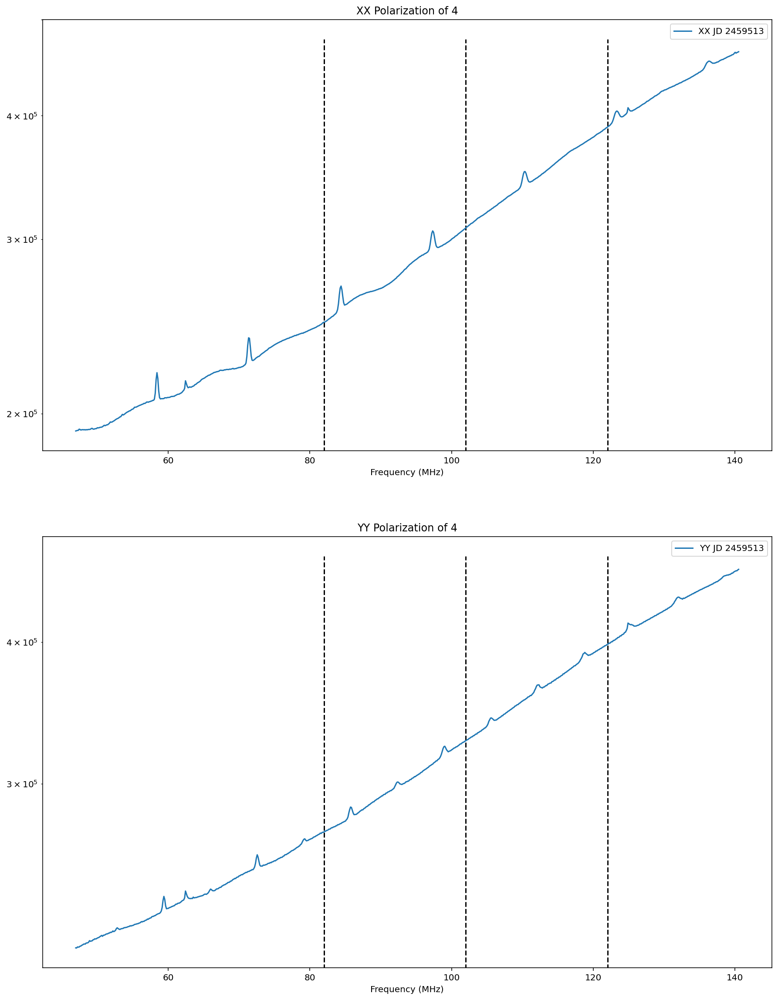

In [163]:
plot_single_ant(4 , 1)

In [ ]:
plot_four_noclocks_even(87,176,120,185, 49.973, 20.025, 3)
node_ant4 = antDict[4]['node']
node_ant138 = antDict[138]['node']
node_ant120 = antDict[120]['node']
node_ant164 = antDict[164]['node']
print (f'Antenna 4 is in node {node_ant4}, antenna 138 is in node {node_ant138}, antenna 120 is in node {node_ant120}, antenna 164 is in node {node_ant164}')

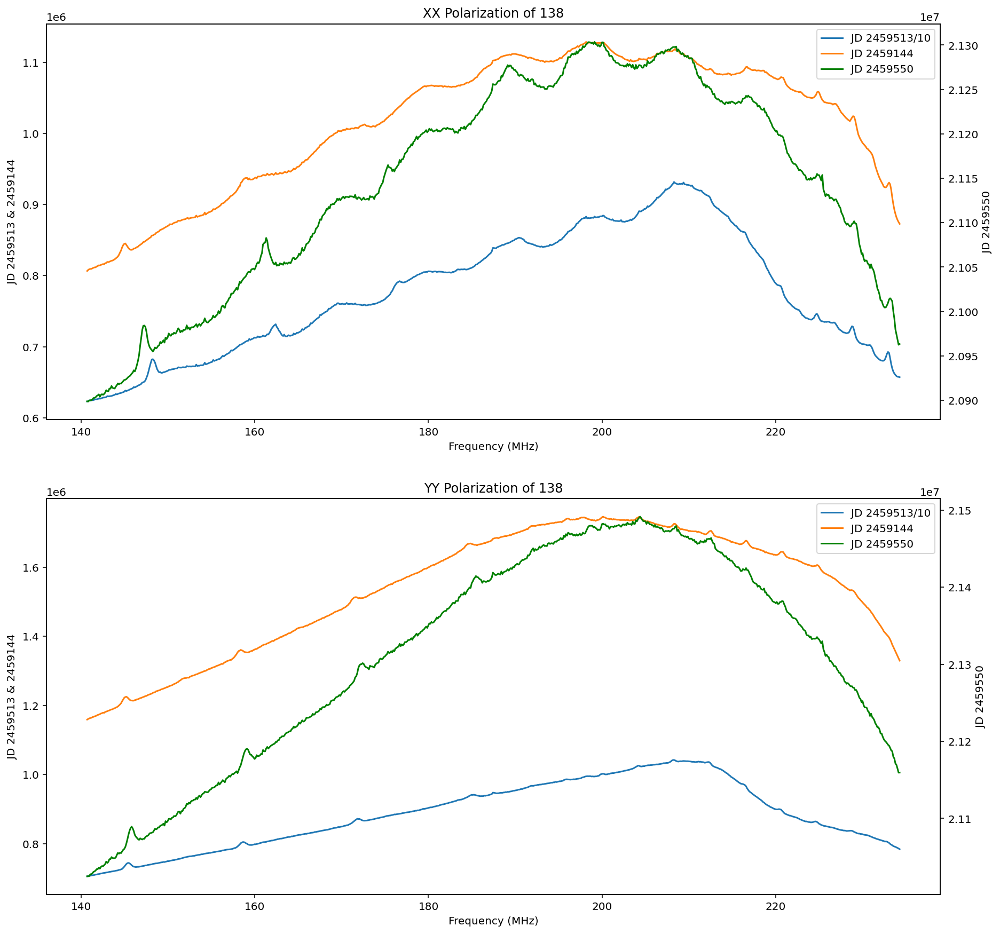

In [86]:
plot_same_fig_second_half(138)

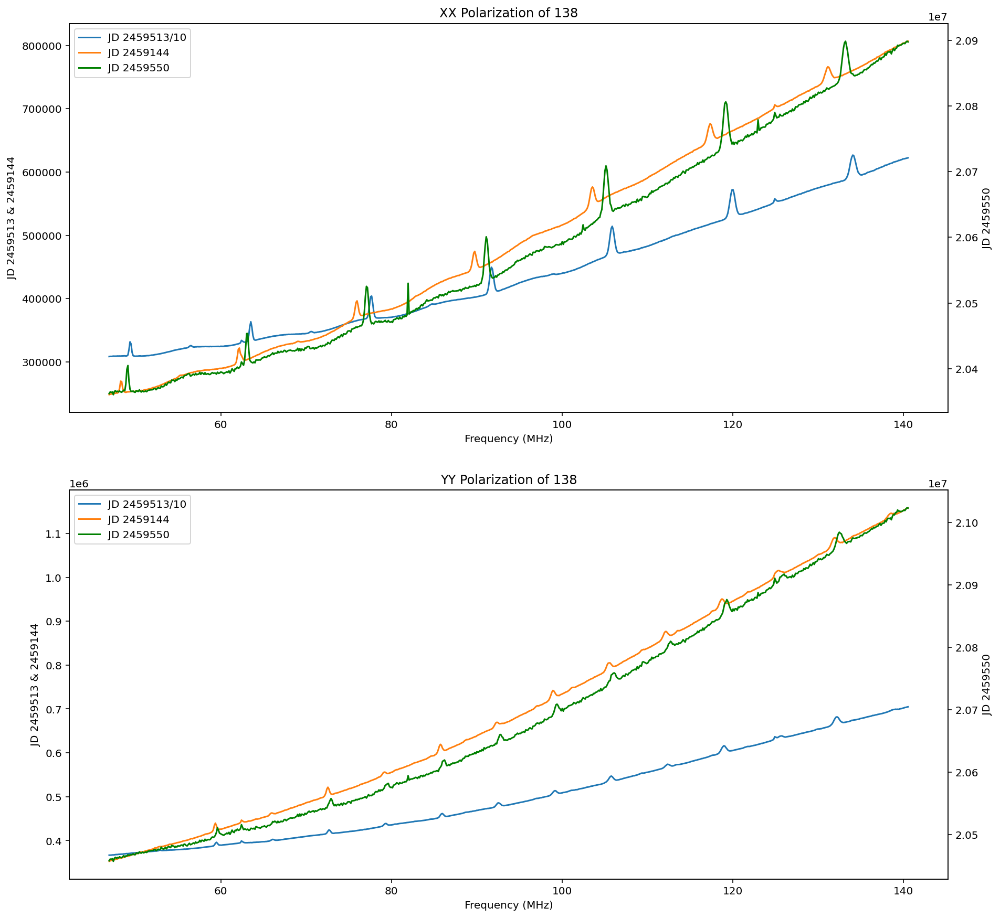

In [128]:
img_1 = (f'antenna_{plot_same_fig(138)}_first_half_plots')
plt.savefig(f'/lustre/aoc/projects/hera/czamora/my_working/plots/138/{img_1}.jpeg')

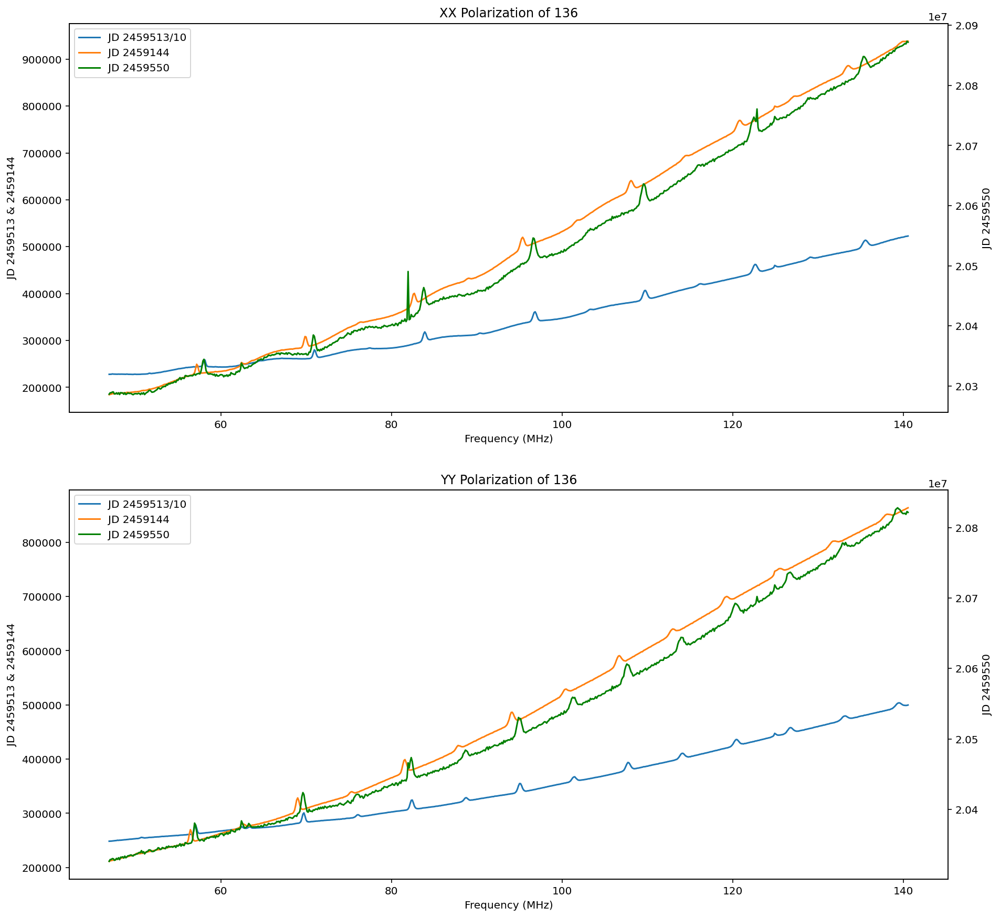

In [129]:
img_2 = (f'antenna_{plot_same_fig(136)}_first_half_plots')
plt.savefig(f'/lustre/aoc/projects/hera/czamora/my_working/plots/136/{img_2}.jpeg')

## Node 00

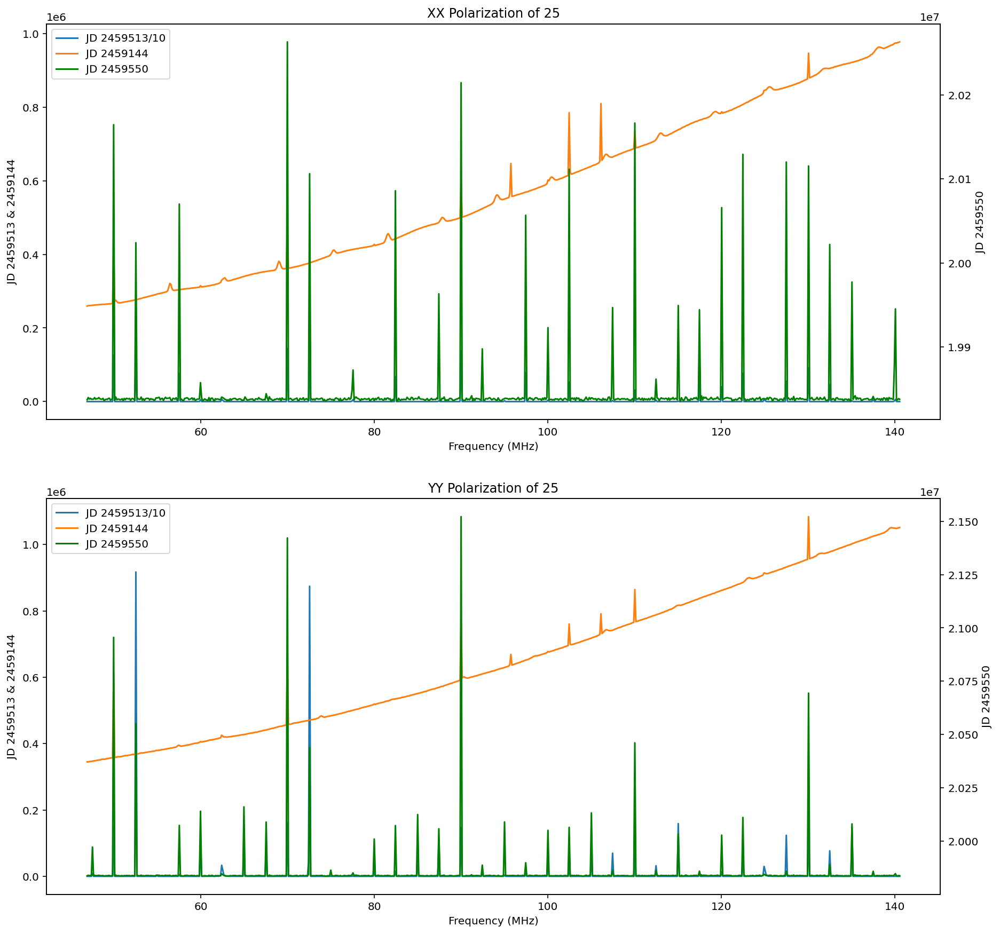

In [130]:
save_plt(25)

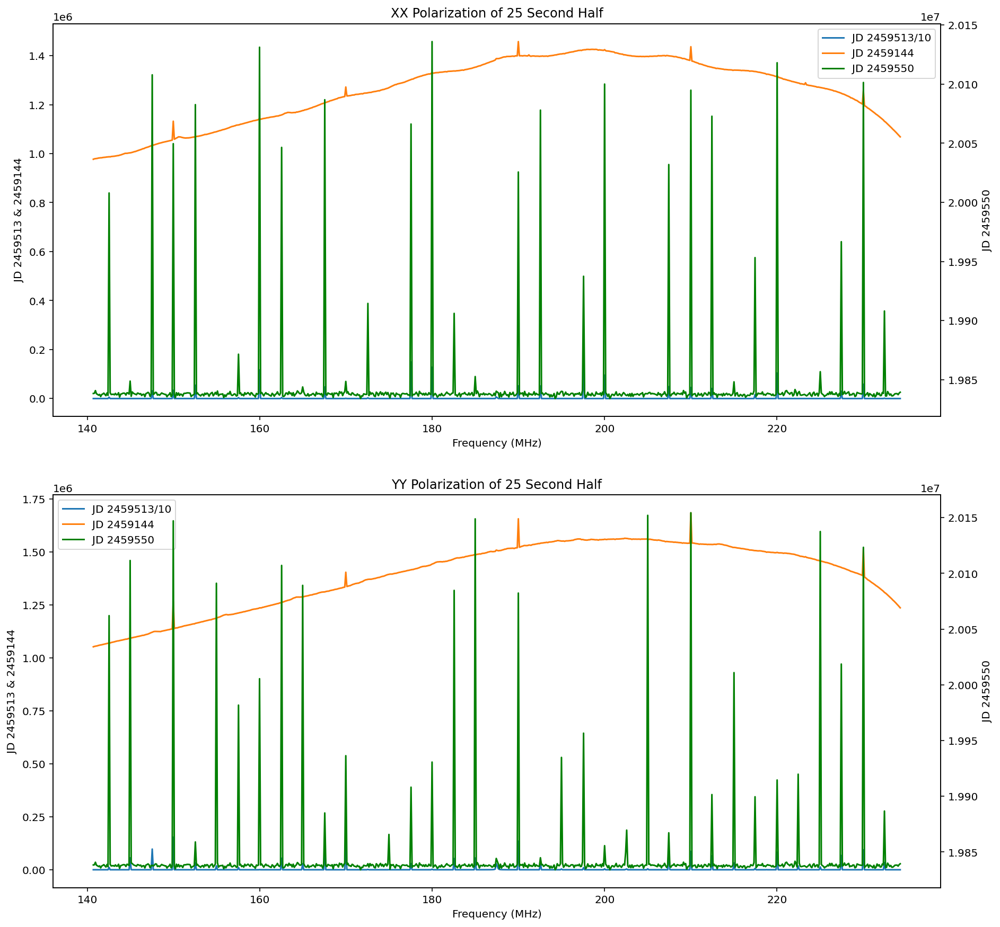

In [120]:
plot_same_fig_second_half(25)

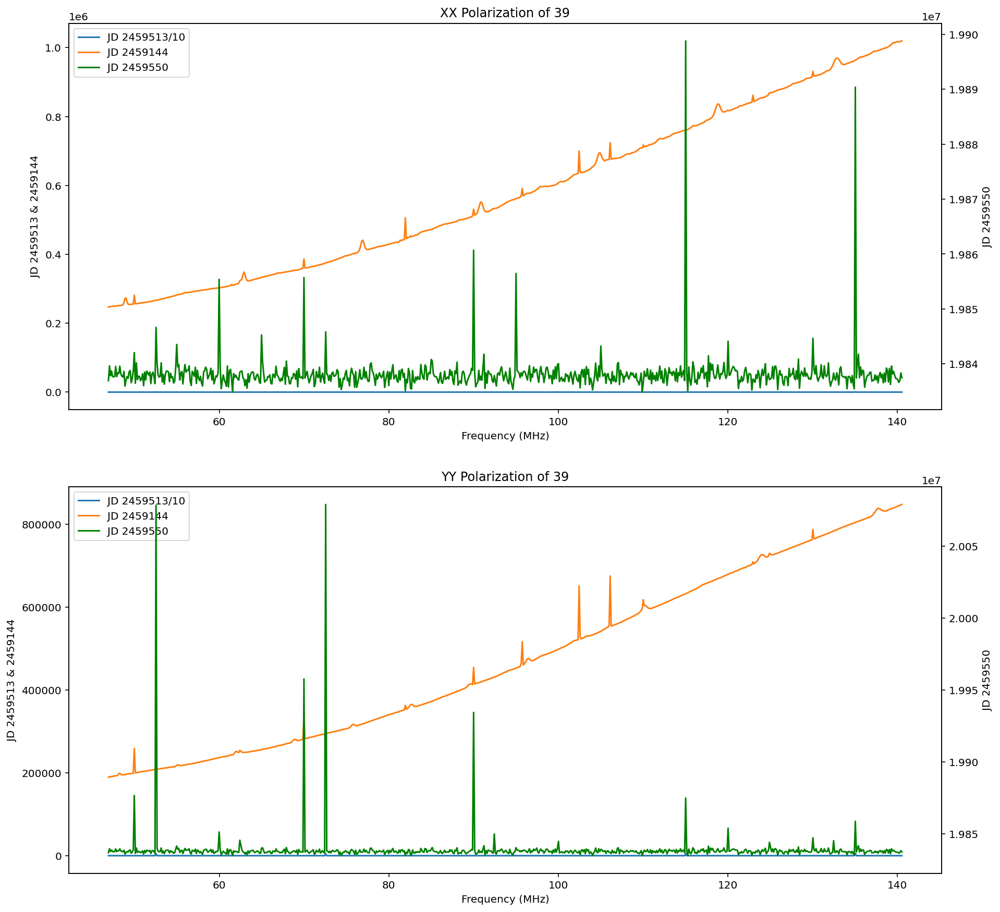

In [131]:
save_plt(39)

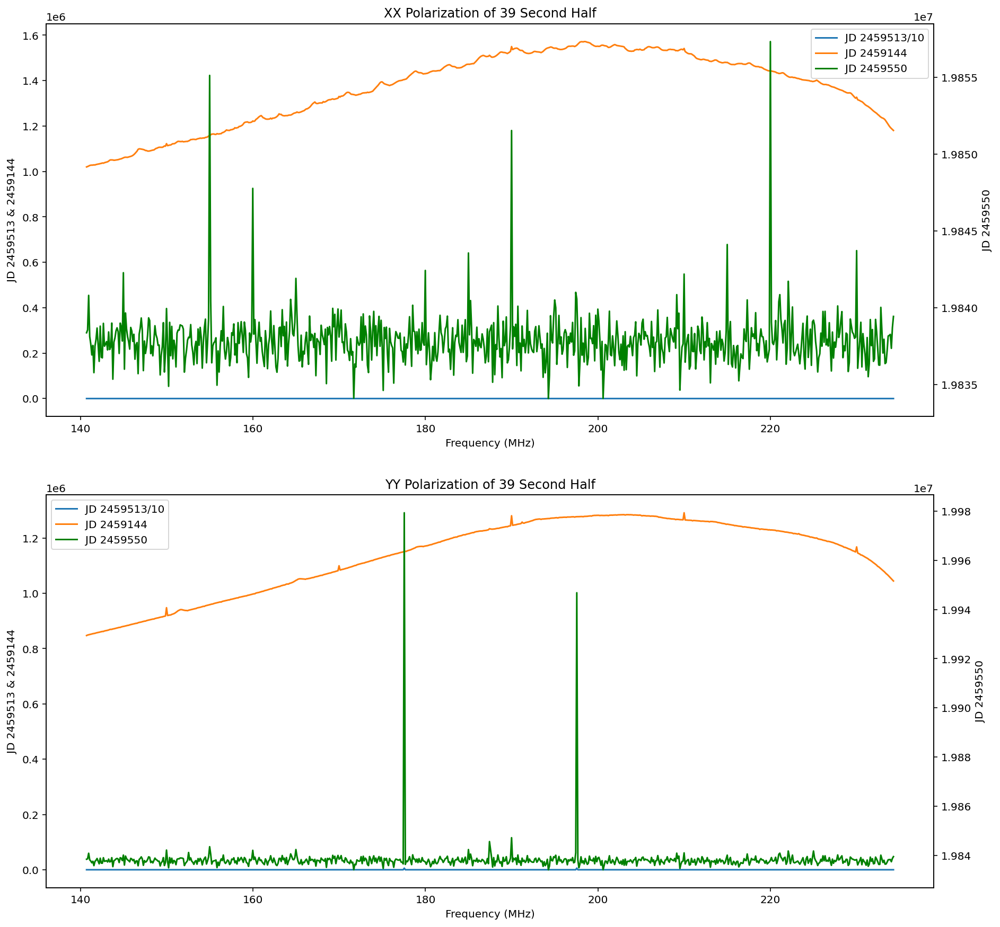

In [27]:
plot_same_fig_second_half(39)

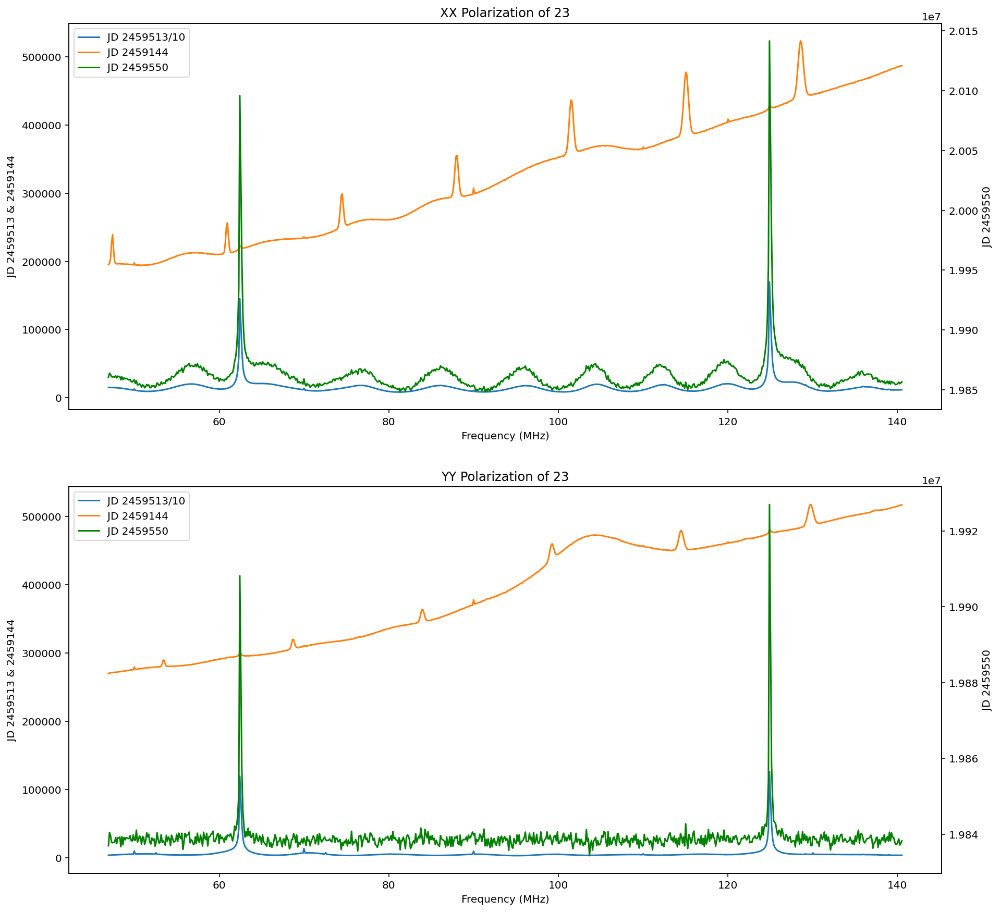

In [132]:
save_plt(23)

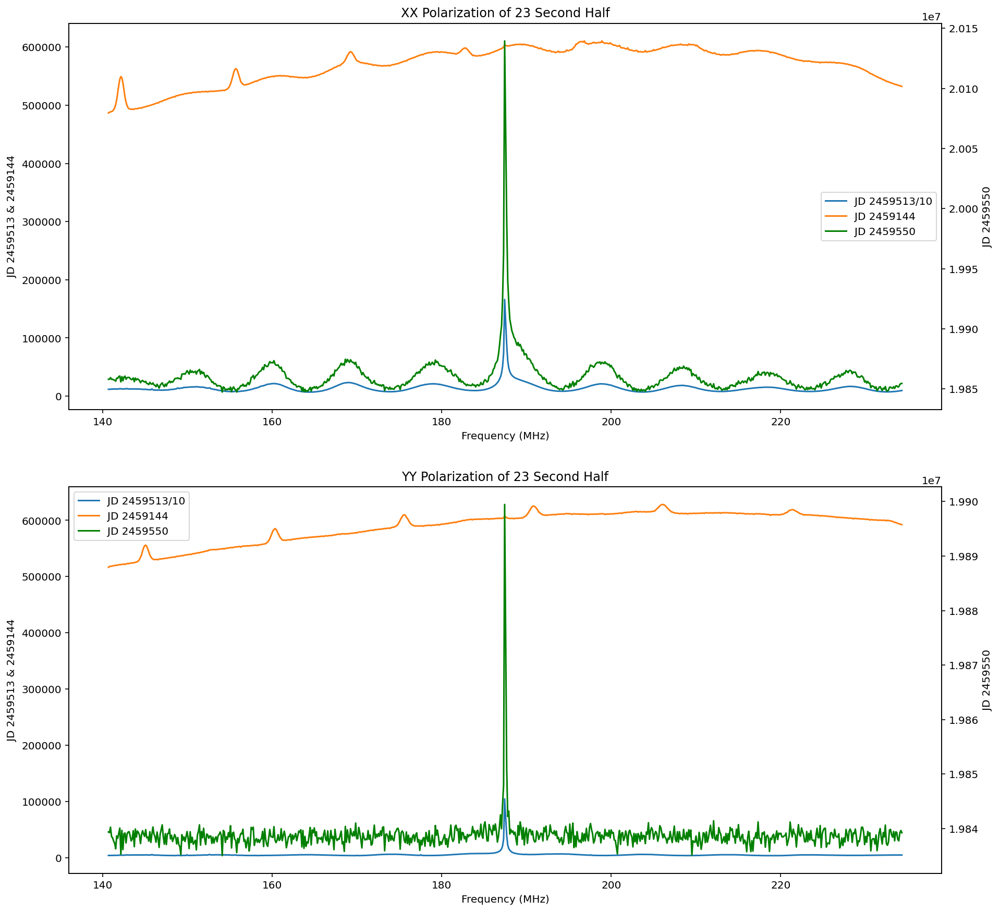

In [28]:
plot_same_fig_second_half(23)

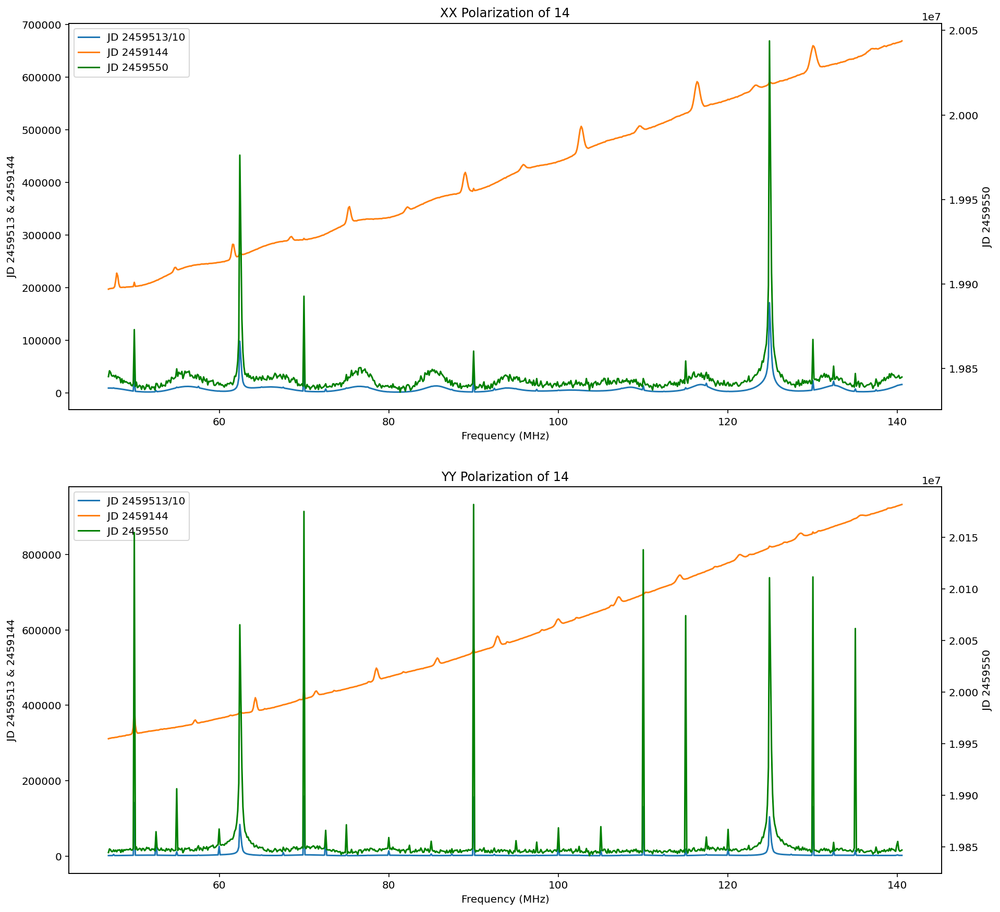

In [133]:
save_plt(14)

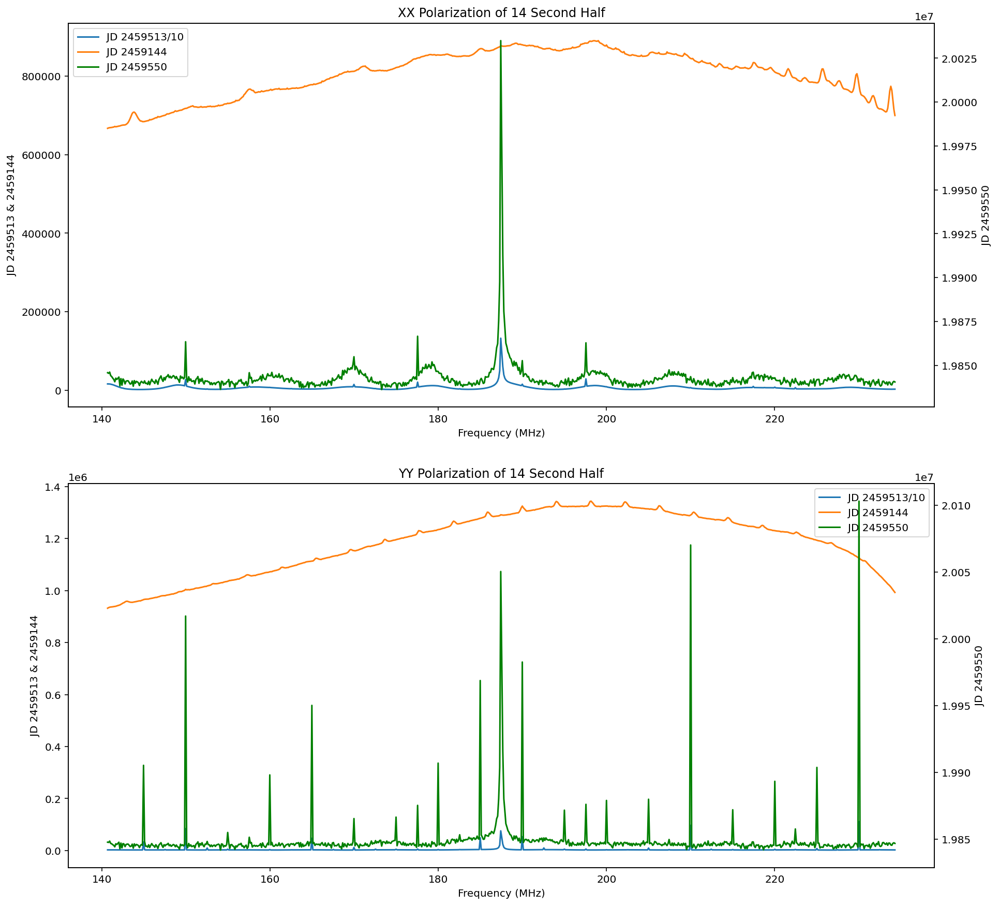

In [29]:
plot_same_fig_second_half(14)

# Node 01

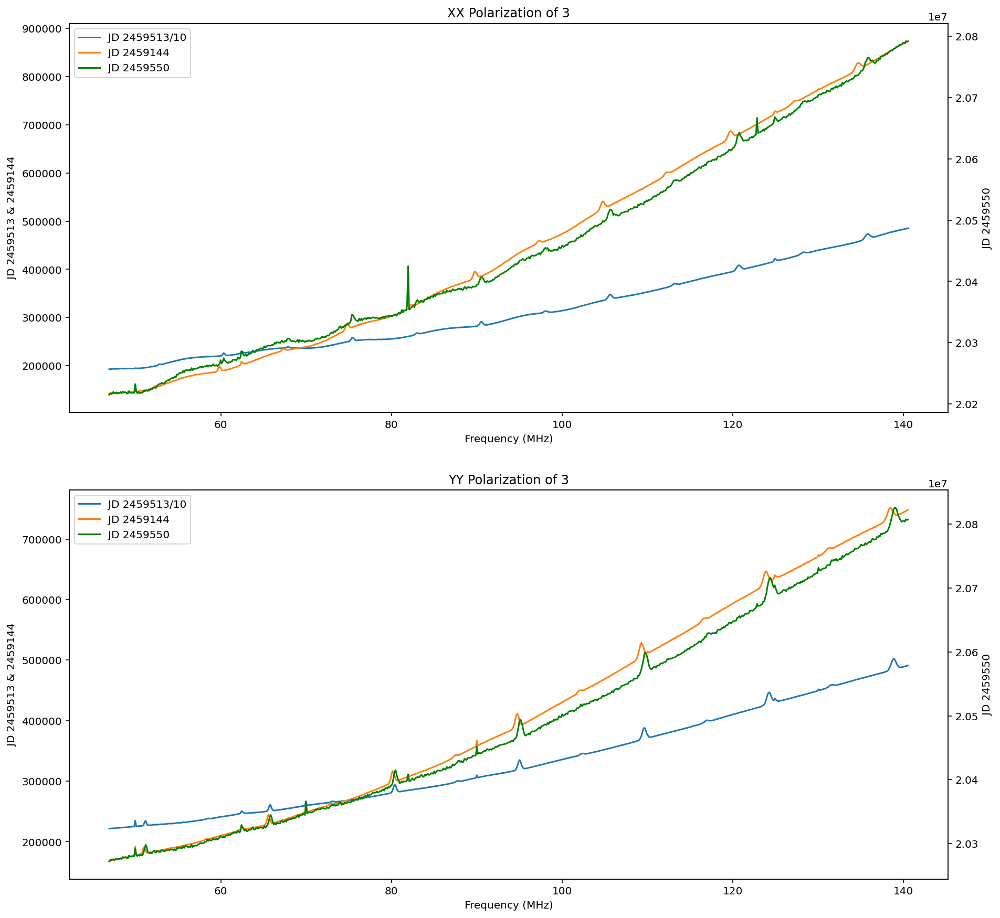

In [134]:
save_plt(3)

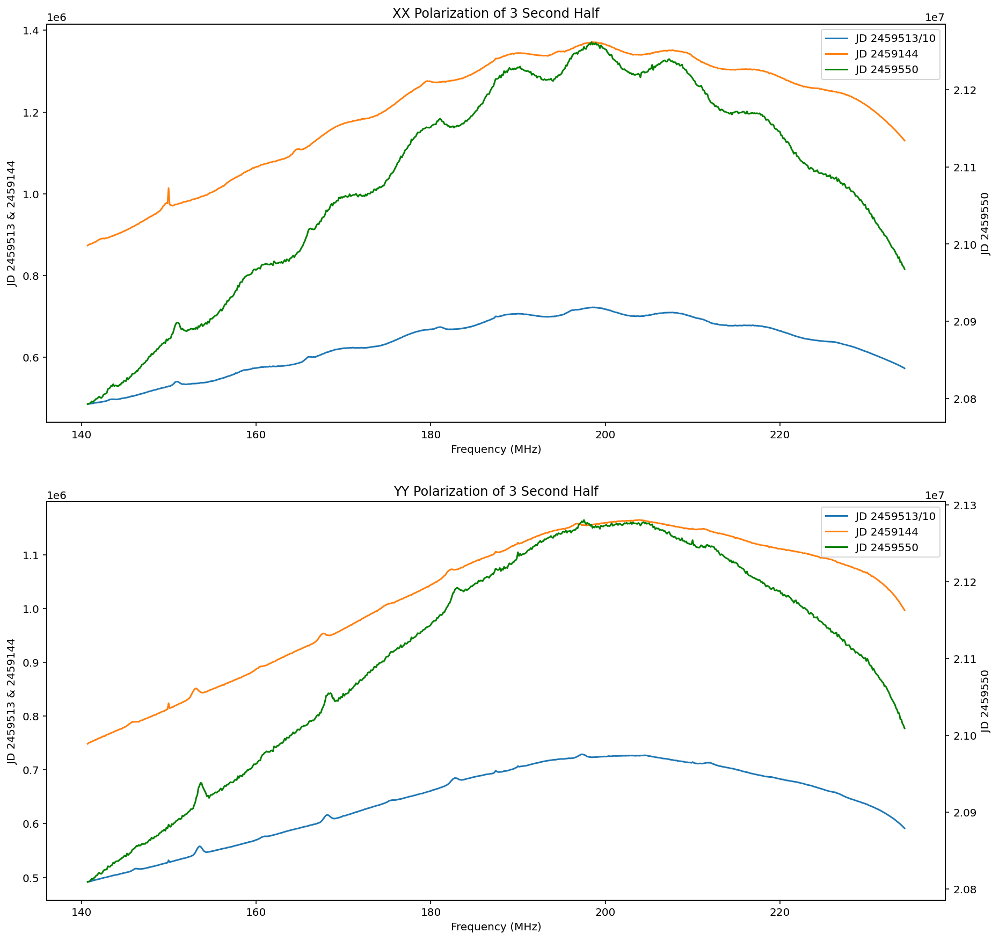

In [30]:
plot_same_fig_second_half(3)

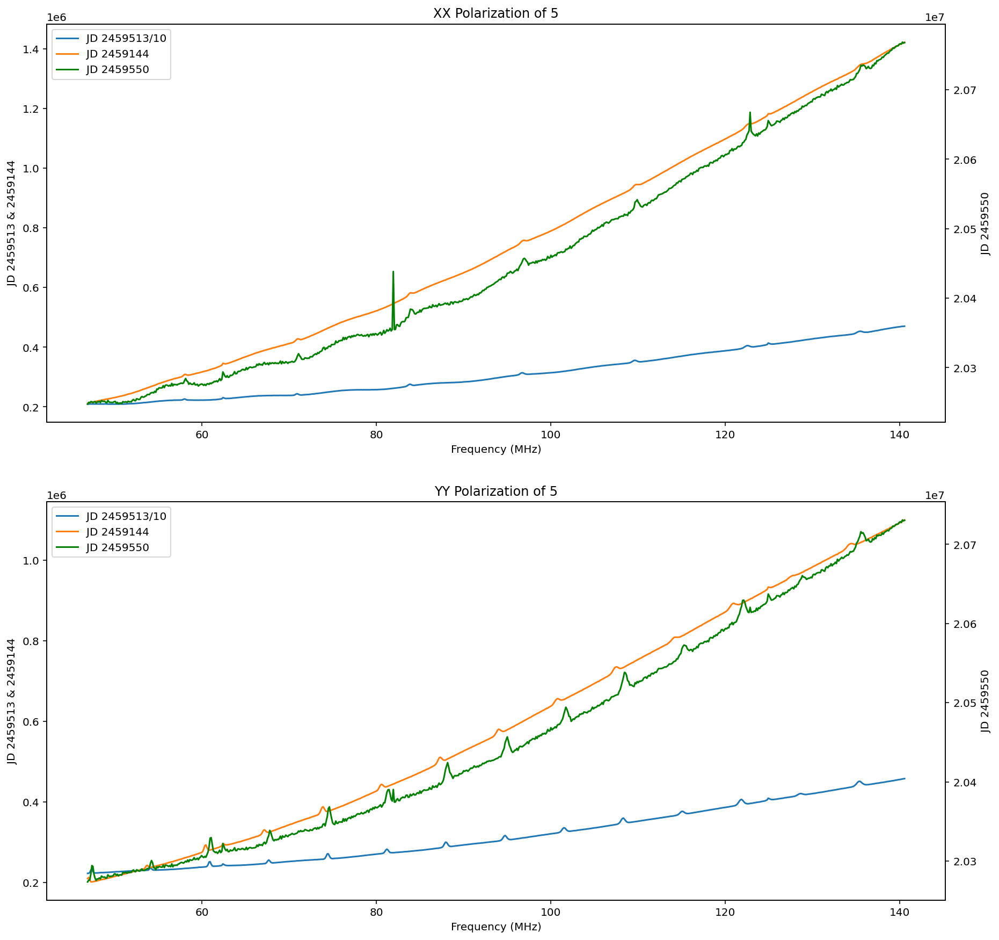

In [135]:
save_plt(5)

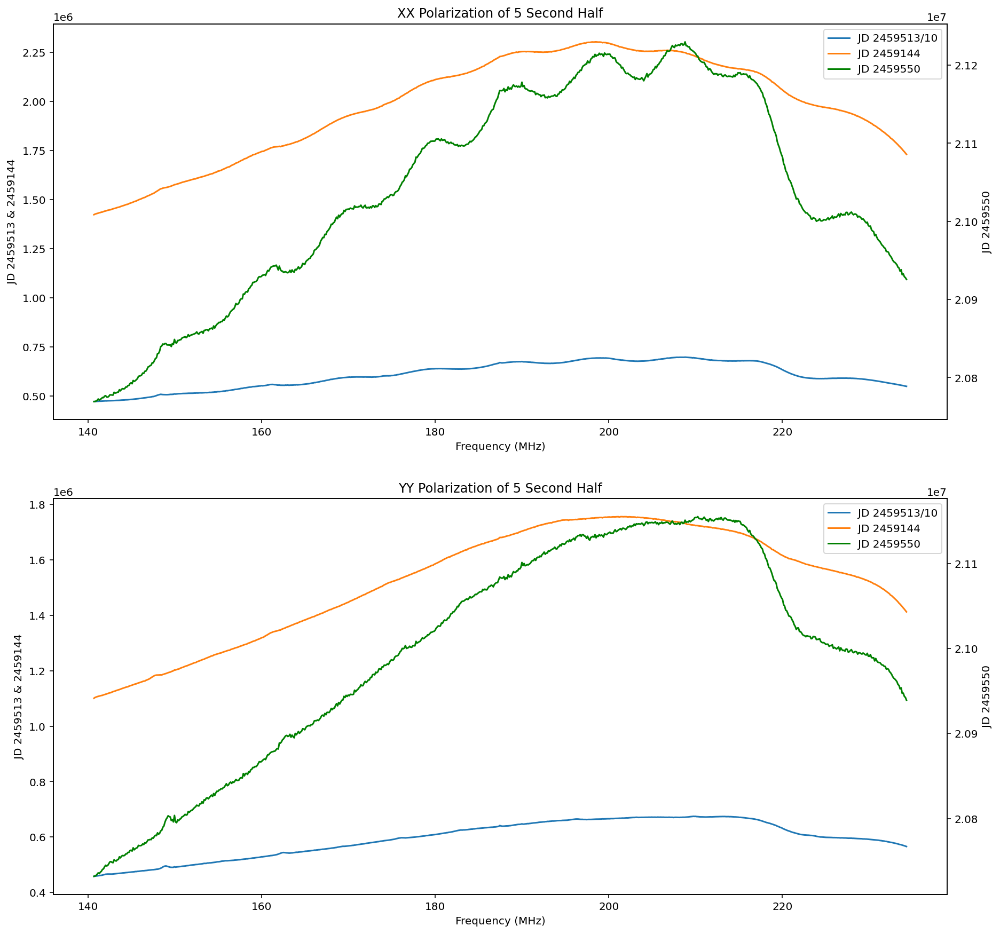

In [31]:
plot_same_fig_second_half(5)

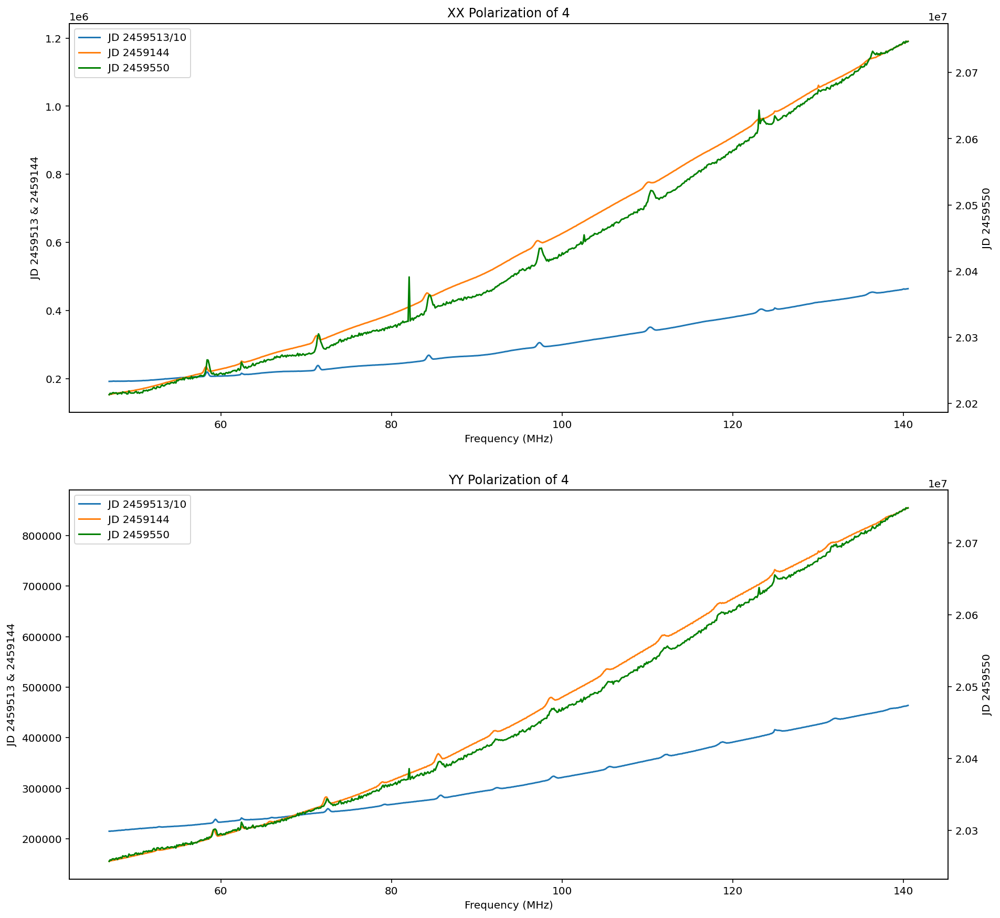

In [136]:
save_plt(4)

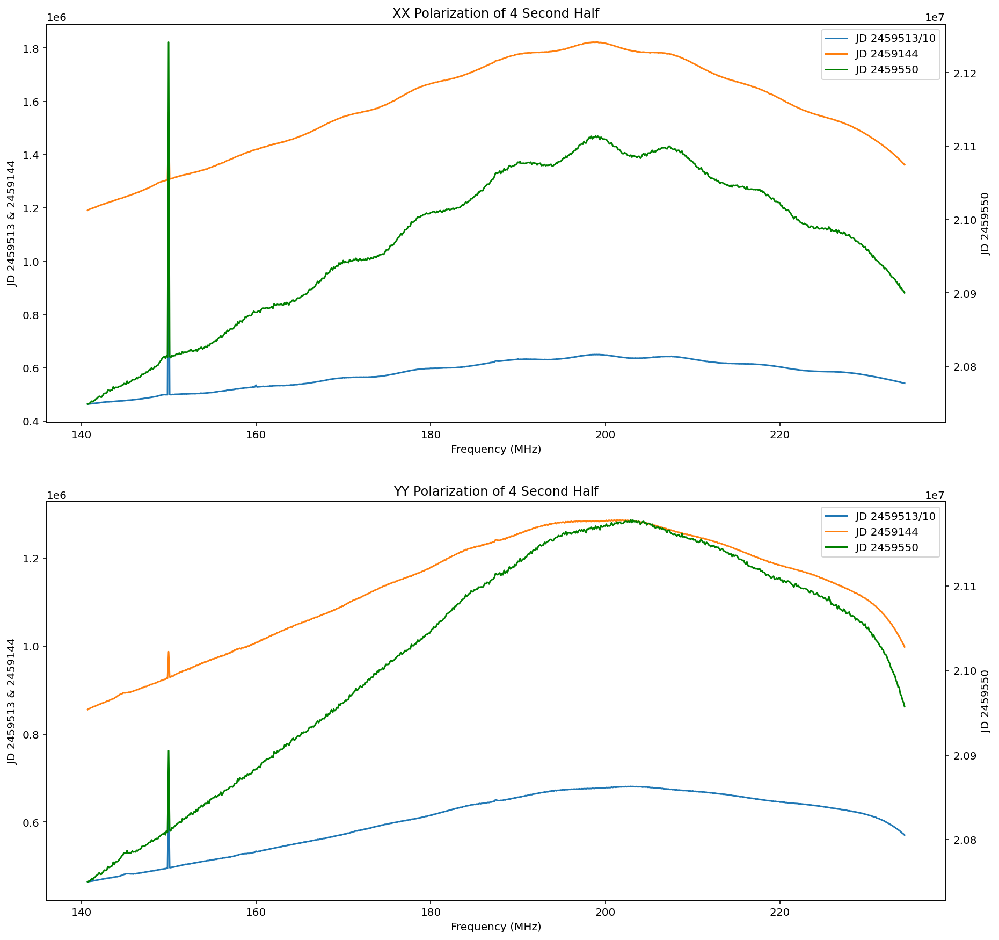

In [32]:
plot_same_fig_second_half(4)

# Node 05

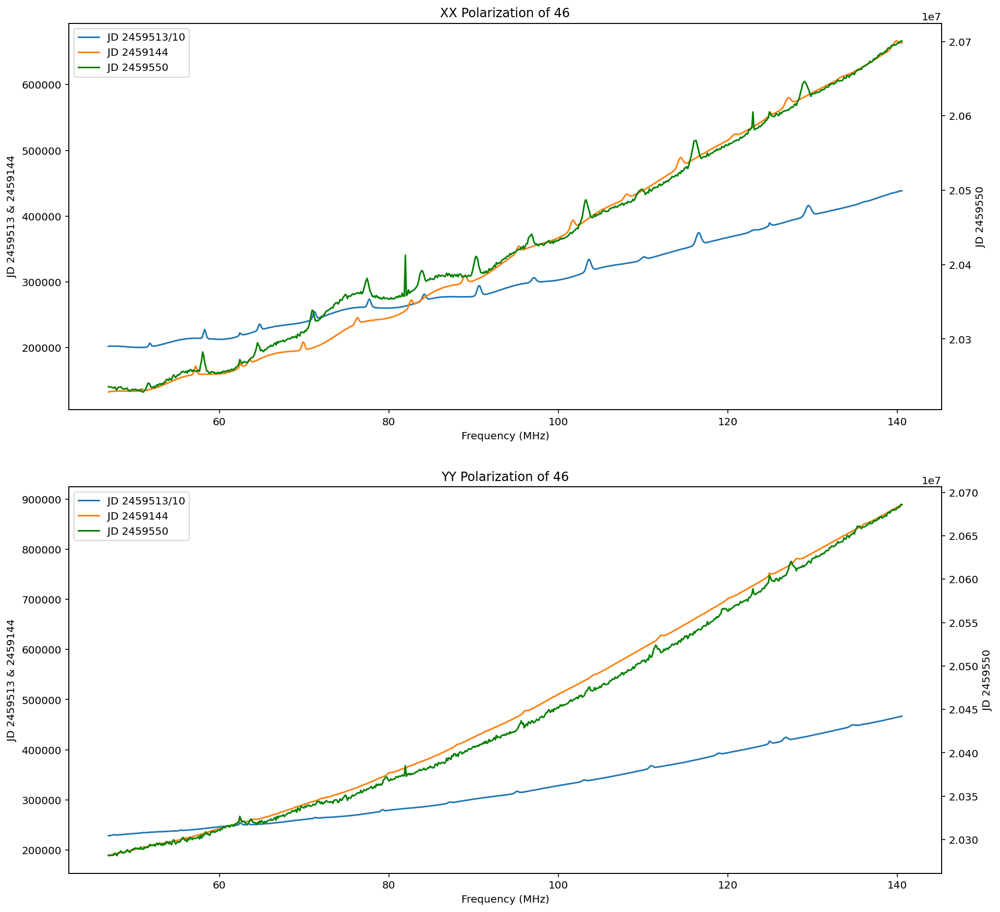

In [137]:
save_plt(46)

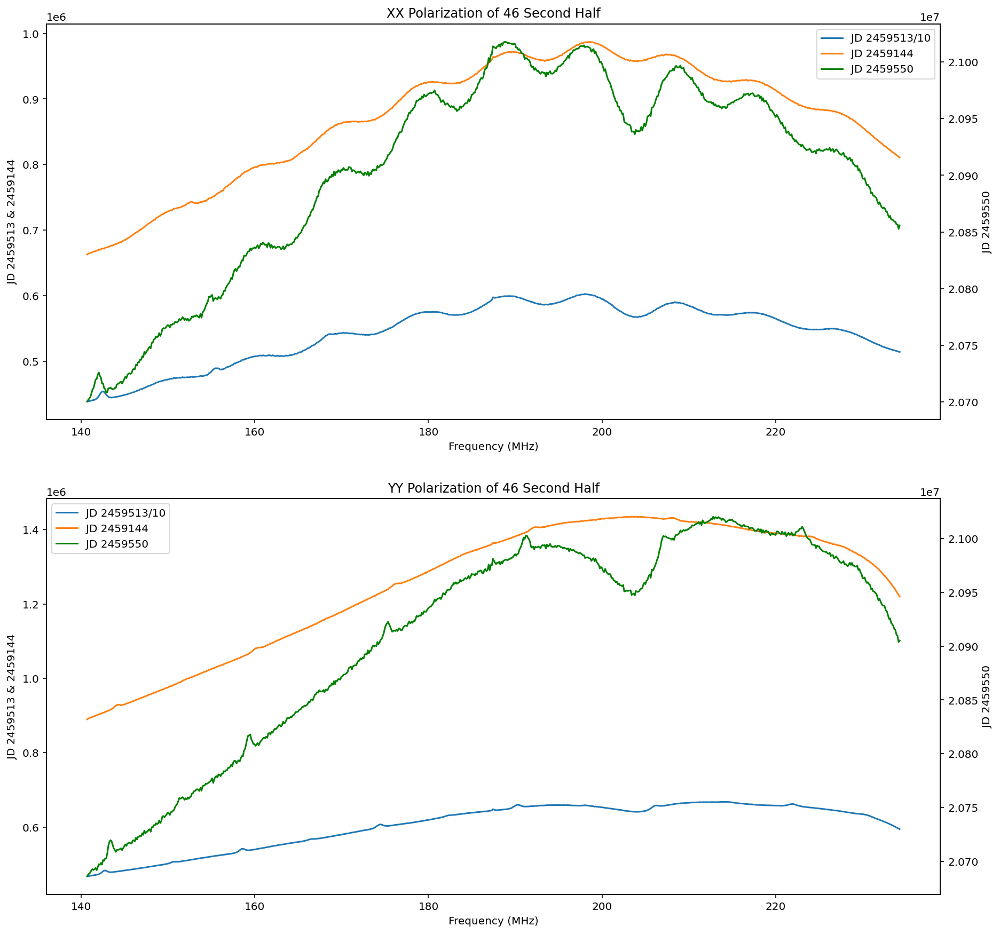

In [33]:
plot_same_fig_second_half(46)

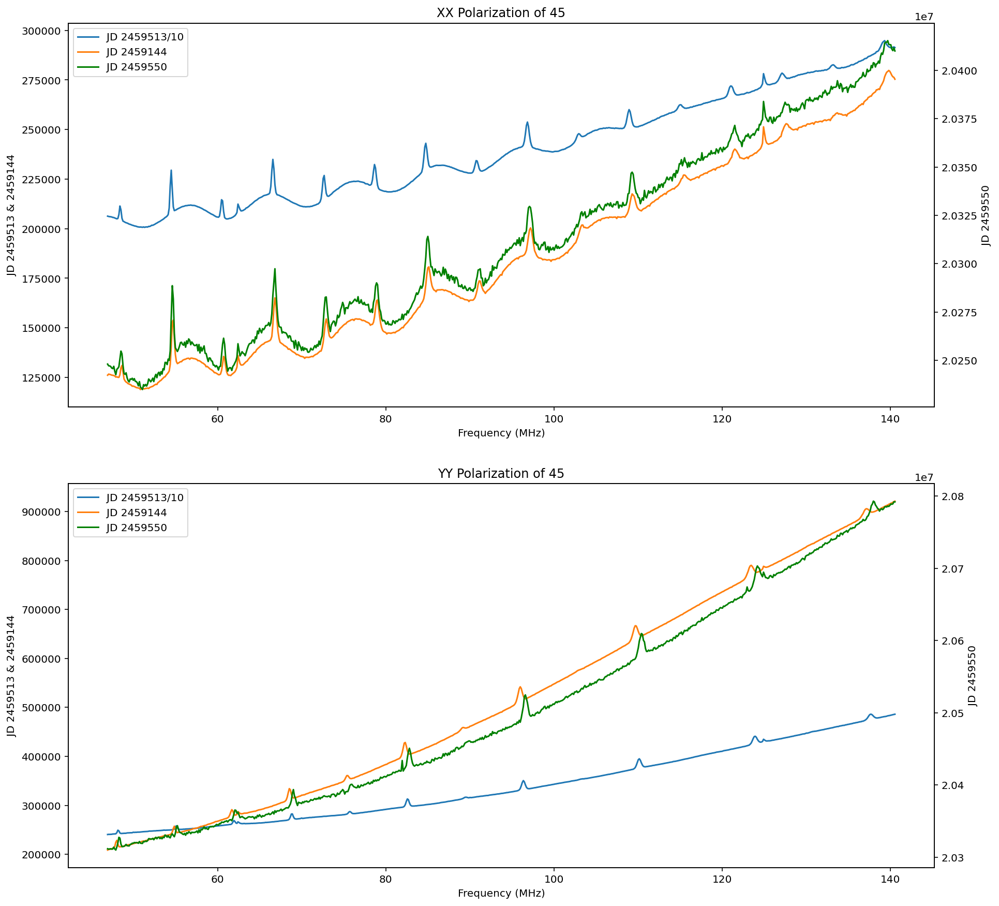

In [138]:
save_plt(45)

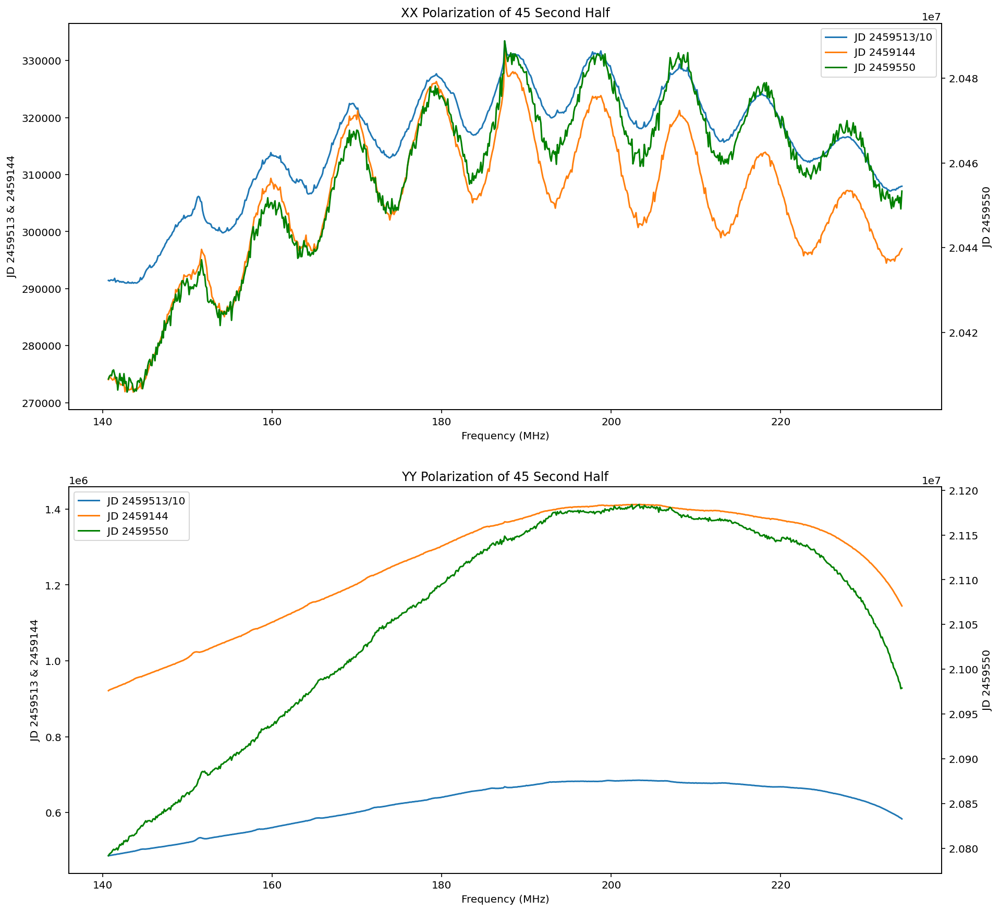

In [34]:
plot_same_fig_second_half(45)

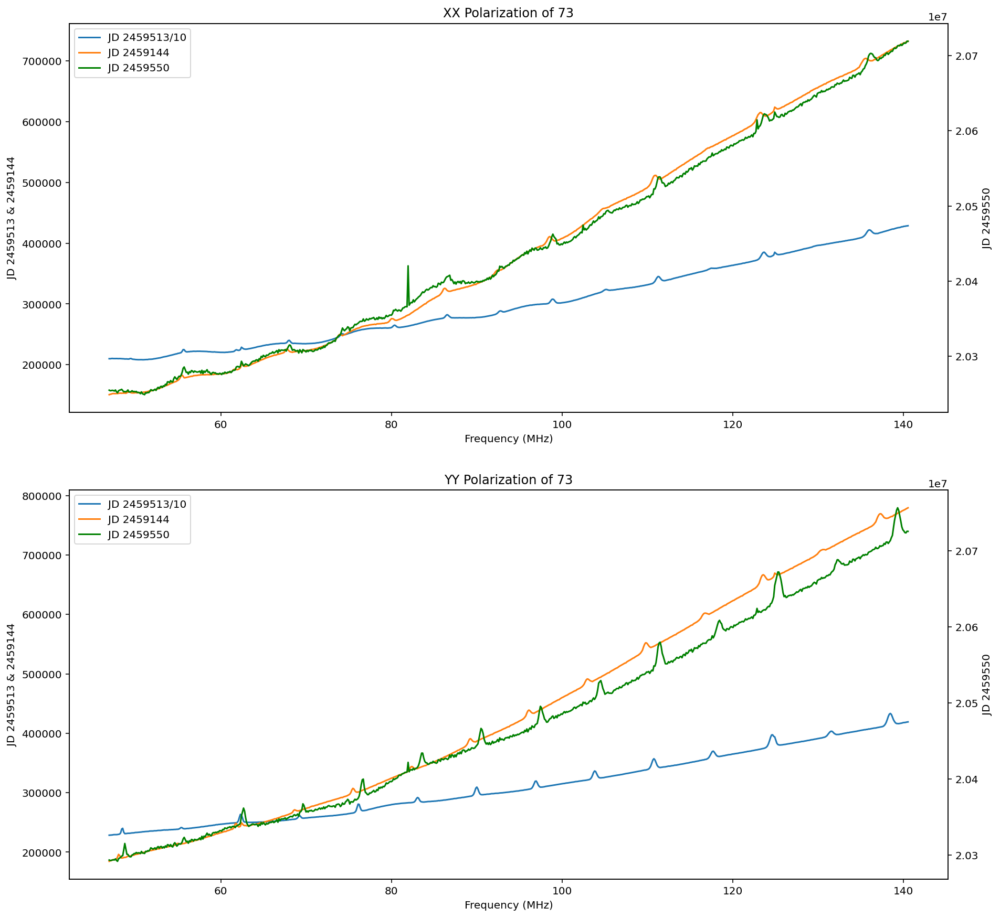

In [139]:
save_plt(73)

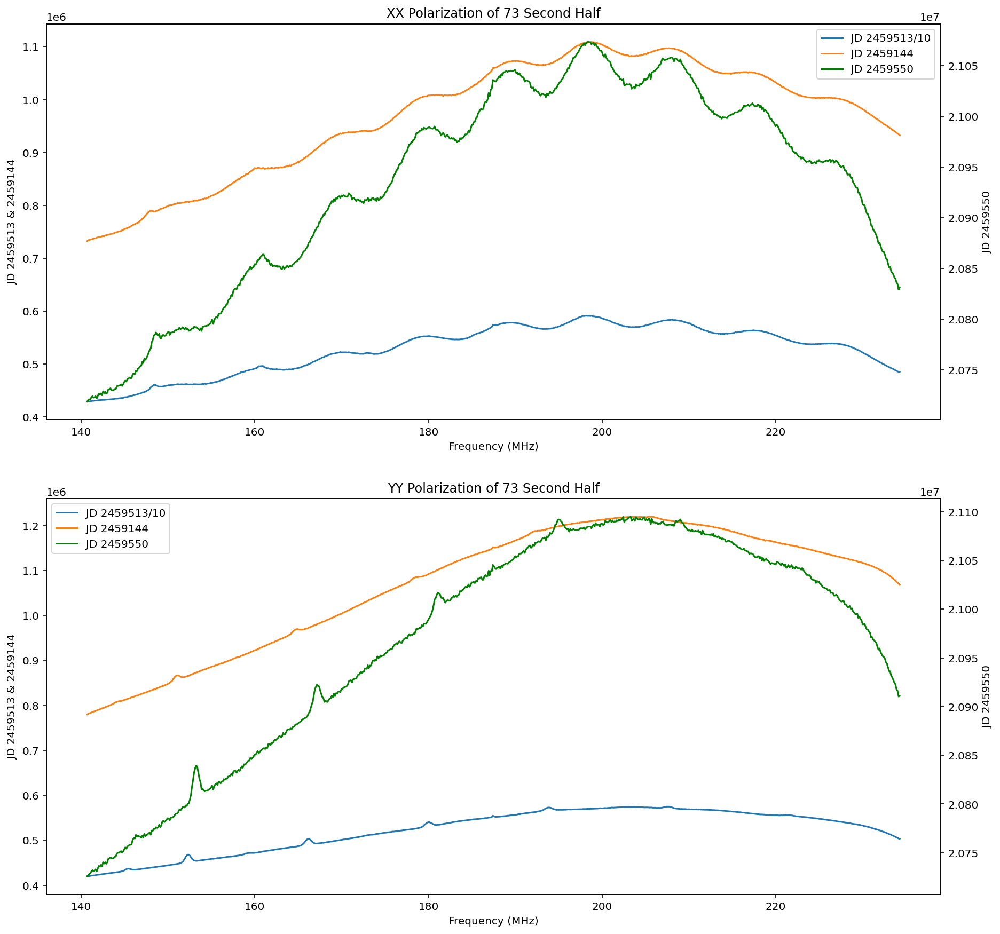

In [35]:
plot_same_fig_second_half(73)

# Node 07

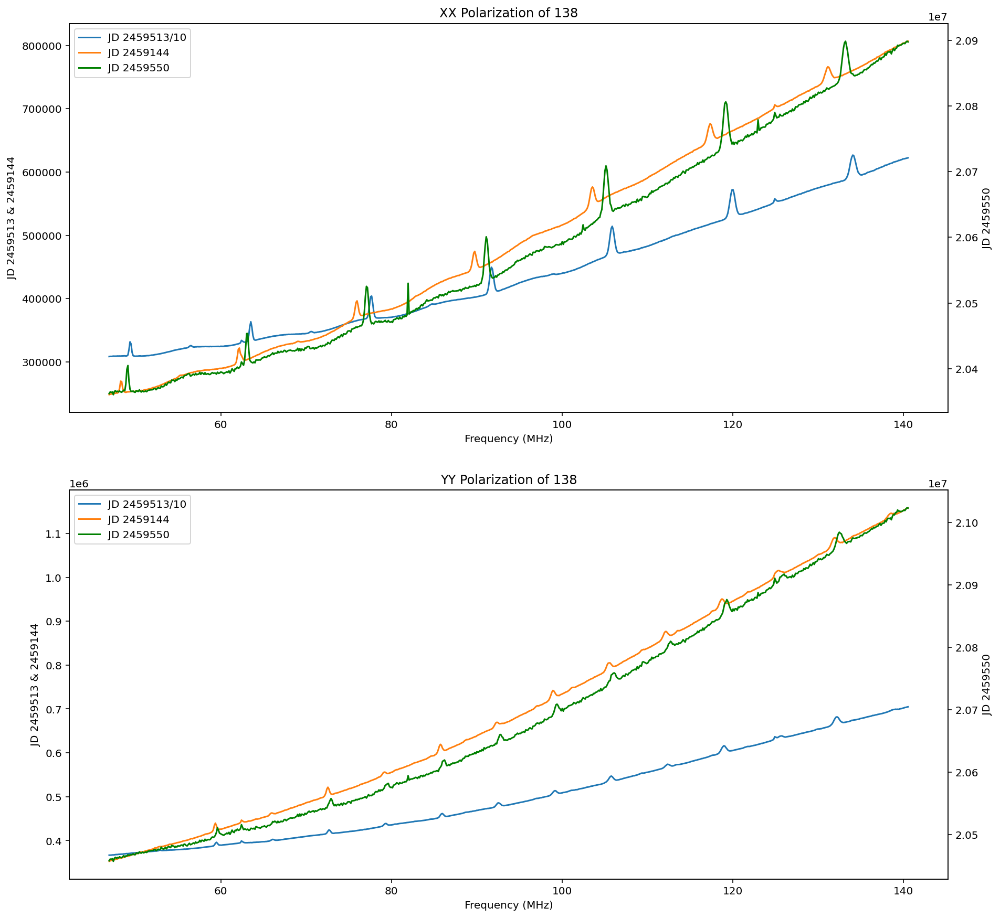

In [140]:
save_plt(138)

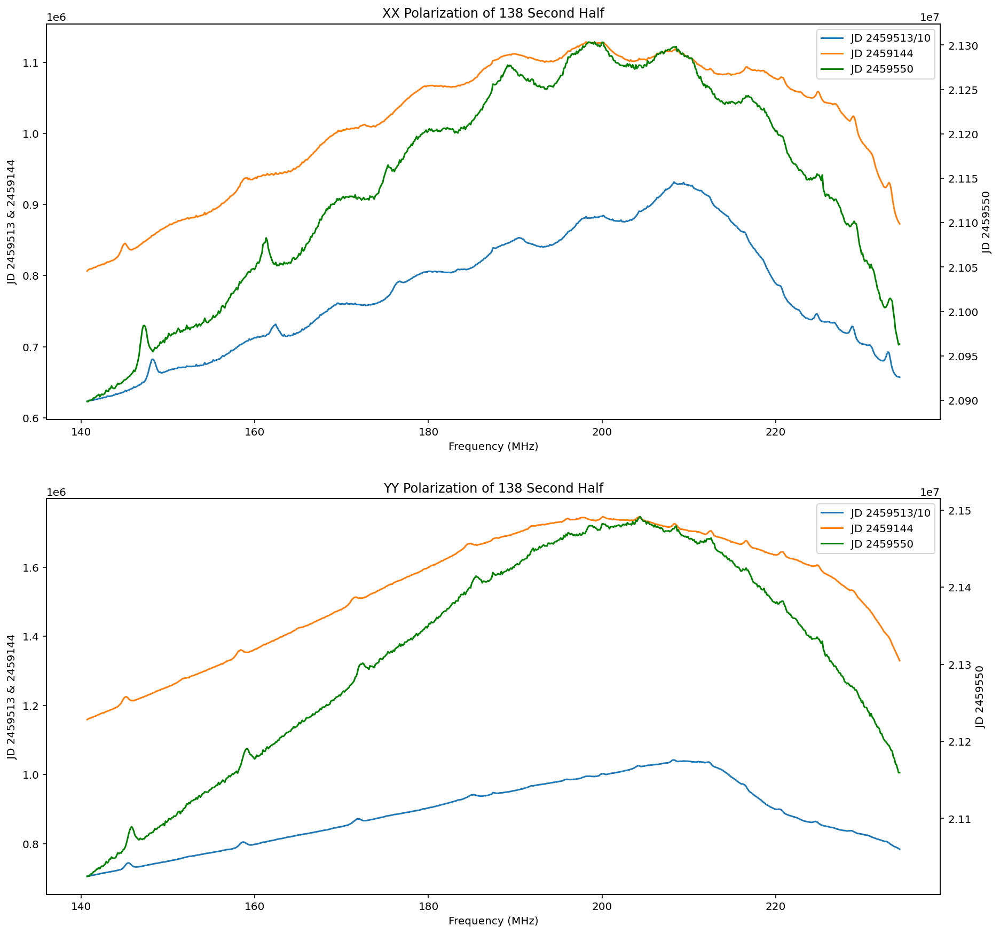

In [36]:
plot_same_fig_second_half(138)

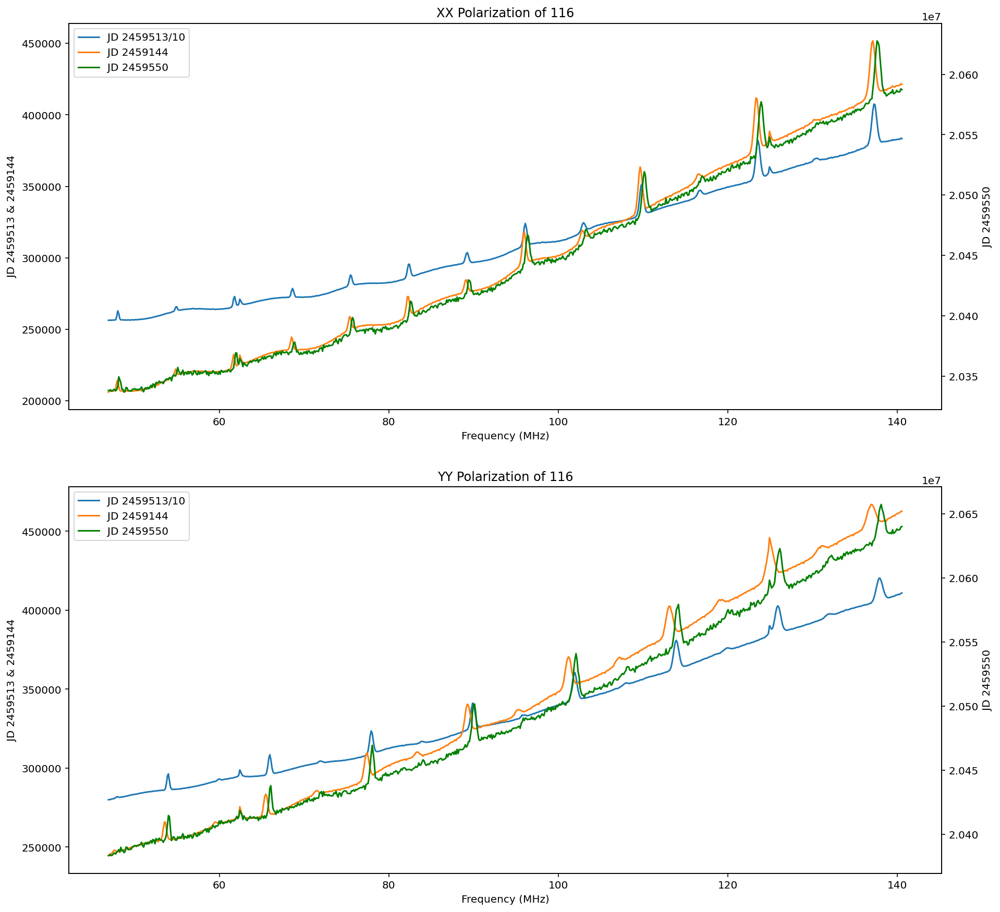

In [141]:
save_plt(116)

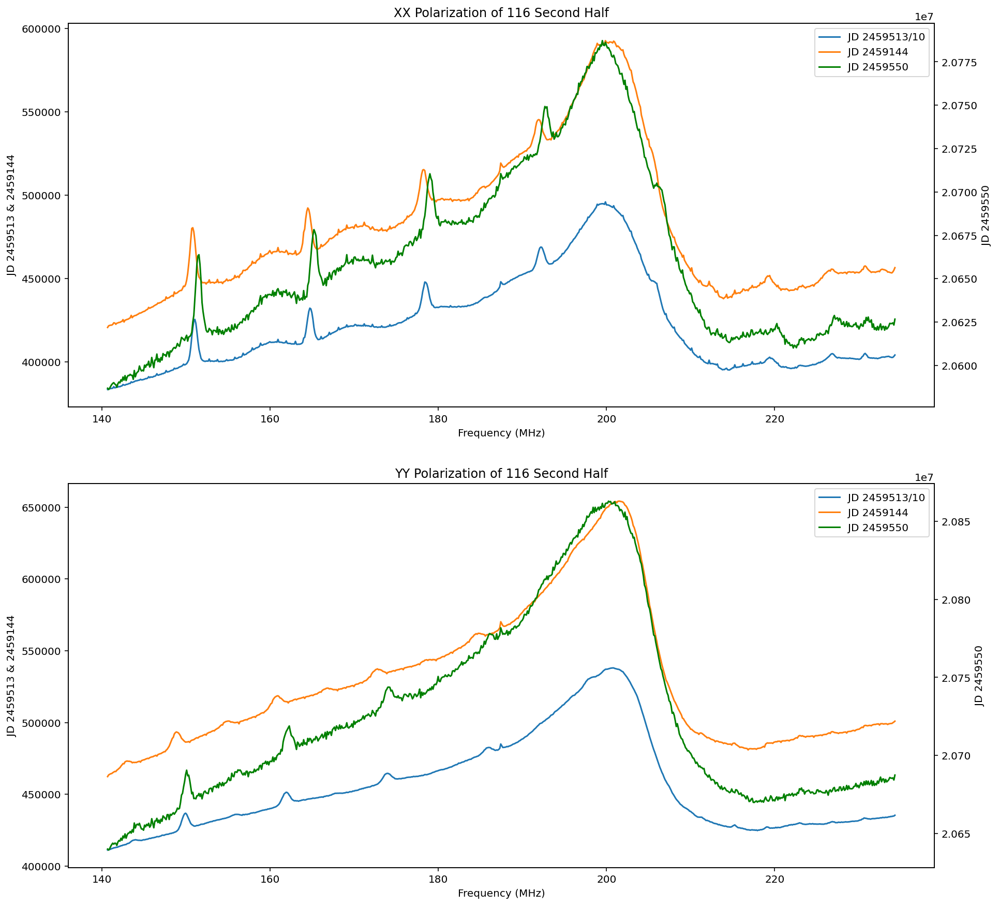

In [37]:
plot_same_fig_second_half(116)

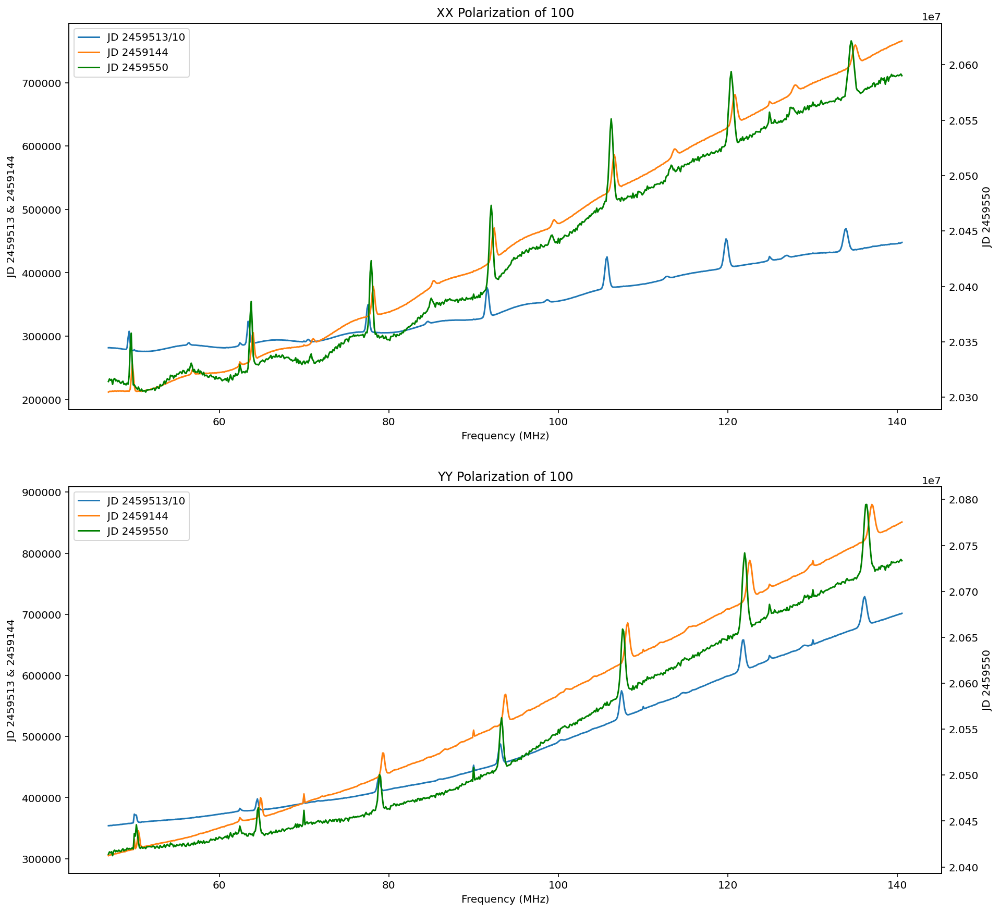

In [142]:
save_plt(100)

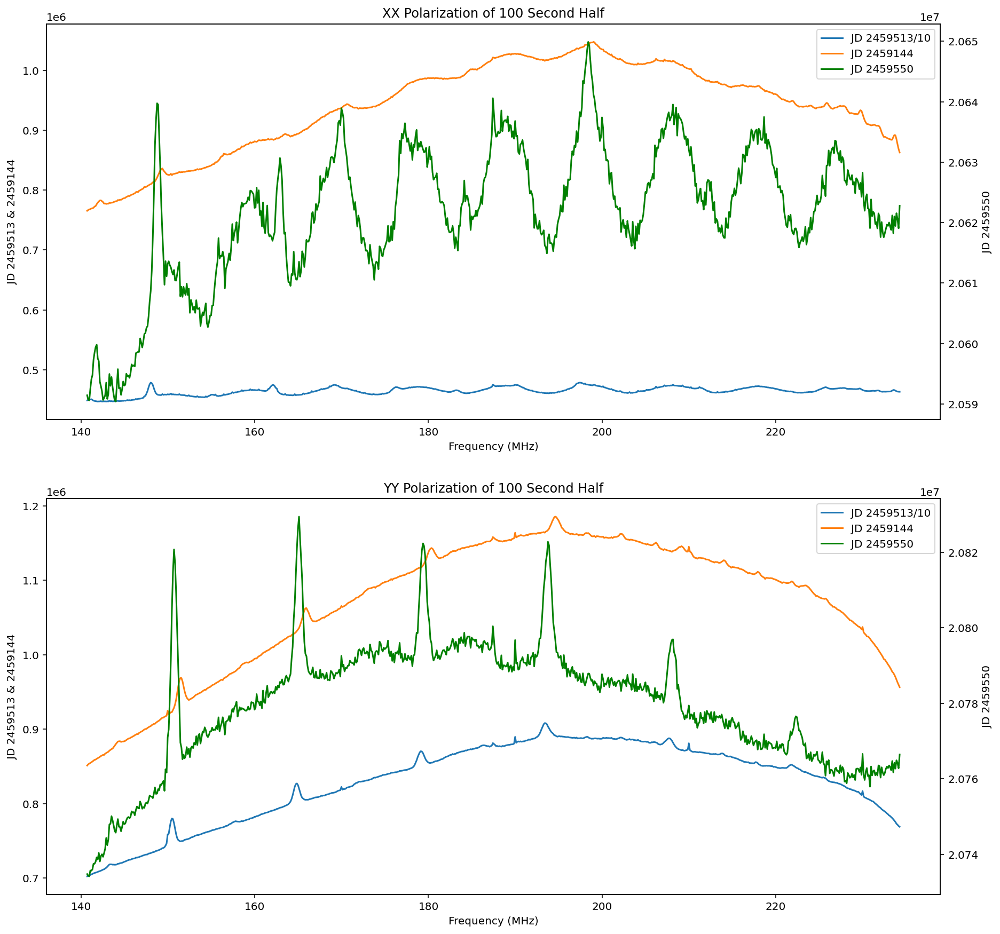

In [38]:
plot_same_fig_second_half(100)

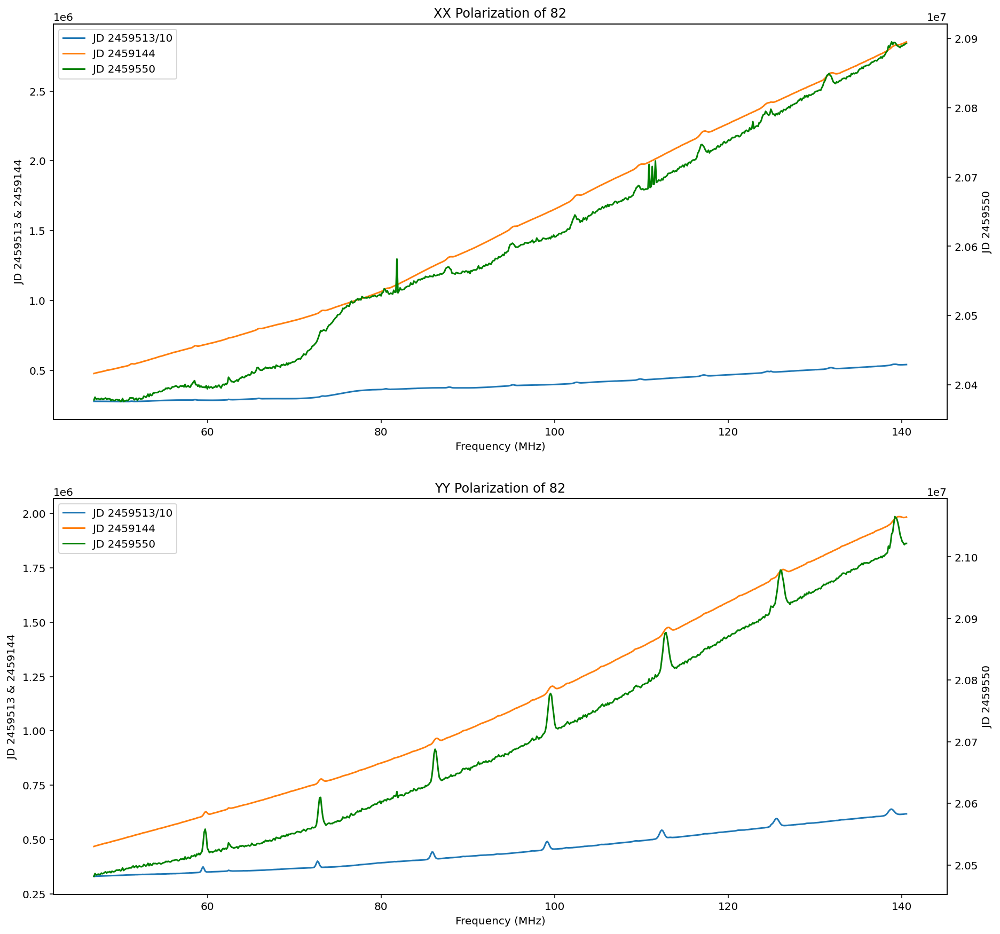

In [143]:
save_plt(82)

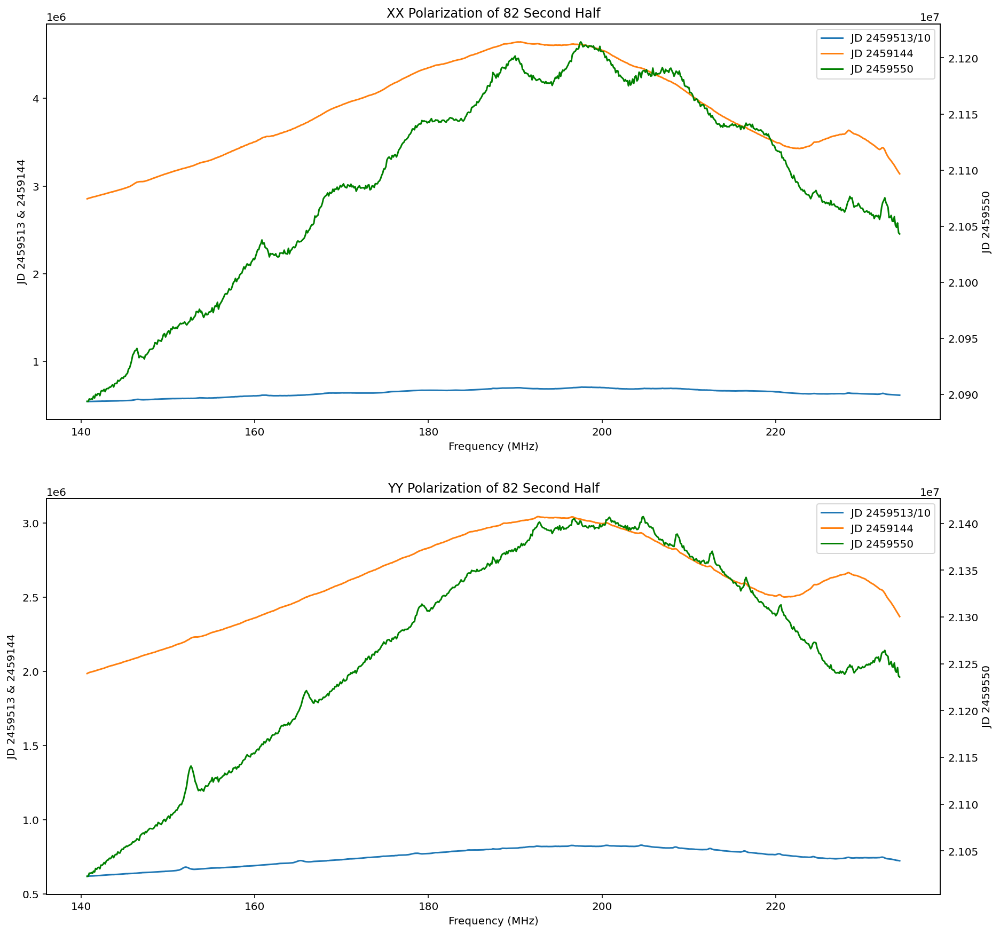

In [39]:
plot_same_fig_second_half(82)

# Node 08

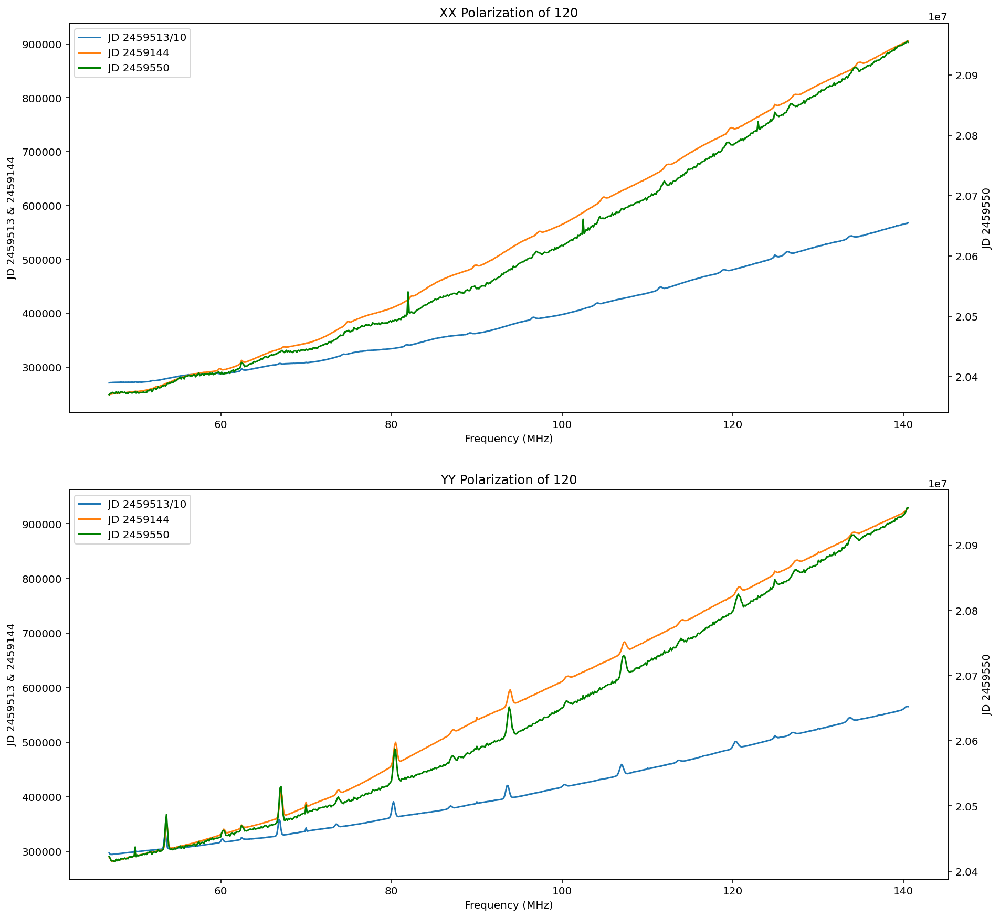

In [144]:
save_plt(120)

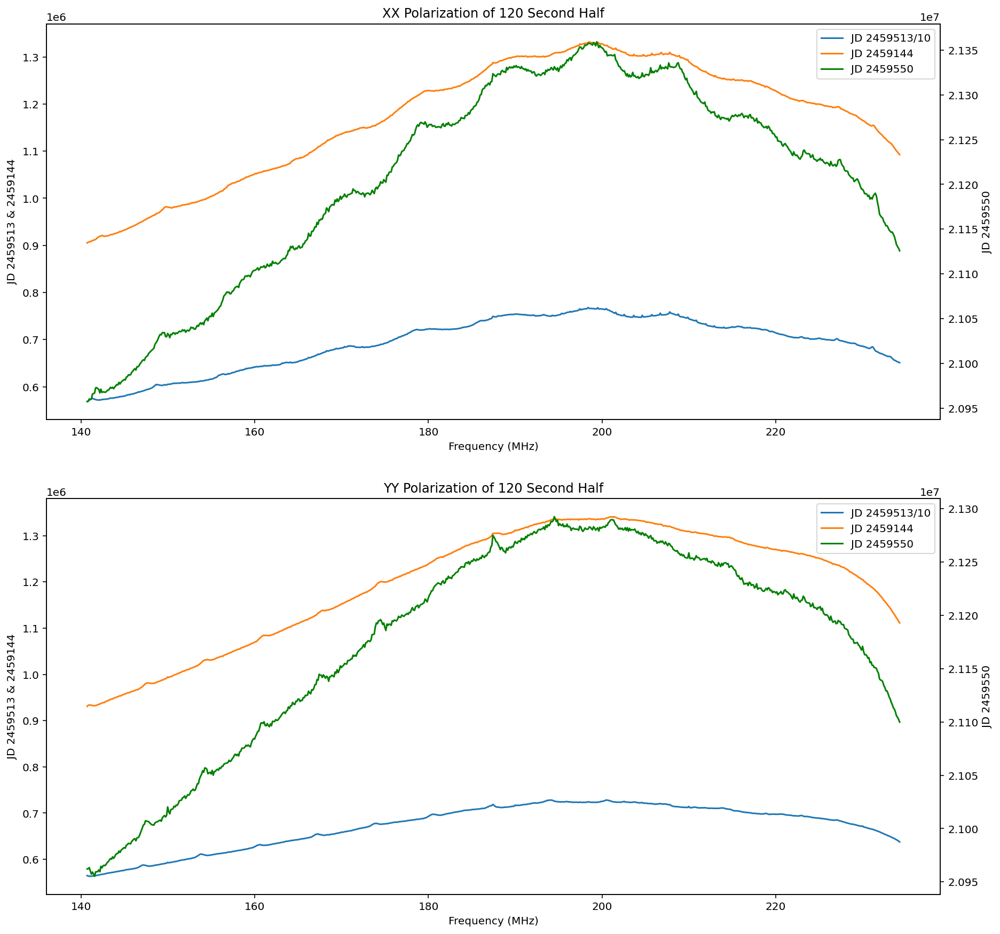

In [40]:
plot_same_fig_second_half(120)

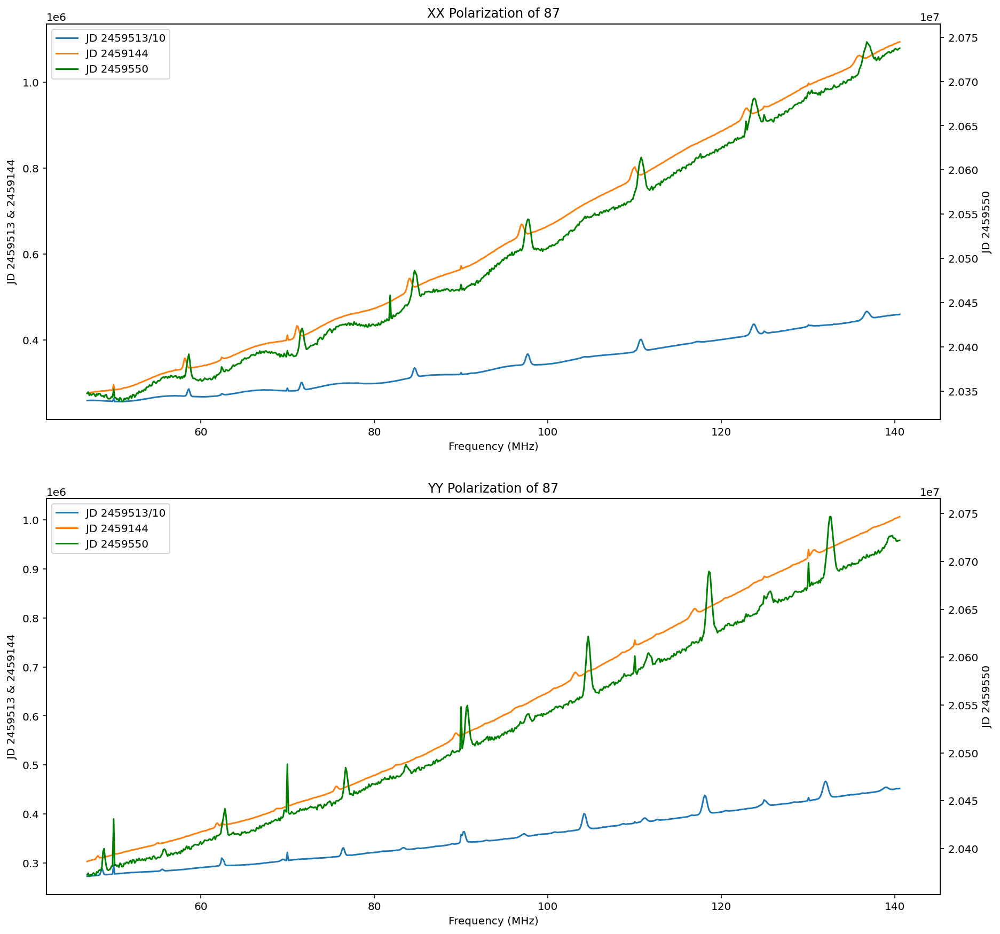

In [145]:
save_plt(87)

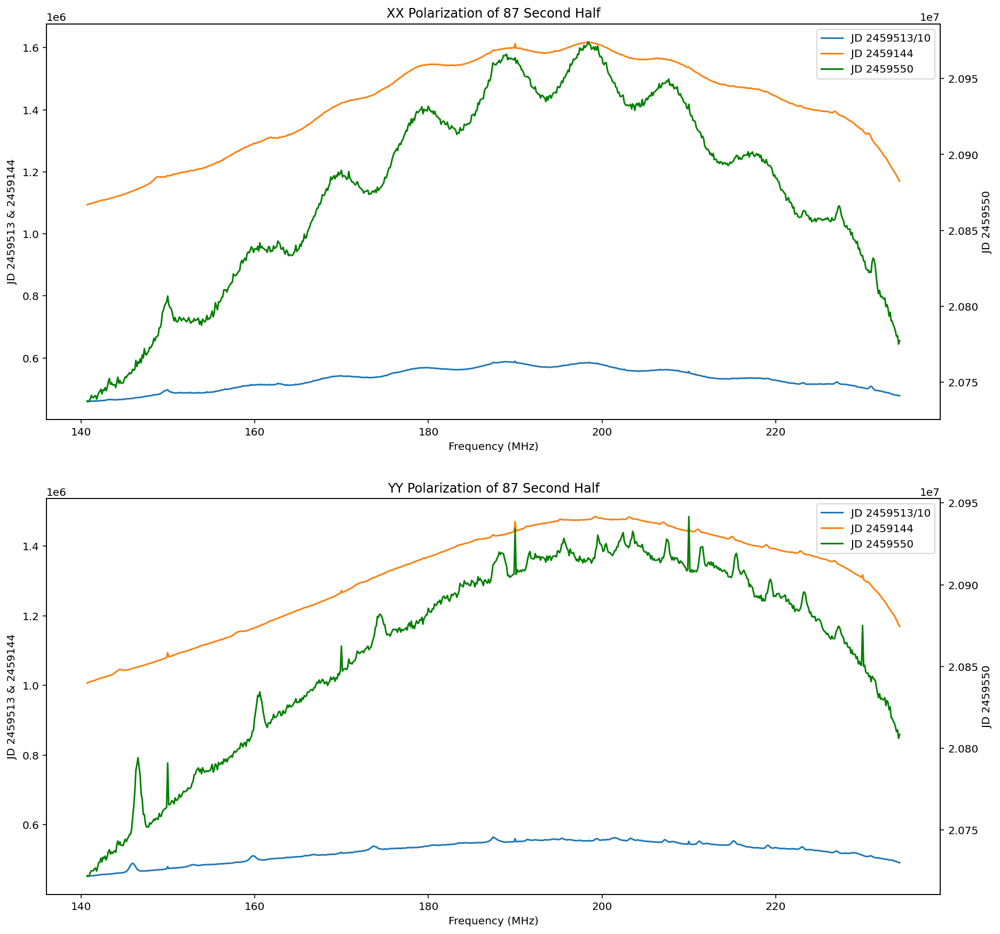

In [41]:
plot_same_fig_second_half(87)

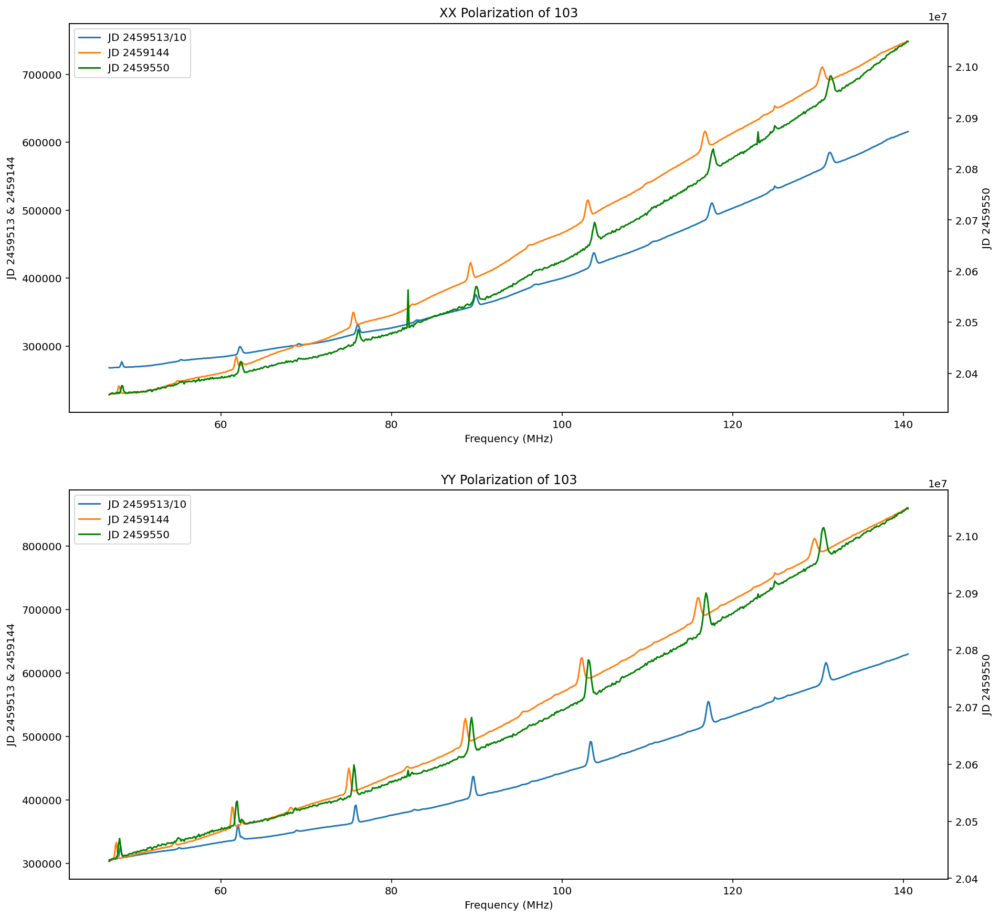

In [146]:
save_plt(103)

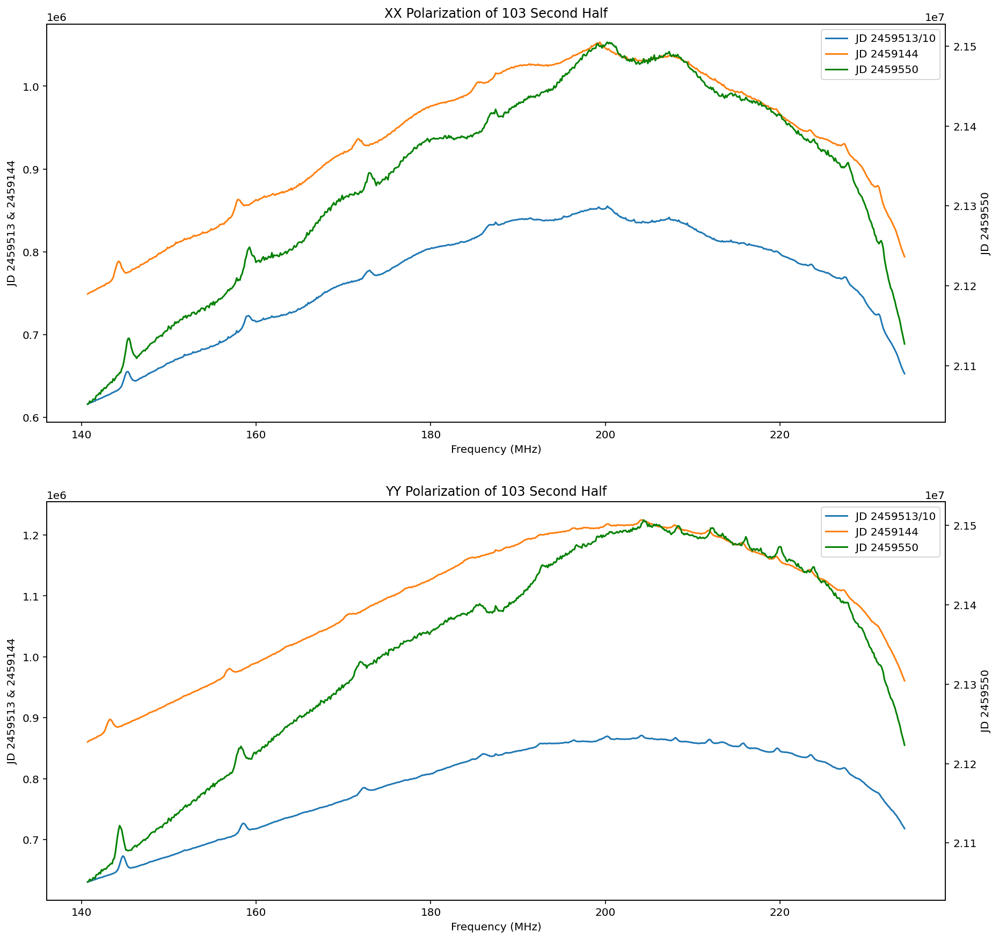

In [42]:
plot_same_fig_second_half(103)

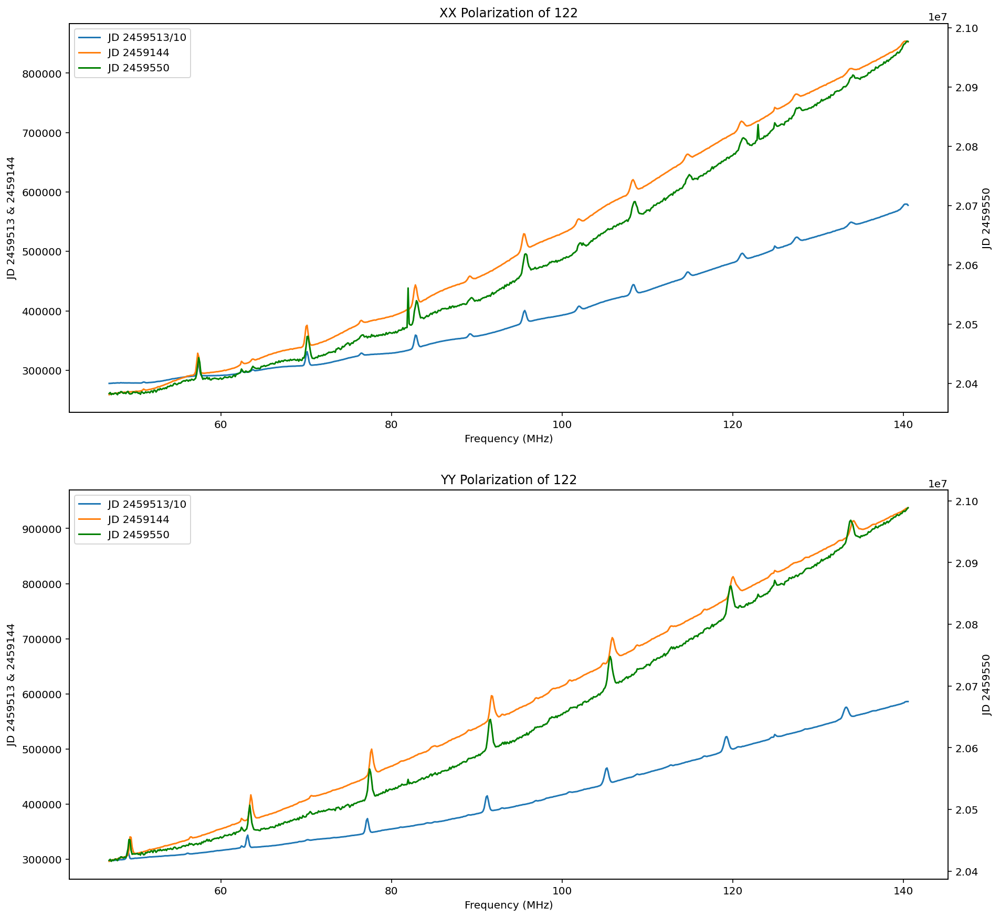

In [147]:
save_plt(122)

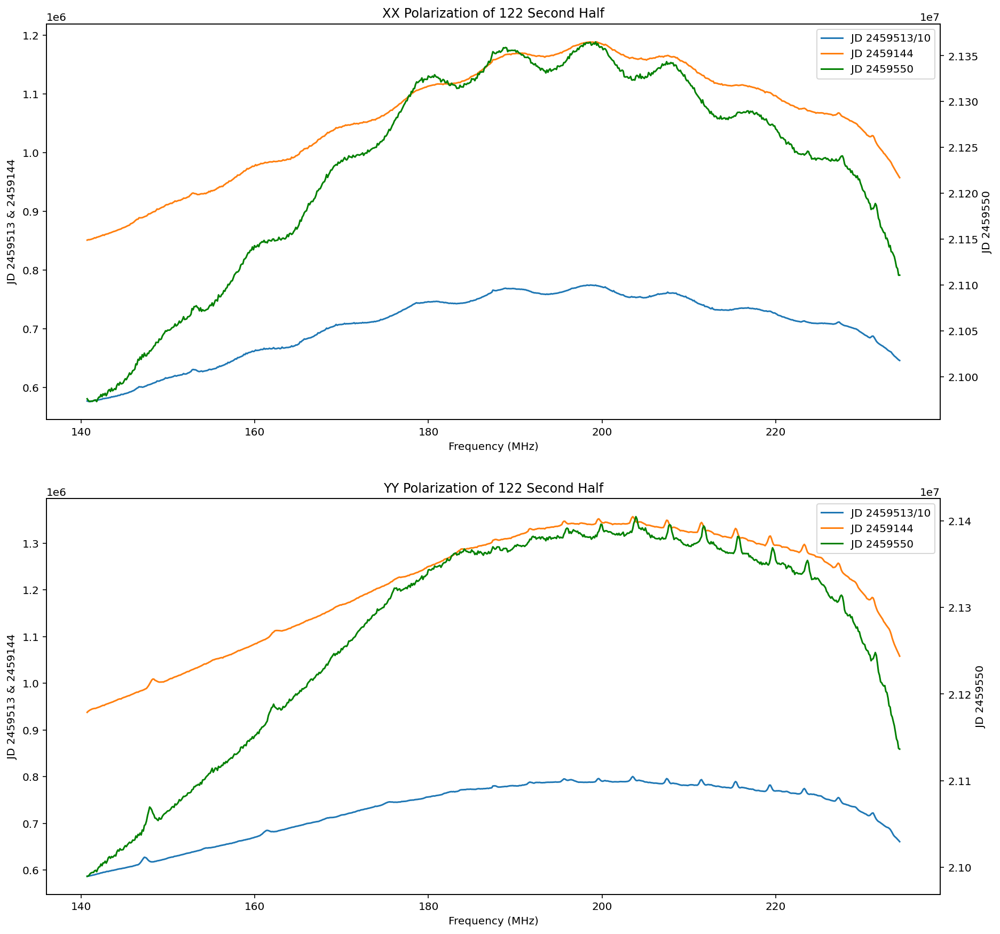

In [43]:
plot_same_fig_second_half(122)

# Node 10

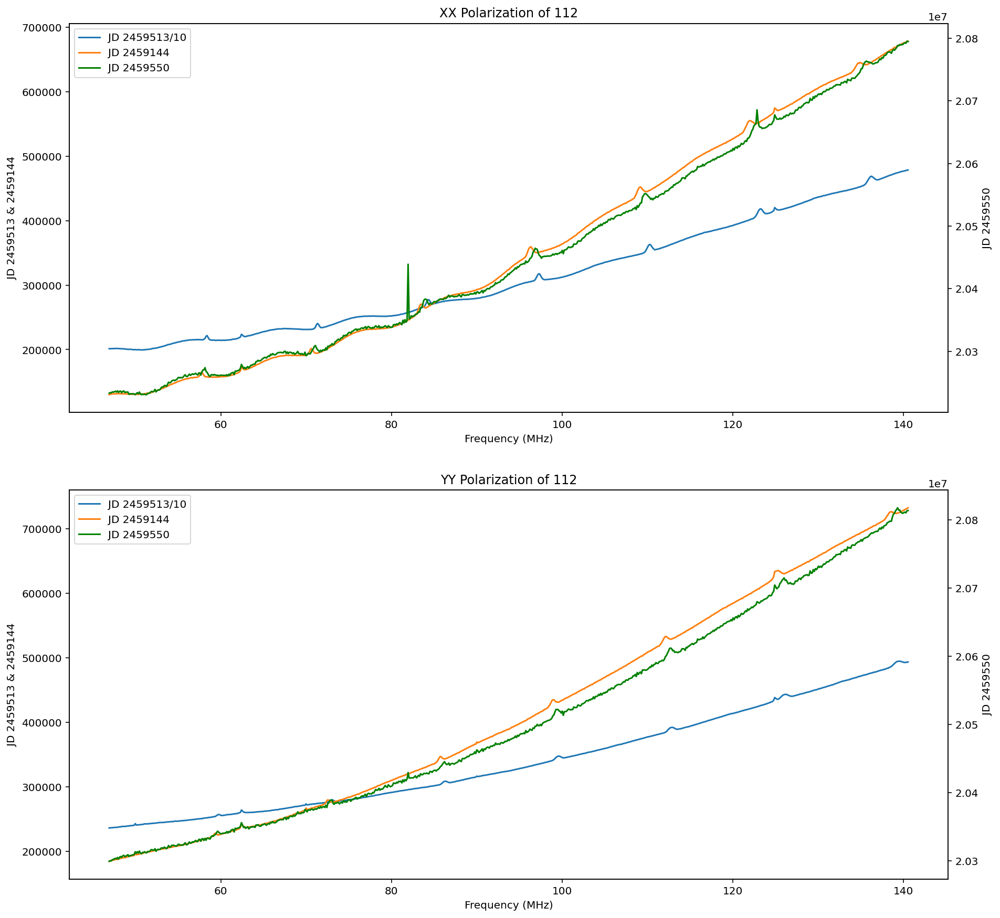

In [67]:
save_plt(112)

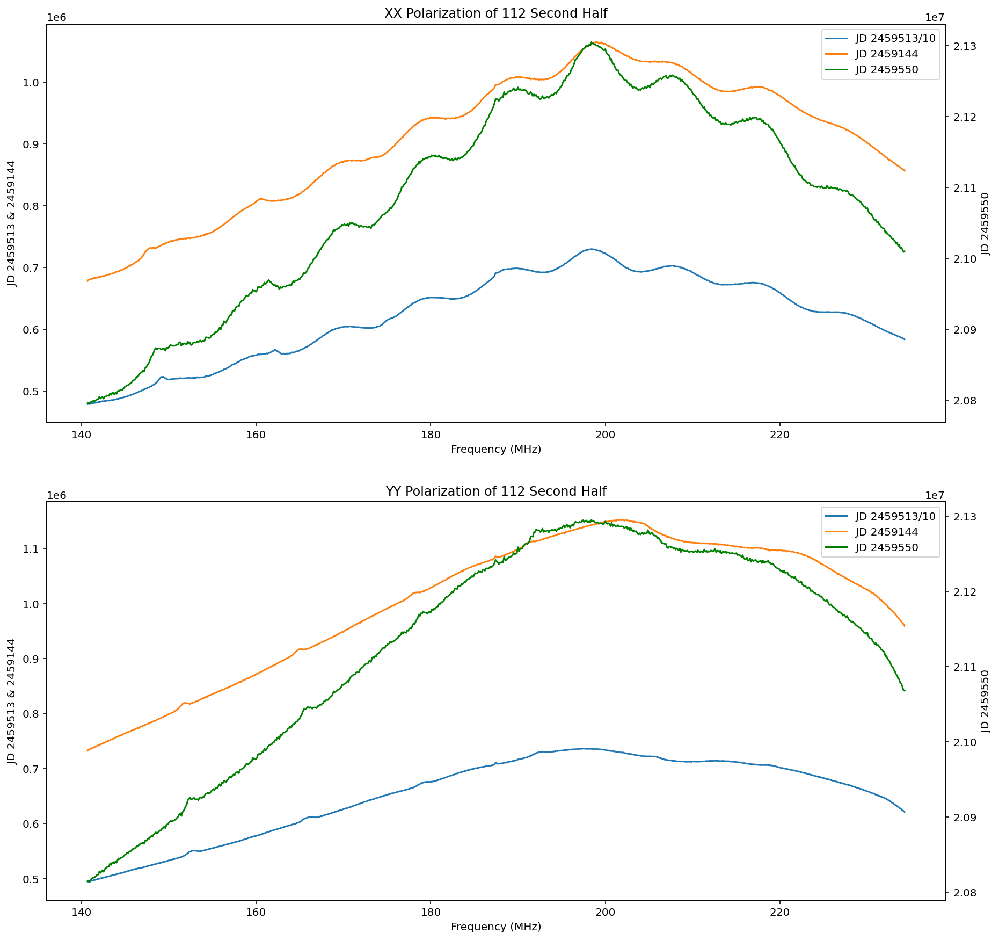

In [65]:
plot_same_fig_second_half(112)

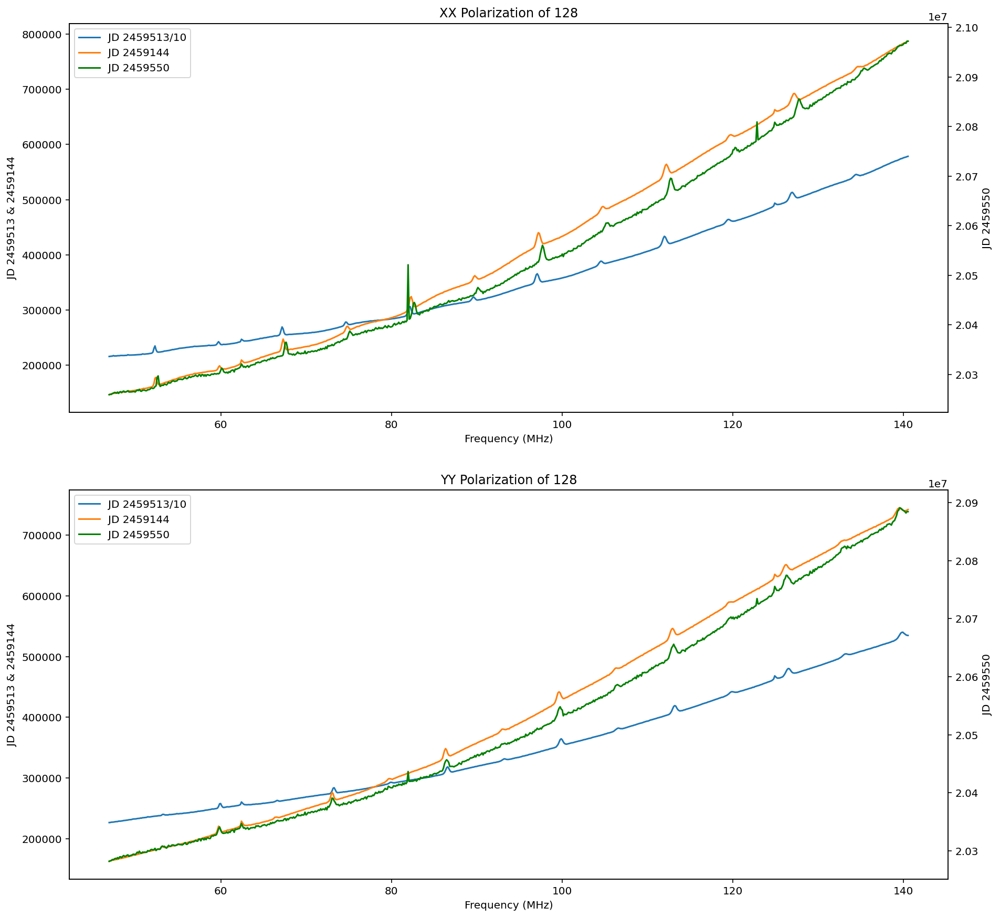

In [149]:
save_plt(128)

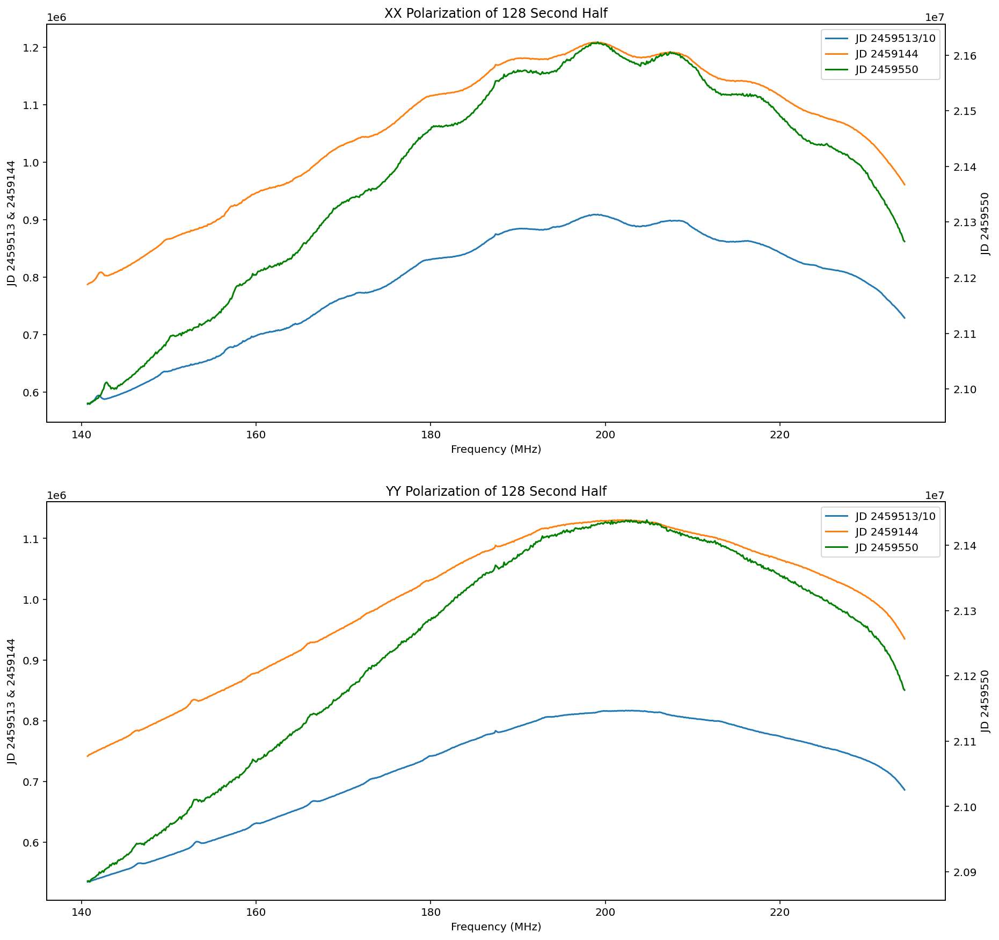

In [45]:
plot_same_fig_second_half(128)

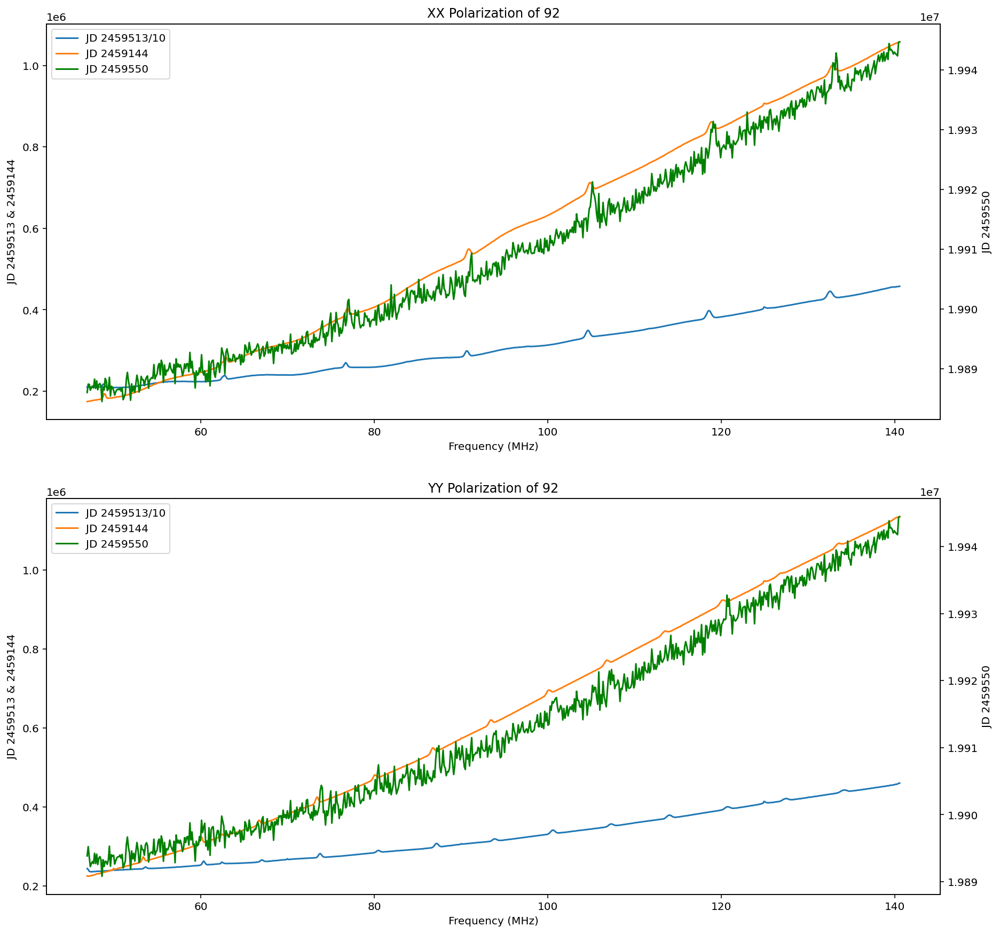

In [150]:
save_plt(92)

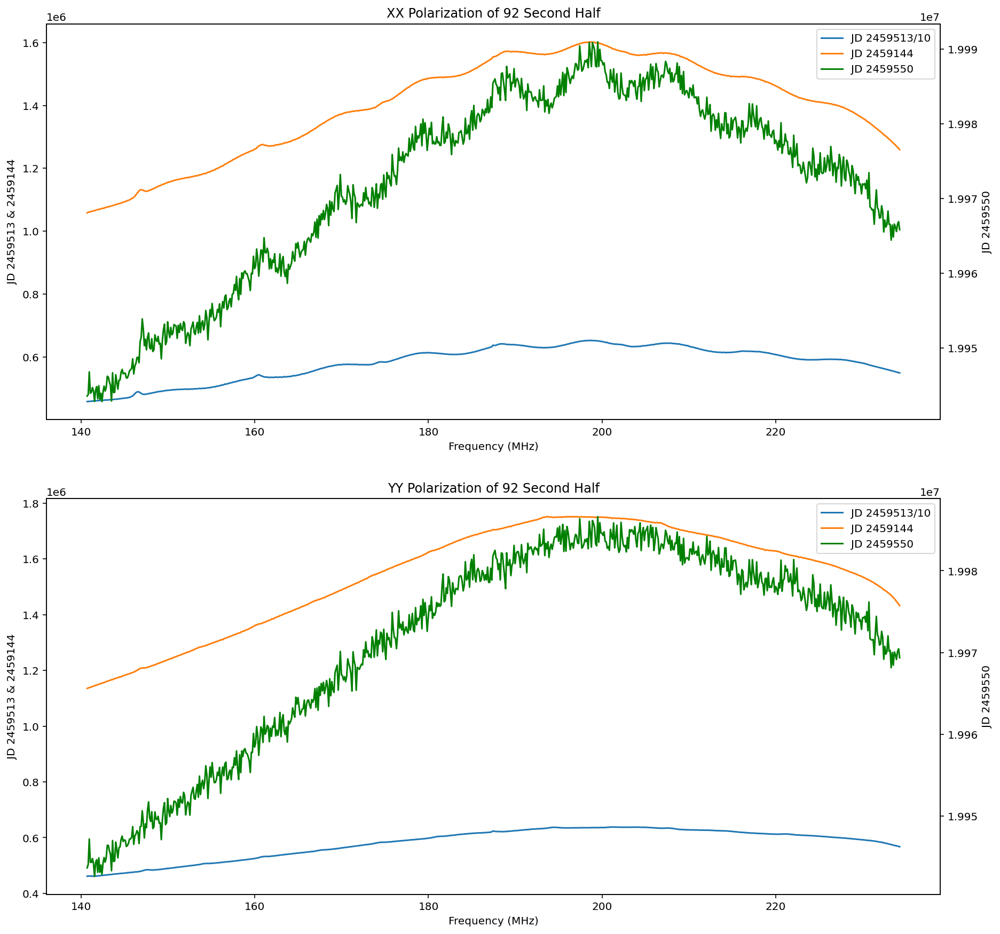

In [46]:
plot_same_fig_second_half(92)

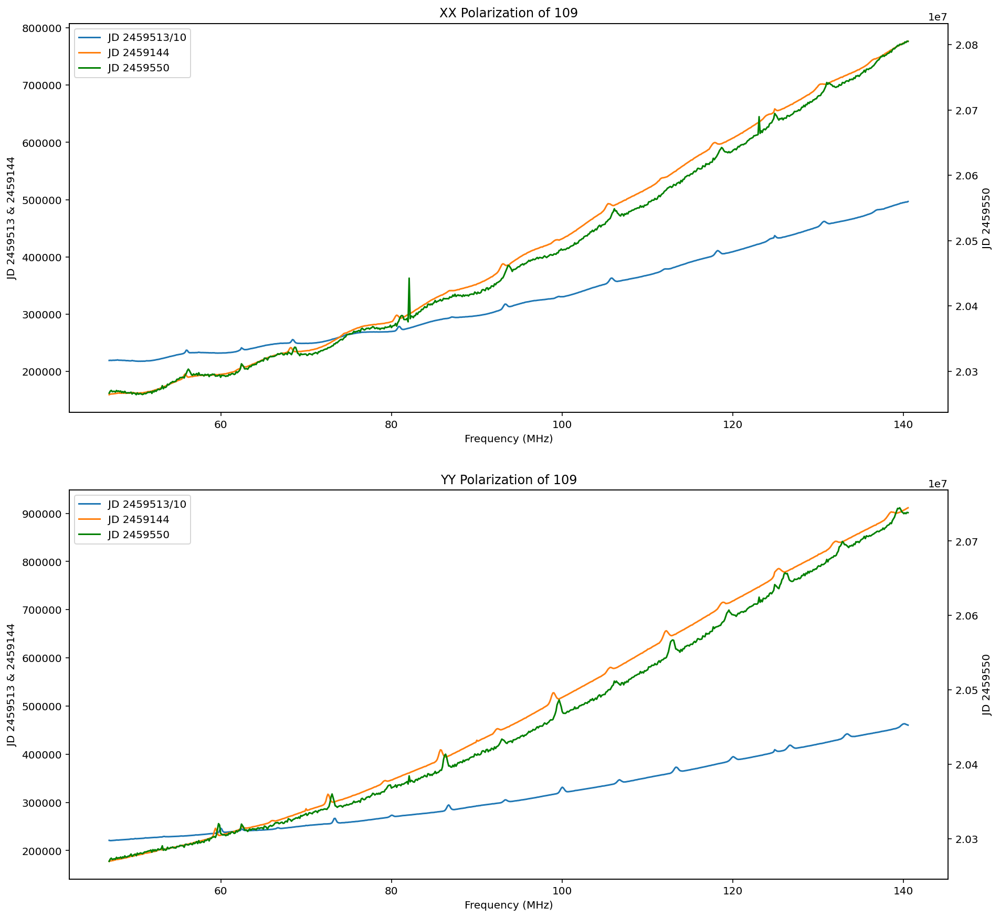

In [151]:
save_plt(109)

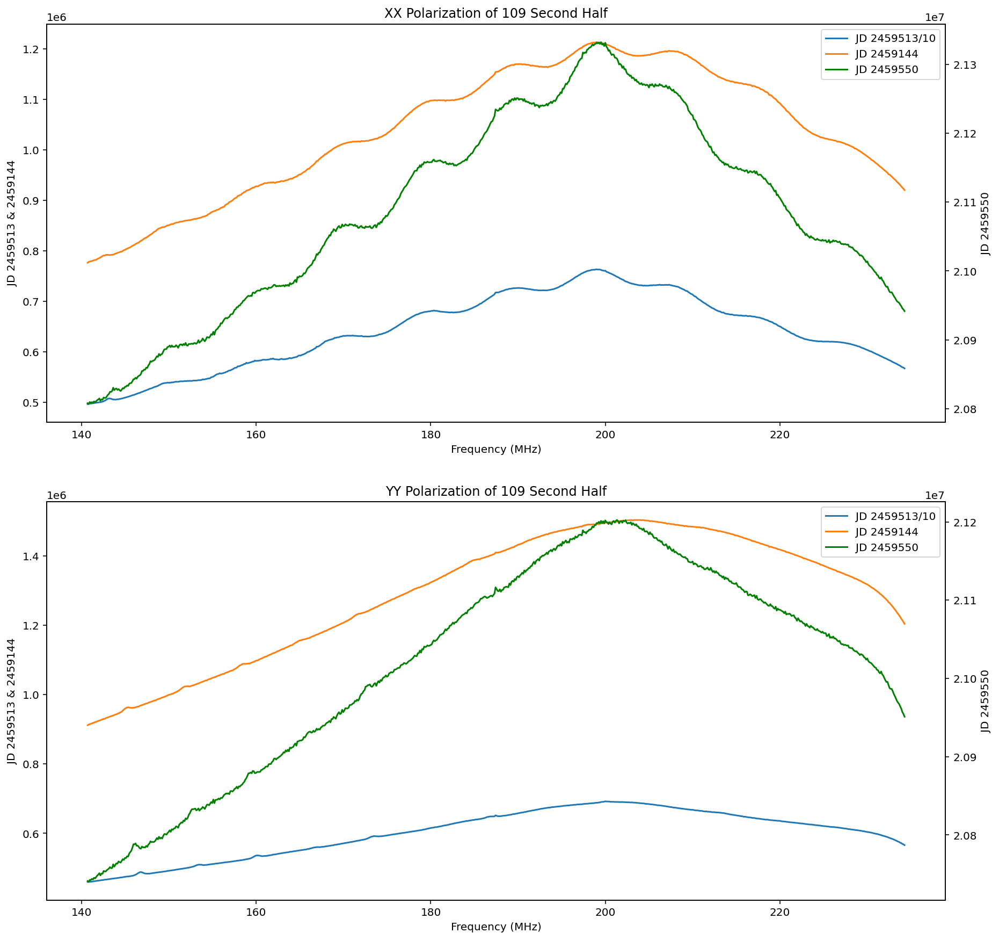

In [47]:
plot_same_fig_second_half(109)

# Node 12

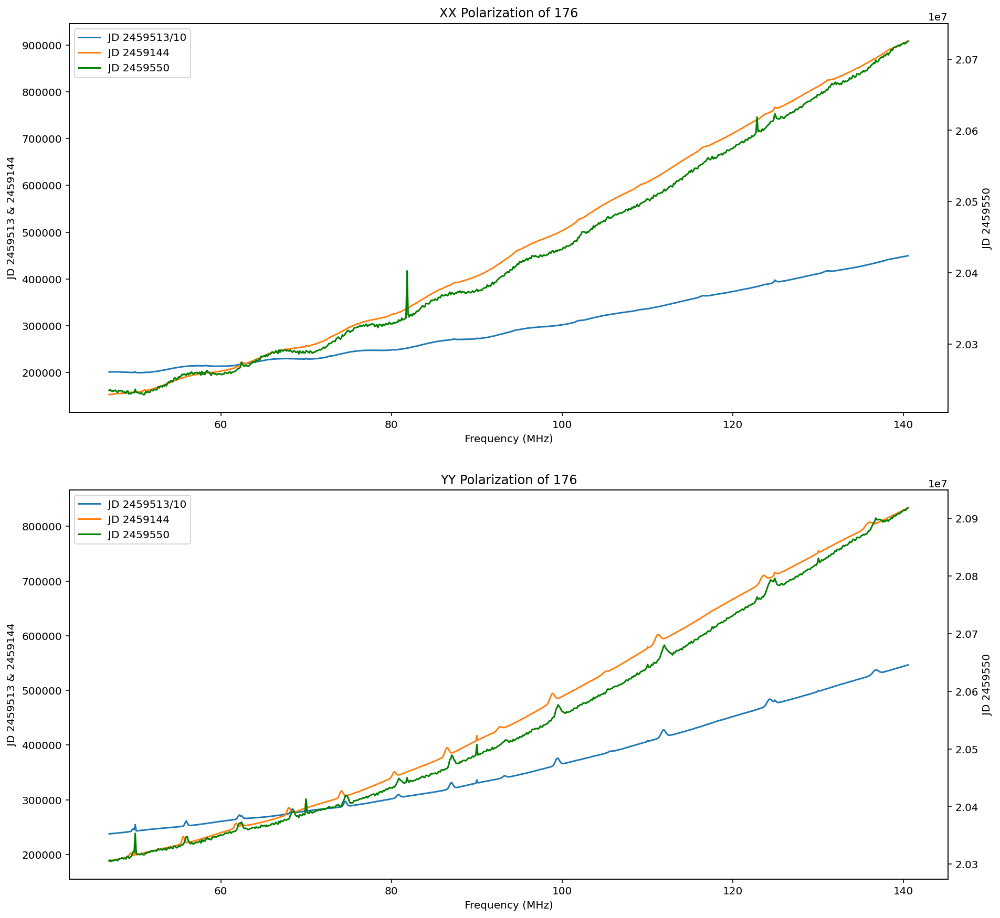

In [152]:
save_plt(176)

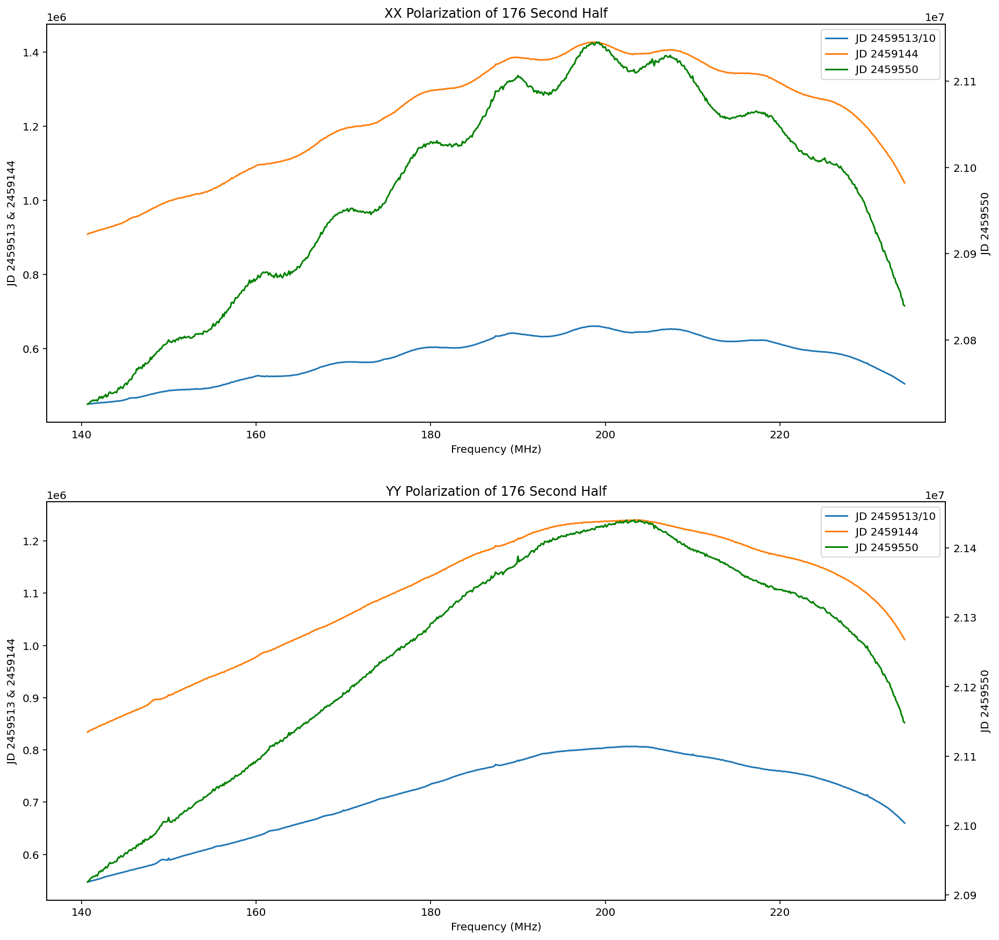

In [68]:
plot_same_fig_second_half(176)

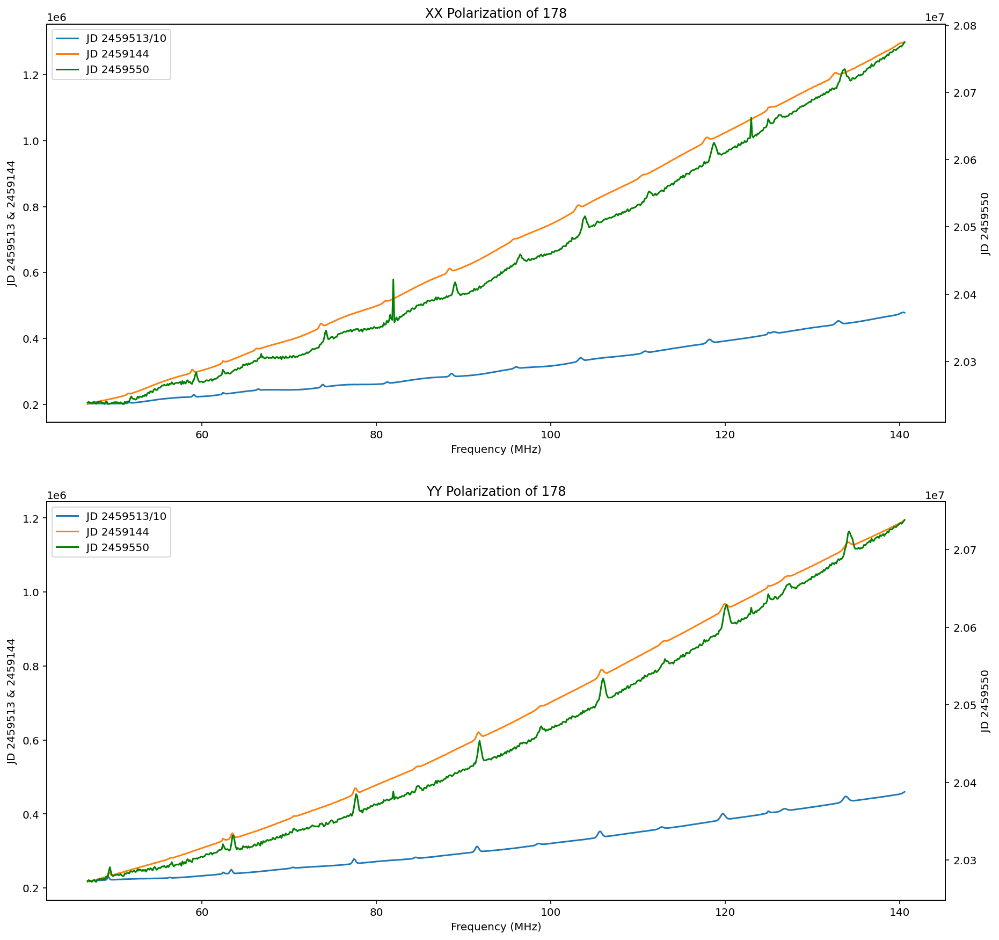

In [153]:
save_plt(178)

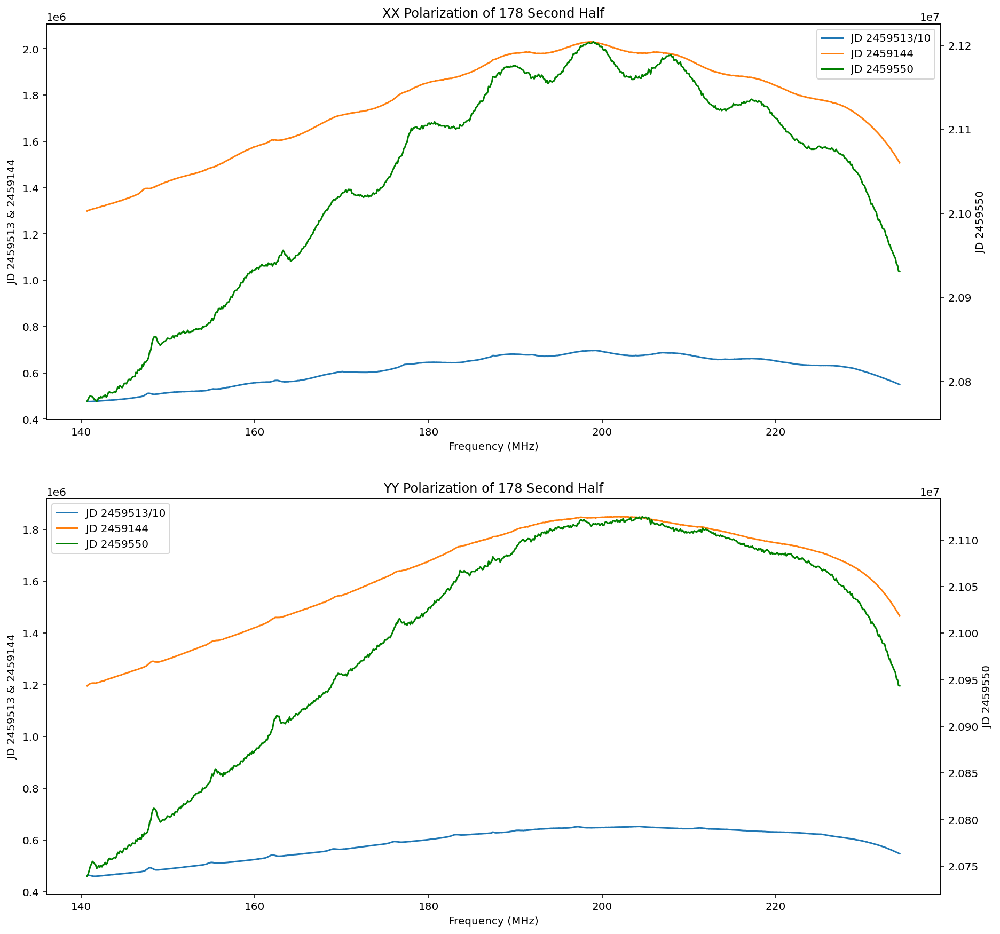

In [69]:
plot_same_fig_second_half(178)

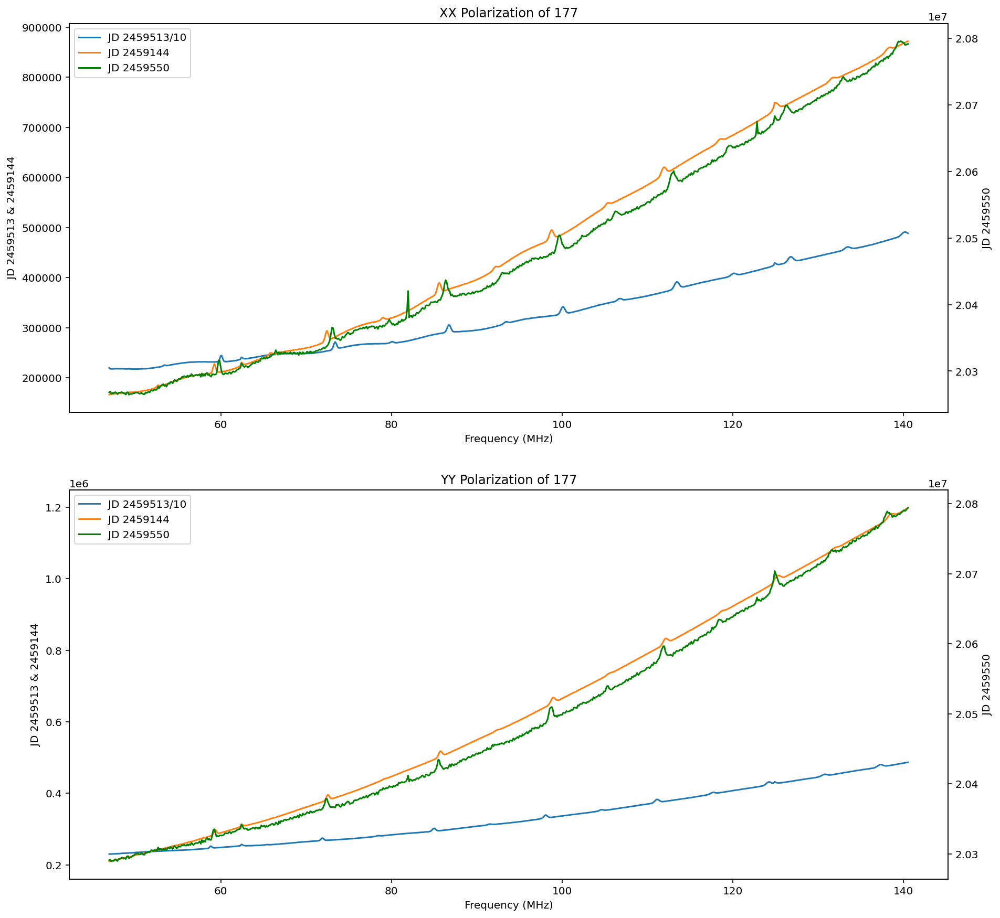

In [154]:
save_plt(177)

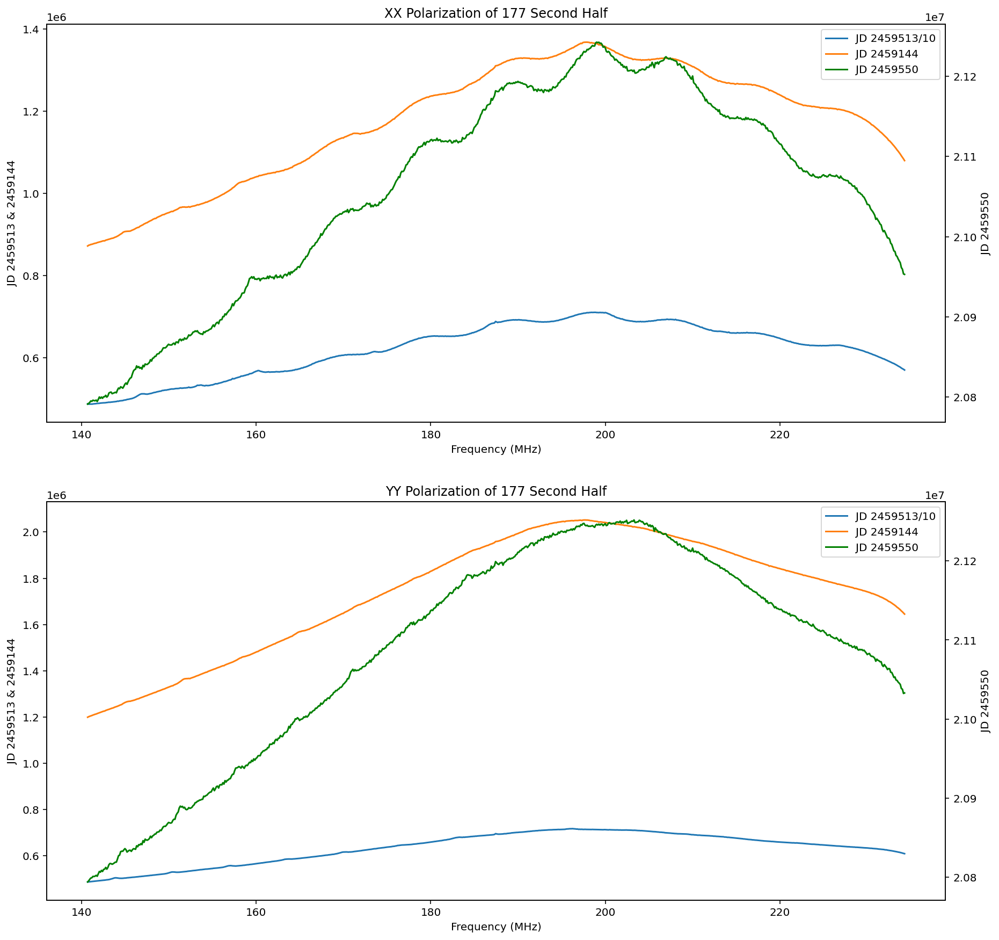

In [70]:
plot_same_fig_second_half(177)

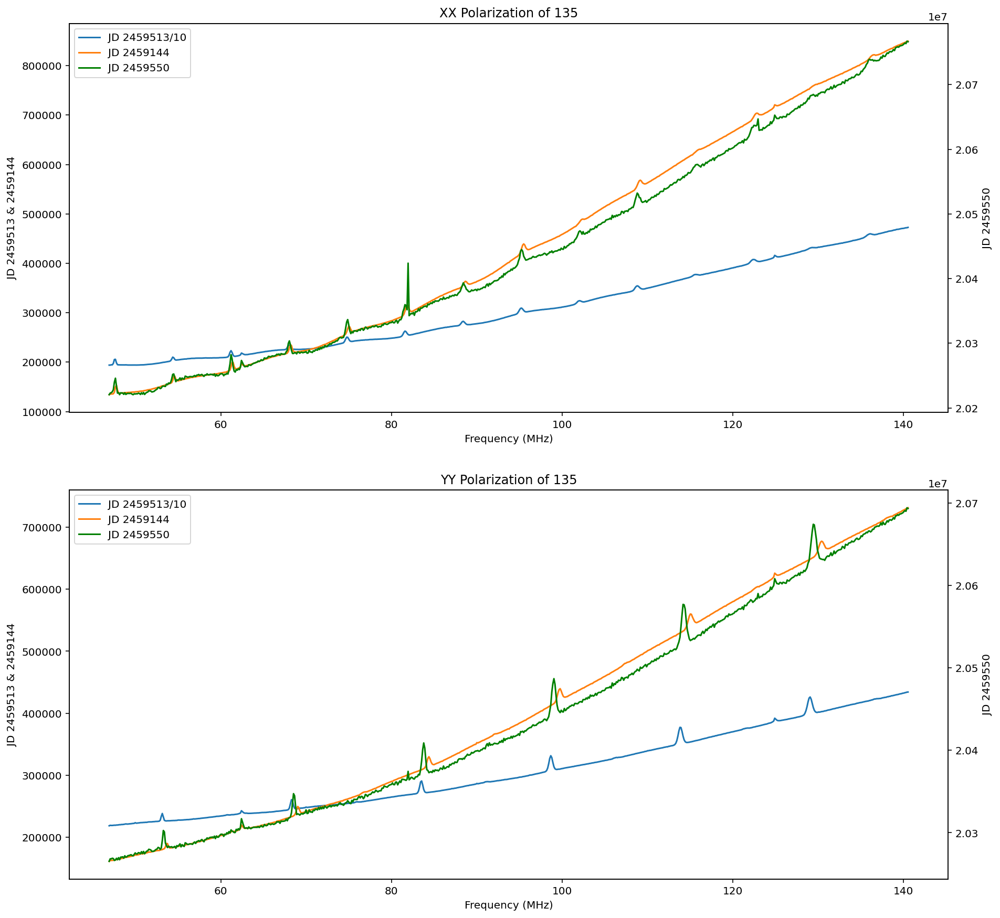

In [155]:
save_plt(135)

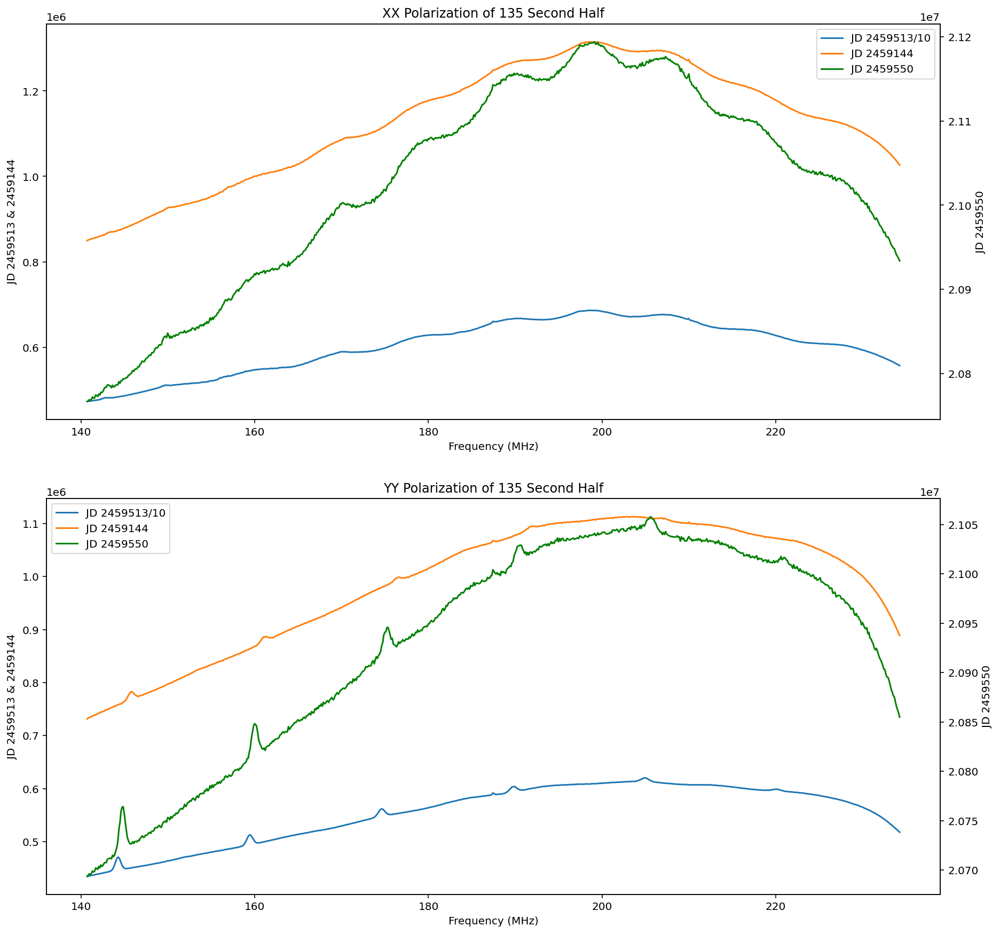

In [71]:
plot_same_fig_second_half(135)

# Node 14

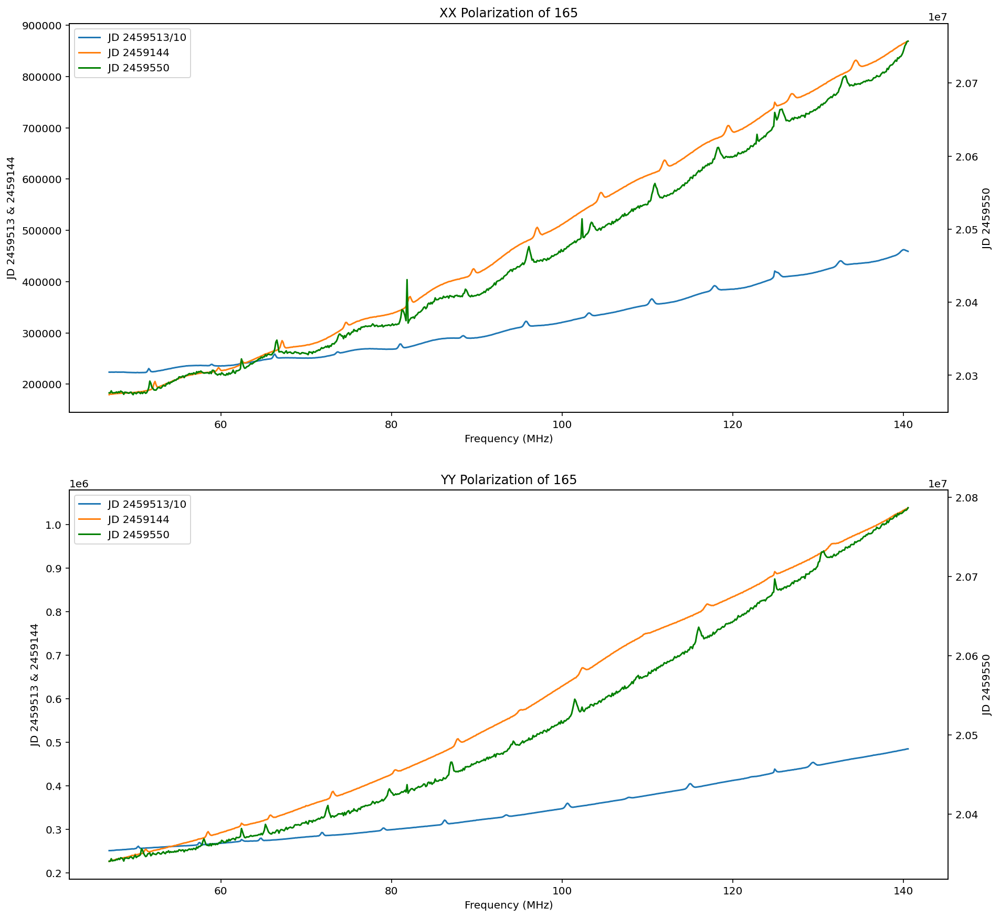

In [156]:
save_plt(165)

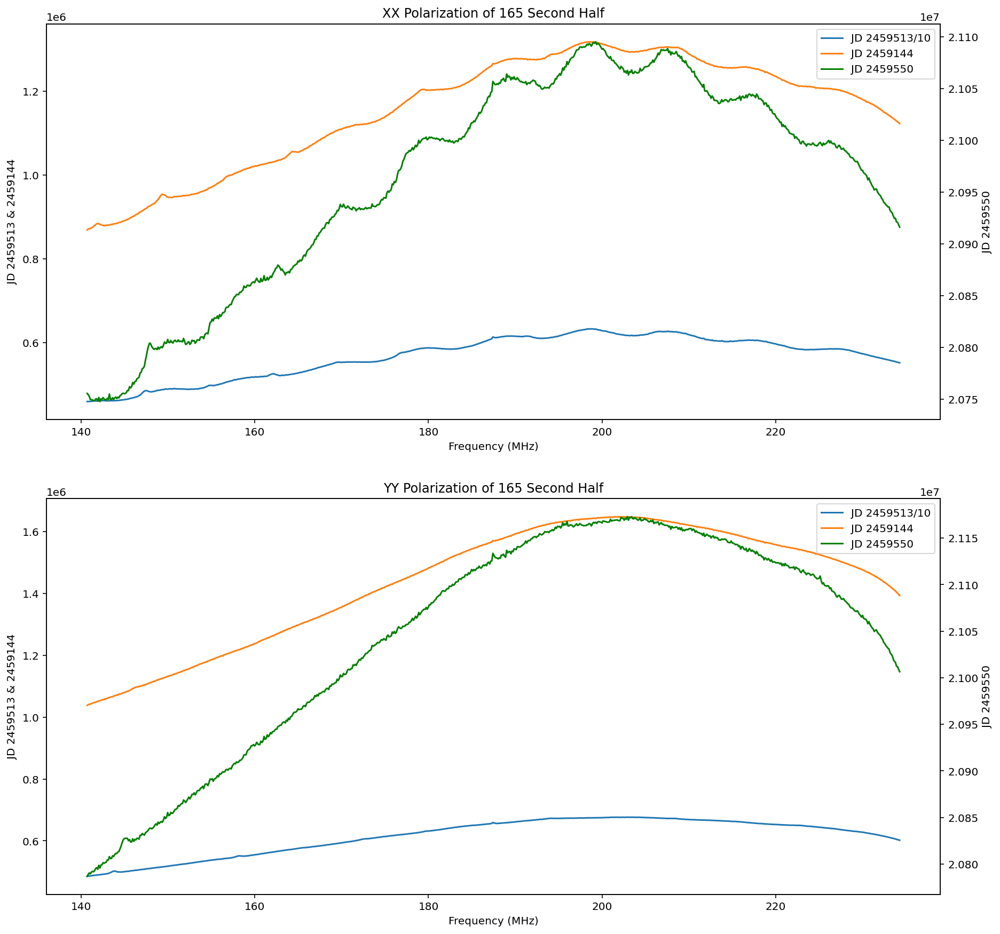

In [72]:
plot_same_fig_second_half(165)

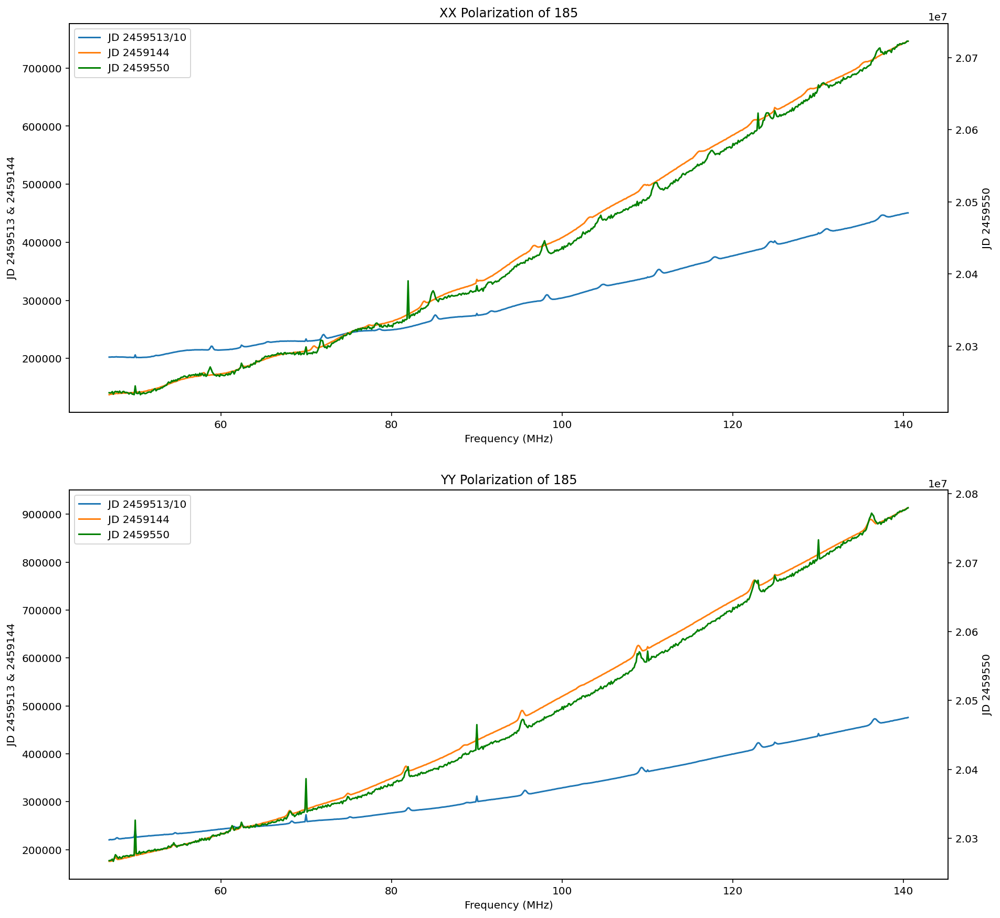

In [157]:
save_plt(185)

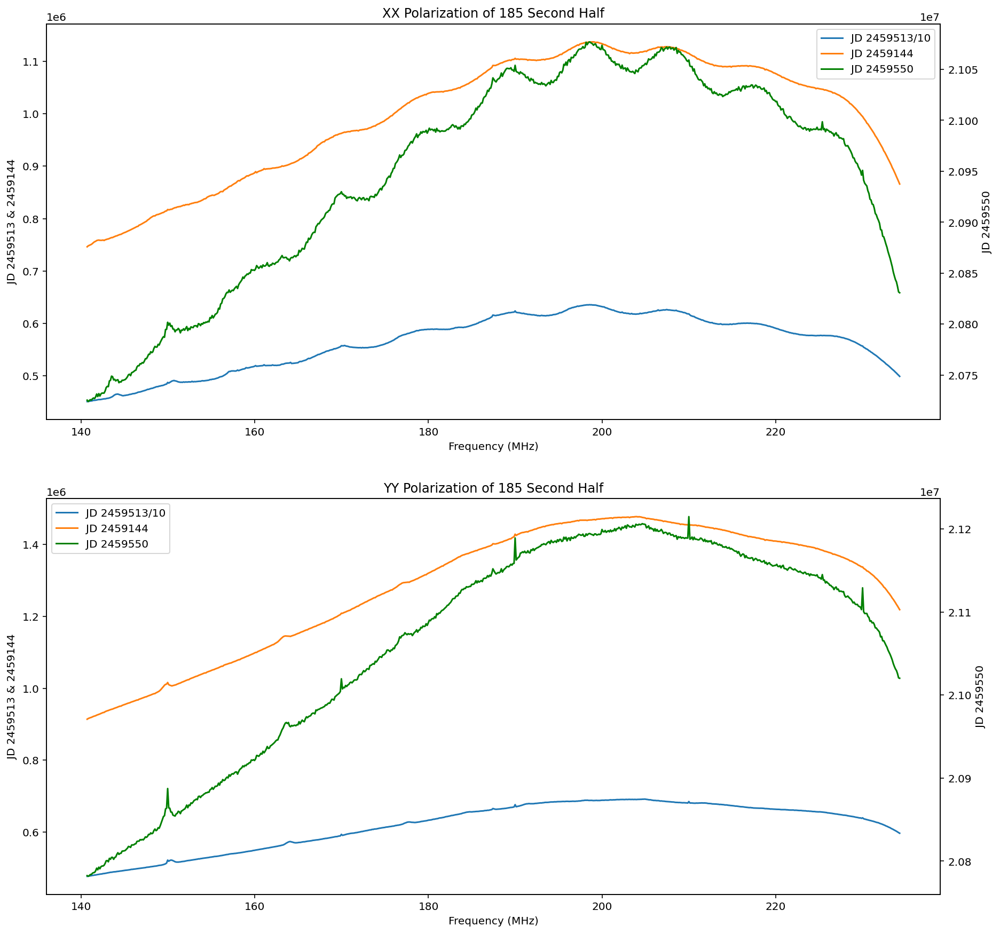

In [73]:
plot_same_fig_second_half(185)

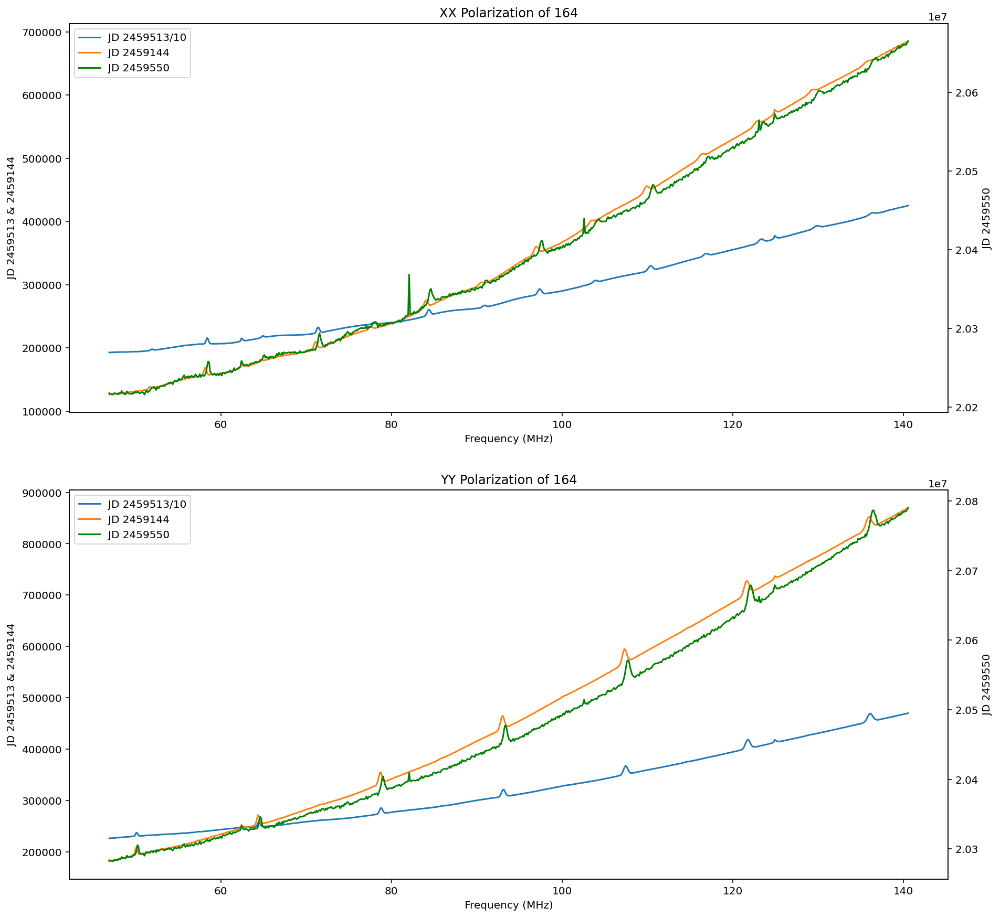

In [158]:
save_plt(164)

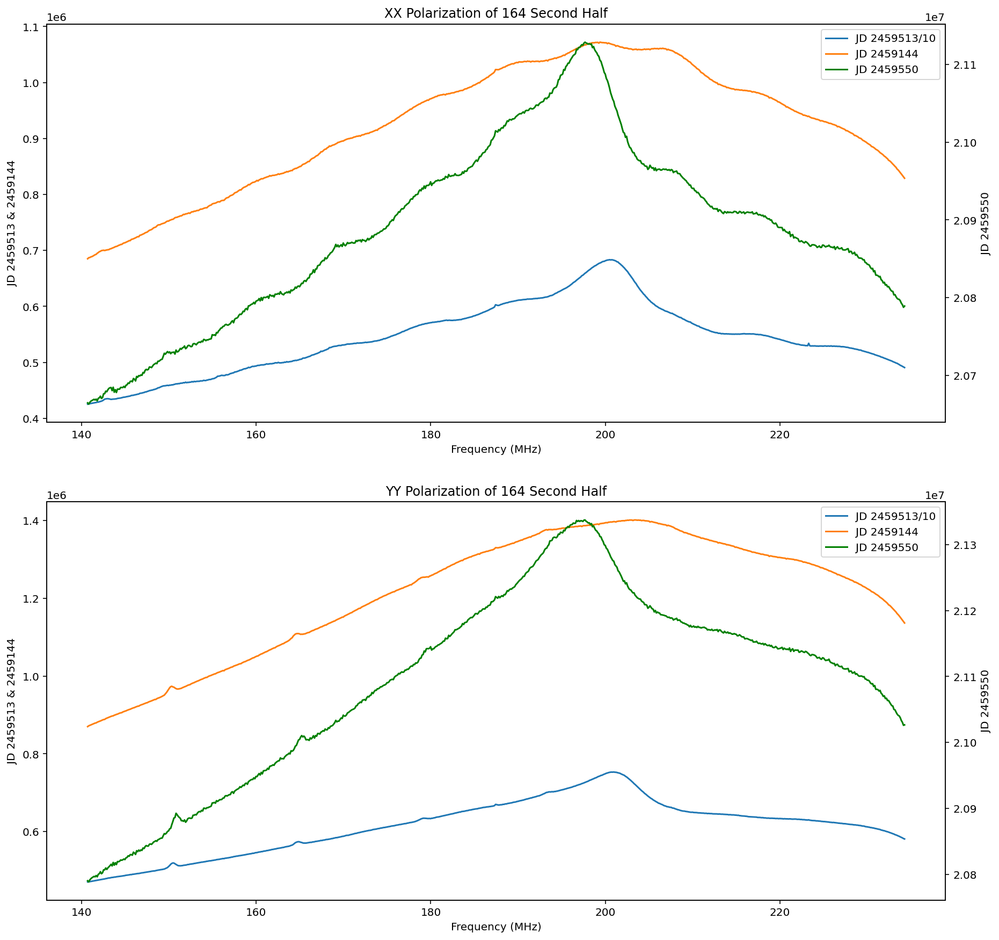

In [74]:
plot_same_fig_second_half(164)

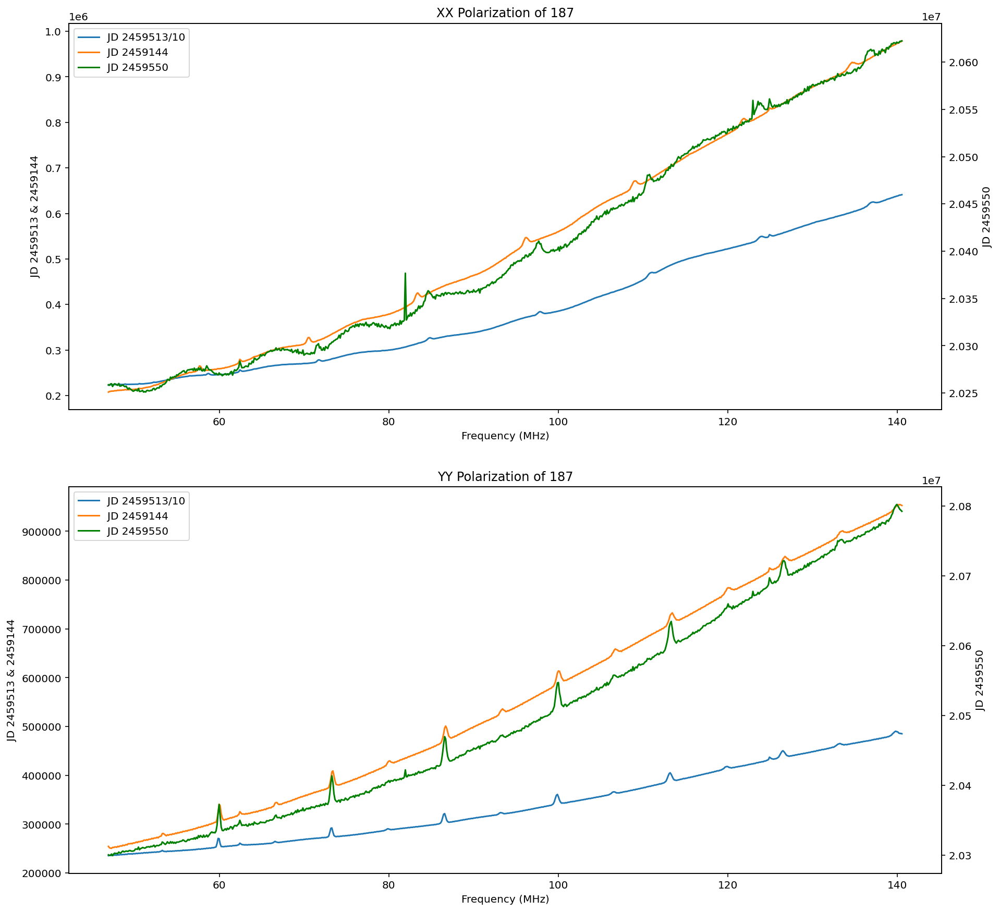

In [159]:
save_plt(187)

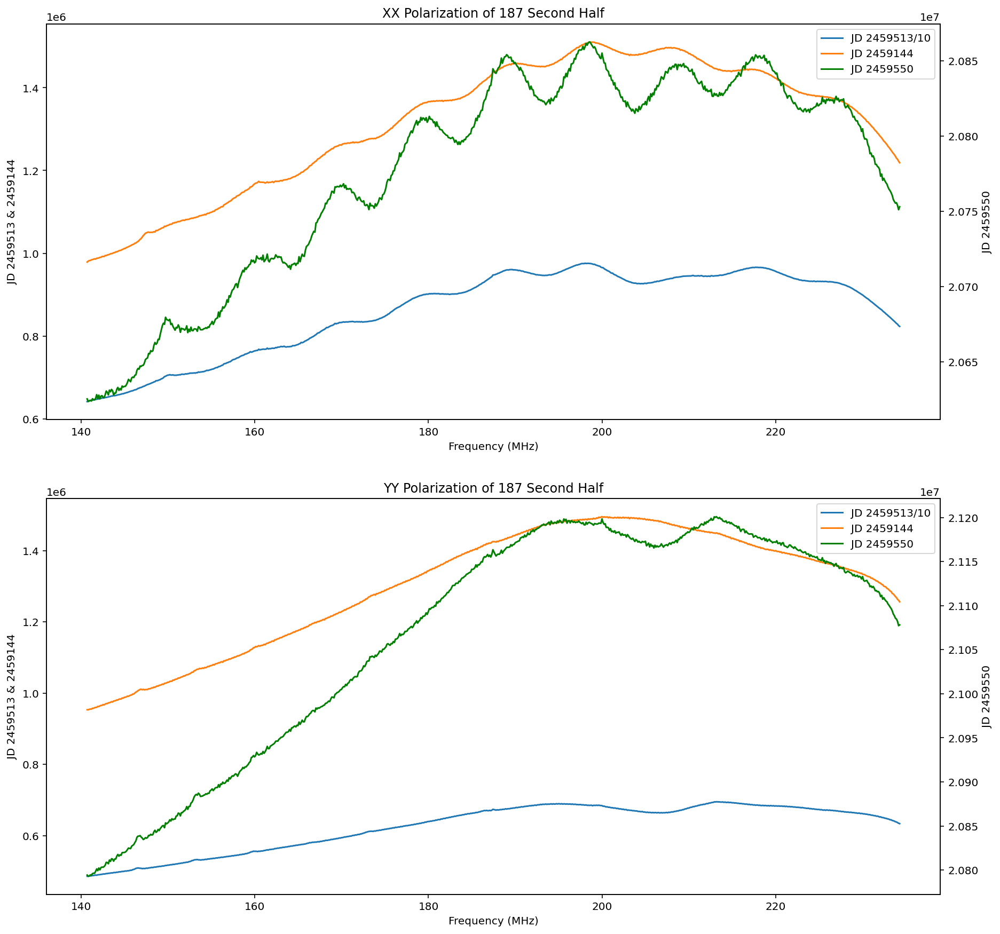

In [75]:
plot_same_fig_second_half(187)

# Node 15

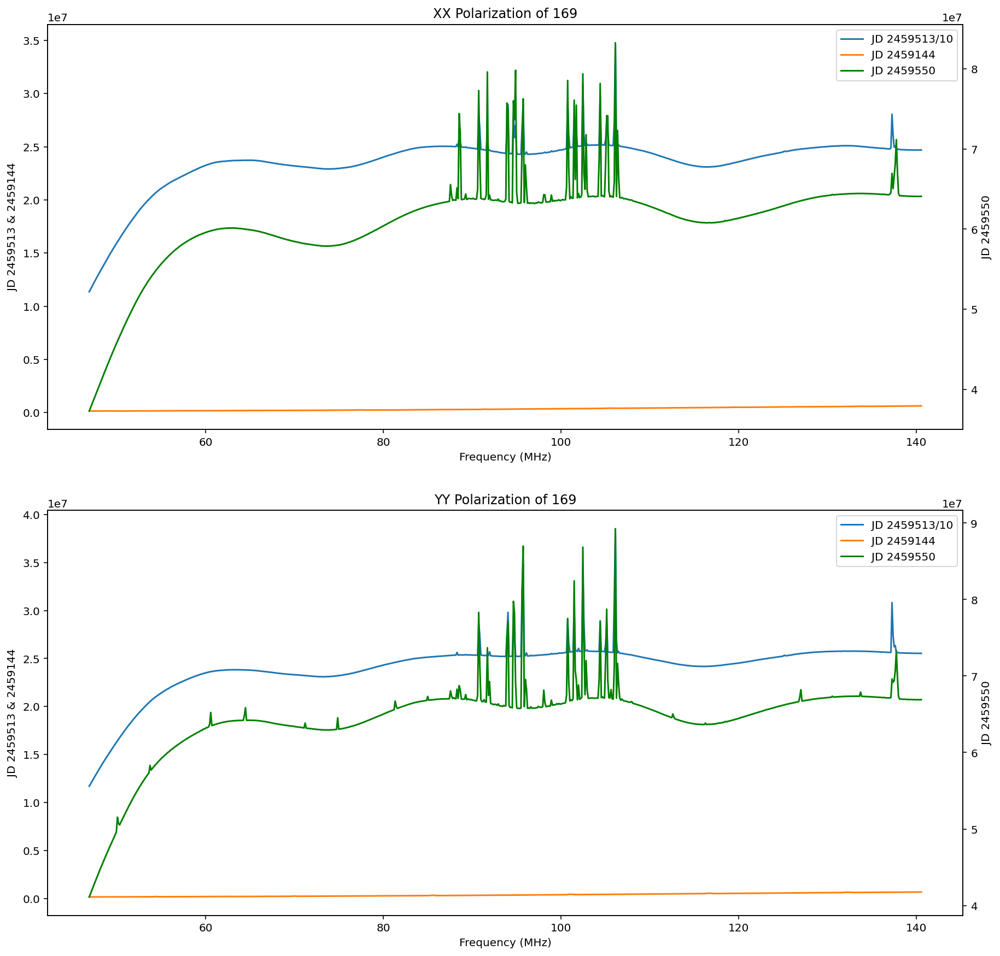

In [160]:
save_plt(169)

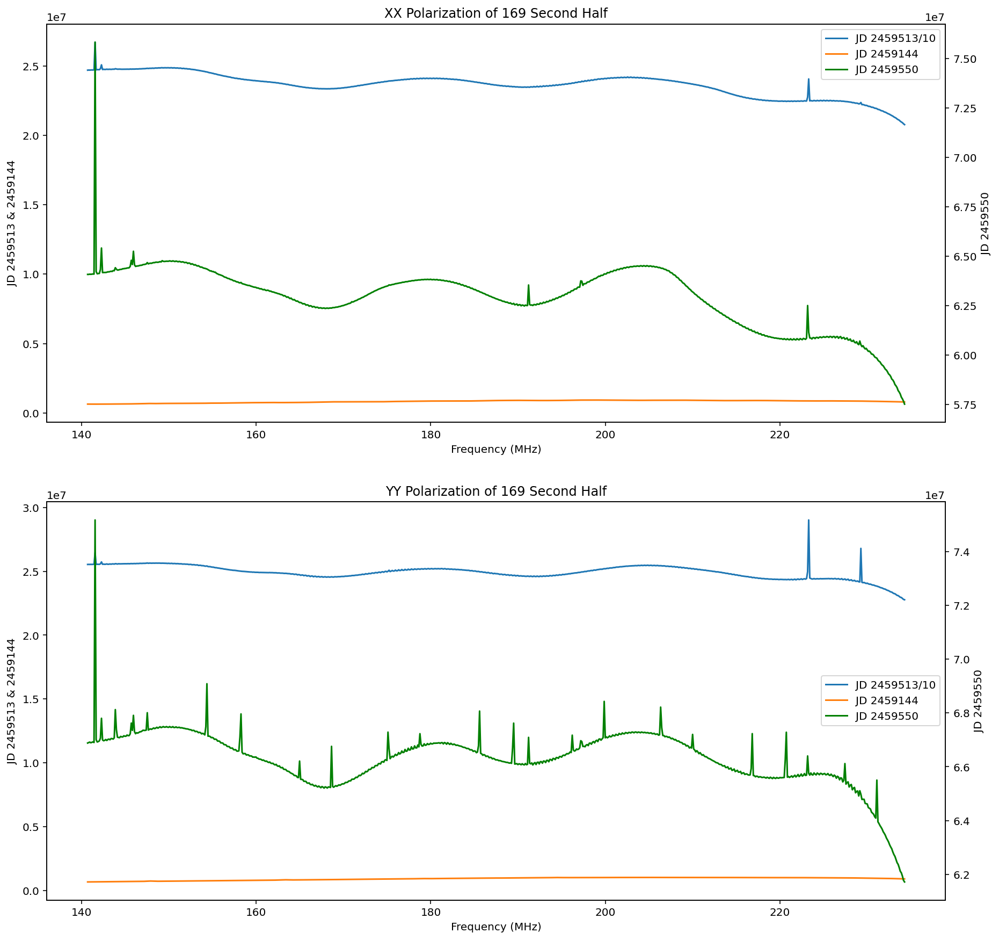

In [76]:
plot_same_fig_second_half(169)

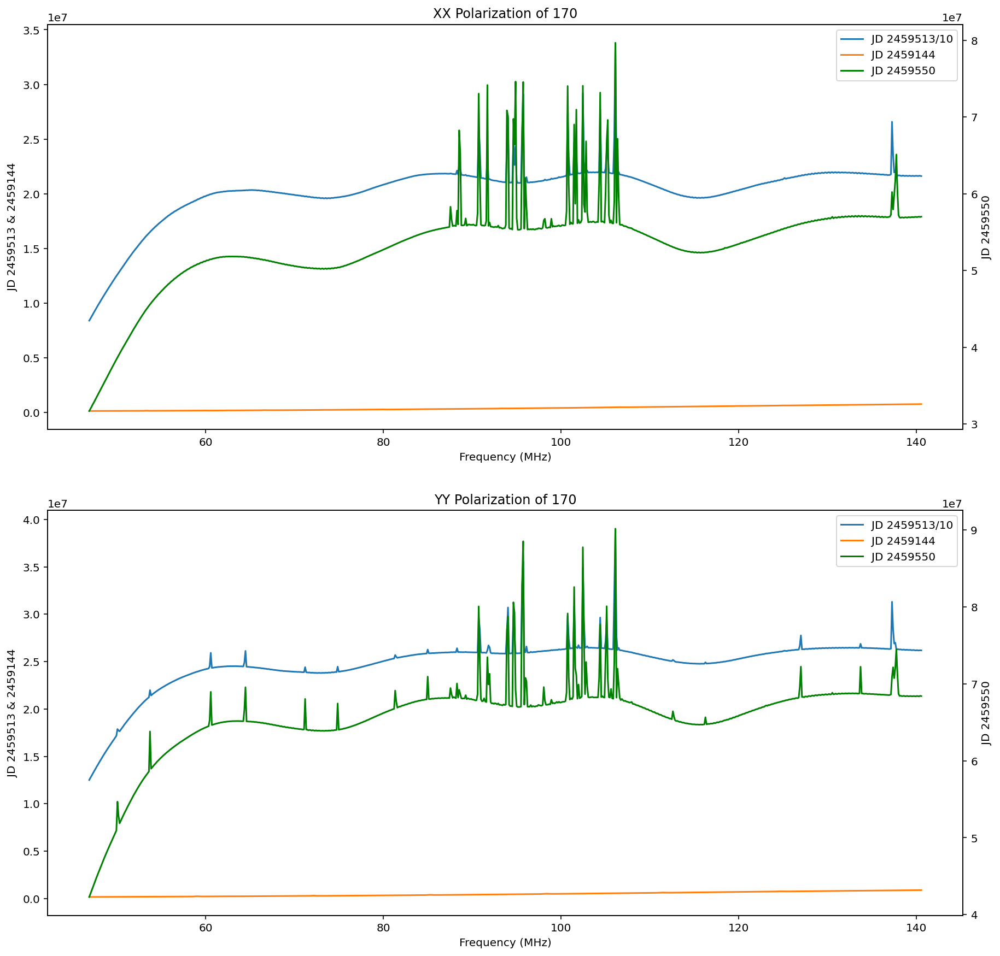

In [161]:
save_plt(170)

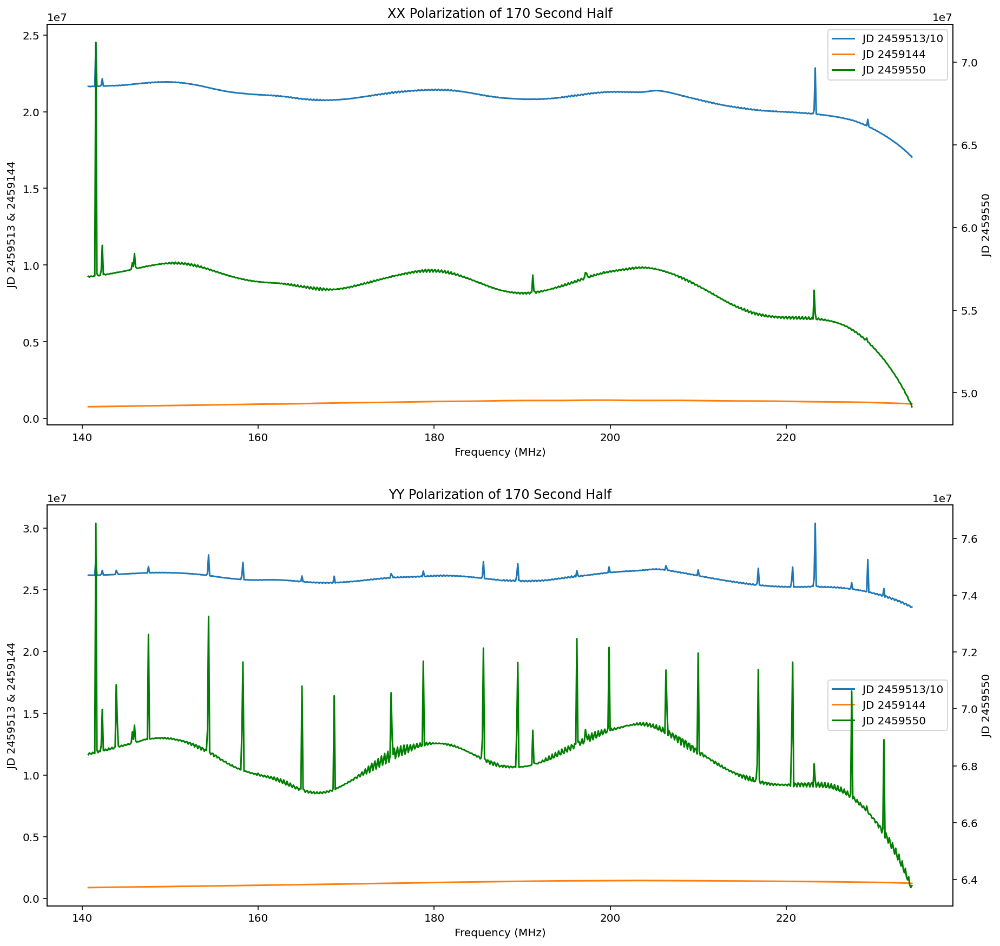

In [77]:
plot_same_fig_second_half(170)

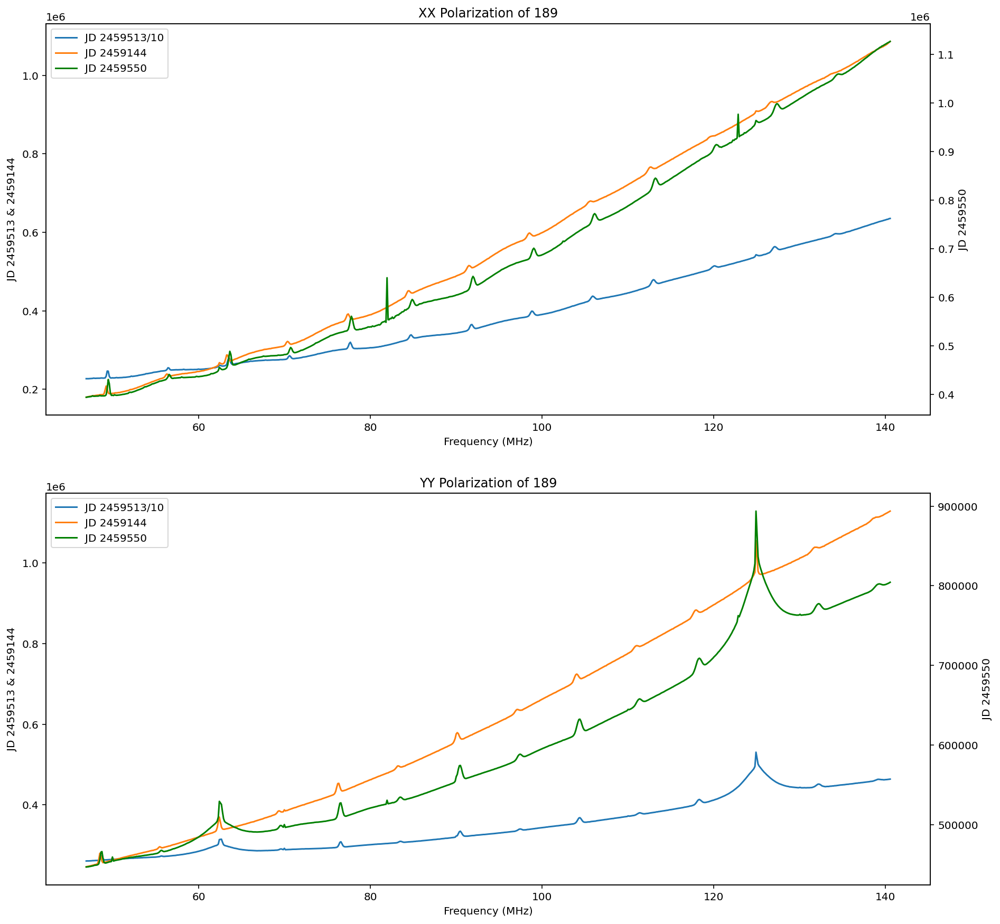

In [162]:
save_plt(189)

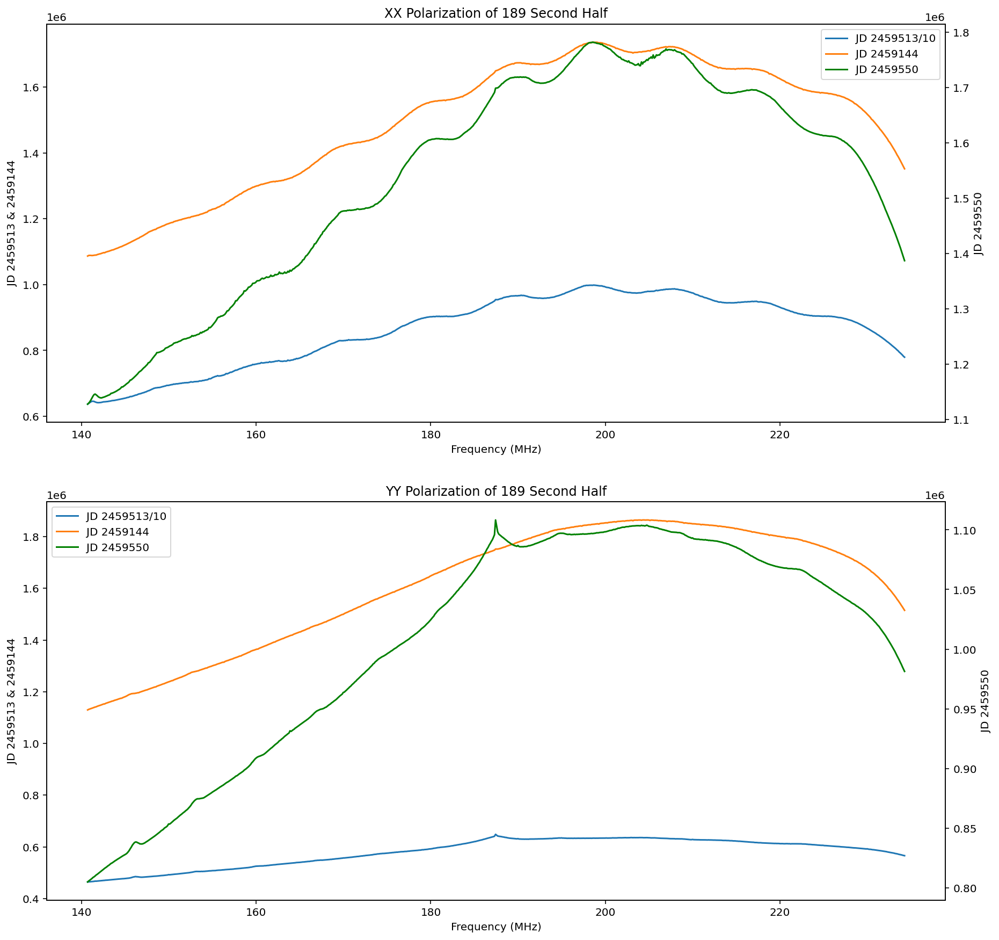

In [78]:
plot_same_fig_second_half(189)

# Experimental Plots

In [ ]:
plot_four_noclocks_even_single